In [22]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for our testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28), nrow=5, show=True):
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    if show:
        plt.show()

In [42]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        input_dim: the dimension of the input vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, input_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.input_dim = input_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(input_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor, 
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, input_dim)
        '''
        x = noise.view(len(noise), self.input_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, input_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, input_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
        n_samples: the number of samples to generate, a scalar
        input_dim: the dimension of the input vector, a scalar
        device: the device type
    '''
    return torch.randn(n_samples, input_dim, device=device)

In [43]:
class Discriminator(nn.Module):

    def __init__(self,im_chan=1,hidden_dim=64):
        super(Discriminator,self).__init__()
        self.disc = nn.Sequential(
            self.make_disc_block(im_chan,hidden_dim),
            self.make_disc_block(hidden_dim,hidden_dim*2),
            self.make_disc_block(hidden_dim*2,1,final_layer=True),
        )

    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels,output_channels,kernel_size,stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2,inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels,output_channels,kernel_size,stride),
            )
        
    def forward(self,image):
        disc_pred = self.disc(image)
        return disc_pred.view(len(disc_pred),-1)

In [44]:
import torch.nn.functional as F

def get_one_hot_labels(labels,n_classes):

    return F.one_hot(labels,n_classes)

In [45]:
def combine_vectors(x,y):
    combined = torch.cat((x.float(),y.float()),1)
    return combined

In [46]:
mnist_shape = (1,28,28)
n_classes = 10

In [47]:
criterion = nn.BCEWithLogitsLoss()
n_epochs = 200
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.0002
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,),(0.5,)),
])

dataloader = DataLoader(
    MNIST('.',download=True,transform=transform),
    batch_size=batch_size,
    shuffle=True)

In [48]:
def get_input_dimensions(z_dim,mnist_shape,n_classes):
    generator_input_dim = z_dim + n_classes
    discriminator_im_chan = mnist_shape[0] + n_classes
    return generator_input_dim,discriminator_im_chan

In [49]:
generator_input_dim,discriminator_im_chan = get_input_dimensions(z_dim,mnist_shape,n_classes)
gen = Generator(input_dim=generator_input_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(),lr=lr)
disc = Discriminator(im_chan=discriminator_im_chan).to(device)
disc_opt = torch.optim.Adam(disc.parameters(),lr=lr)

def weights_init(m):
    if isinstance(m,nn.Conv2d) or isinstance(m,nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight,0.0,0.02)
    if isinstance(m,nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight,0.0,0.02)
        torch.nn.init.constant_(m.bias,0)

  0%|          | 1/469 [00:02<19:16,  2.47s/it]

Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!


  6%|▌         | 28/469 [00:00<00:11, 39.58it/s]

Epoch 1, step 500: Generator loss: 2.1216817581057548, discriminator loss: 0.2744913389533758


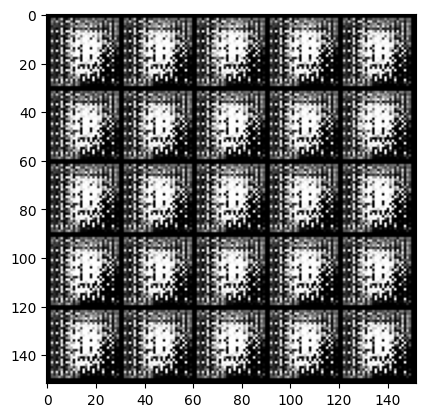

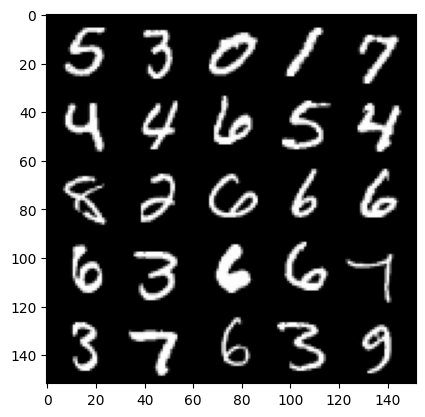

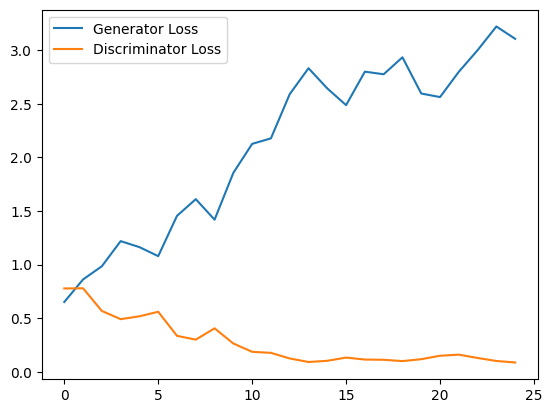

 13%|█▎        | 60/469 [00:01<00:12, 31.77it/s]

Epoch 2, step 1000: Generator loss: 4.019275150299072, discriminator loss: 0.04217001076228916


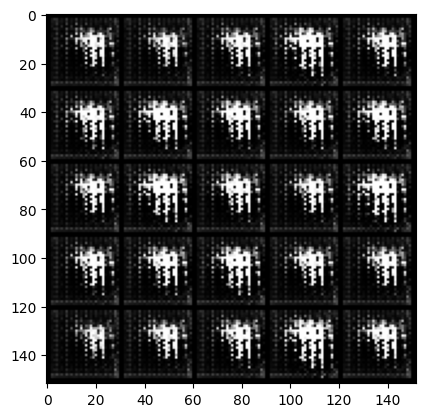

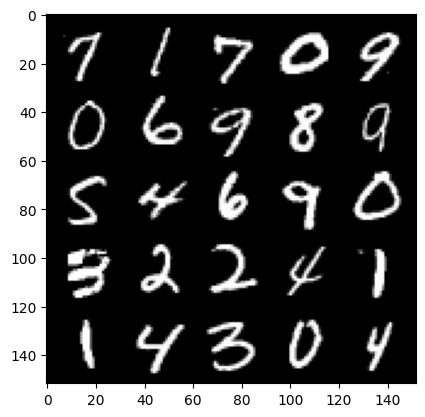

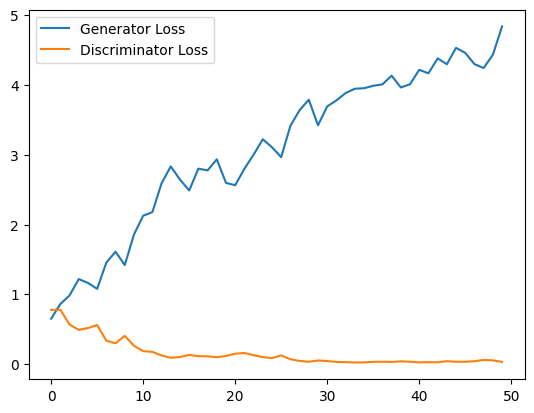

 20%|█▉        | 92/469 [00:02<00:12, 30.47it/s]

Epoch 3, step 1500: Generator loss: 4.629584174156189, discriminator loss: 0.02247217030264437


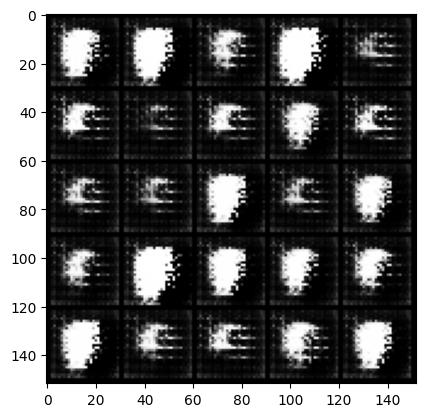

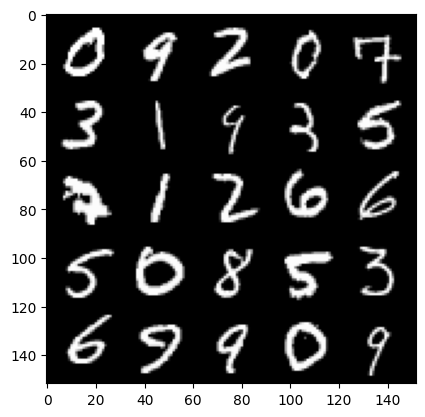

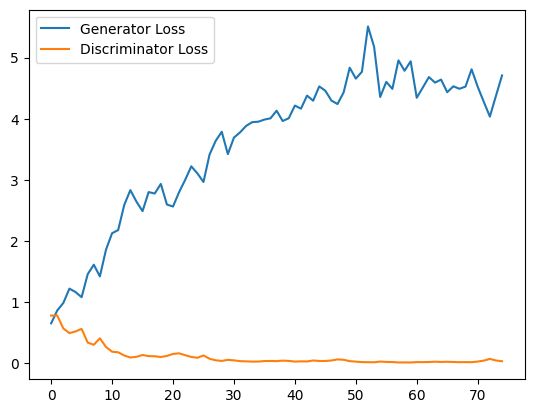

 26%|██▌       | 122/469 [00:03<00:09, 35.26it/s]

Epoch 4, step 2000: Generator loss: 4.439329217910767, discriminator loss: 0.06848595322016626


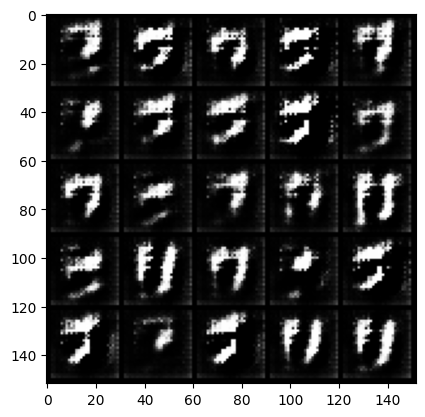

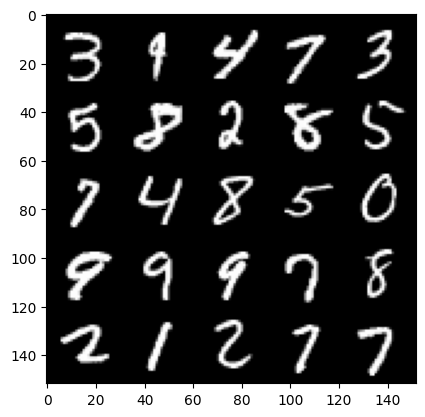

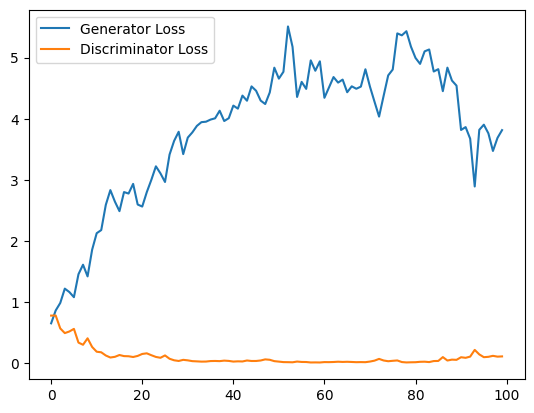

 33%|███▎      | 154/469 [00:04<00:09, 33.43it/s]

Epoch 5, step 2500: Generator loss: 3.749507691860199, discriminator loss: 0.12396787702664733


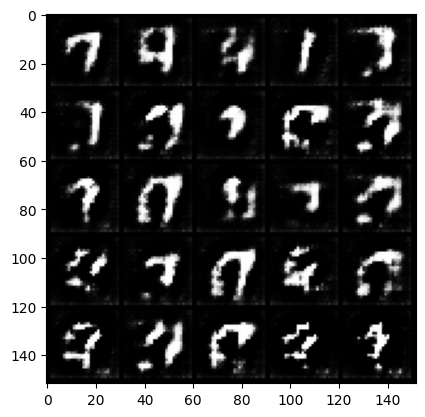

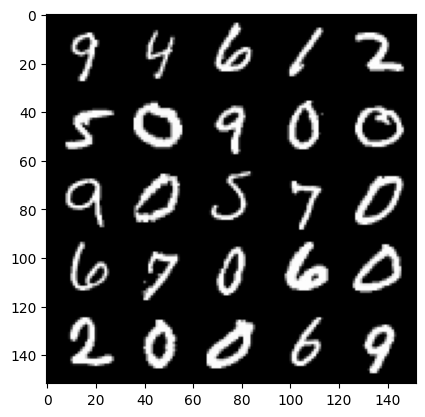

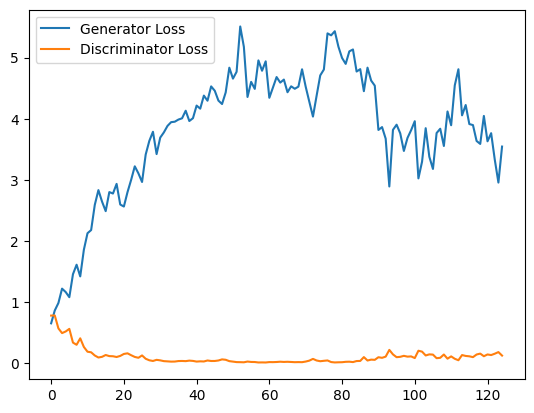

 39%|███▉      | 184/469 [00:06<00:09, 28.56it/s]

Epoch 6, step 3000: Generator loss: 3.1871696600914, discriminator loss: 0.19565368357300758


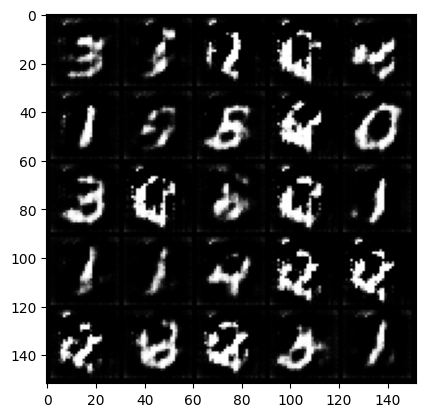

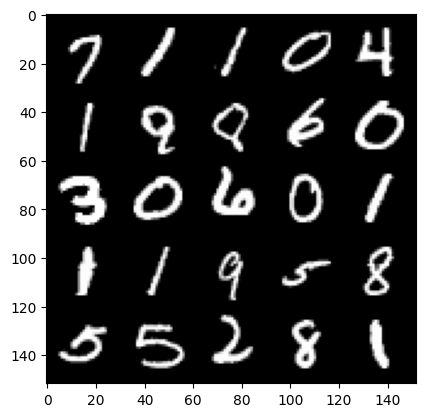

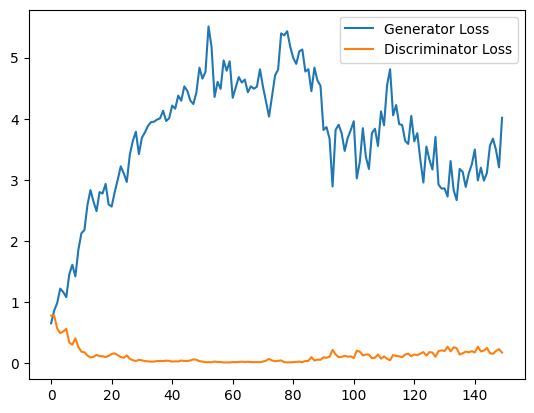

 46%|████▌     | 215/469 [00:07<00:09, 27.99it/s]

Epoch 7, step 3500: Generator loss: 2.5001008999347687, discriminator loss: 0.28709145277738574


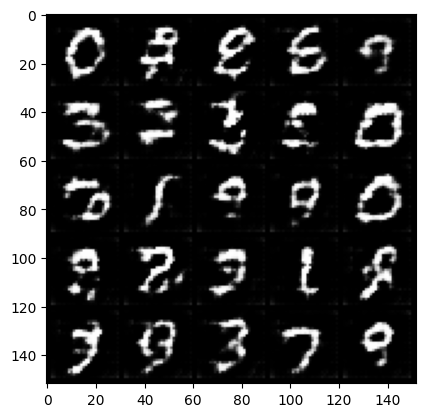

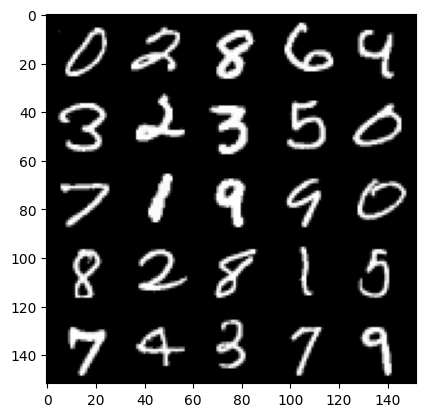

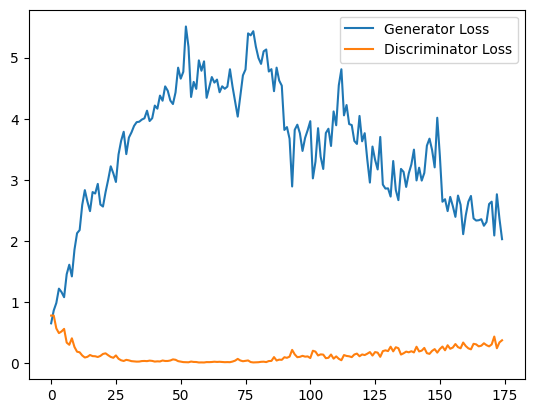

 53%|█████▎    | 247/469 [00:07<00:07, 31.34it/s]

Epoch 8, step 4000: Generator loss: 2.327132201433182, discriminator loss: 0.3288935268372297


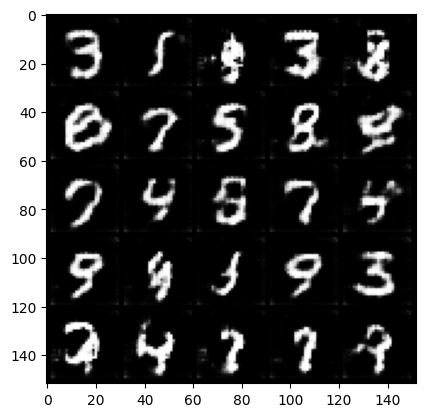

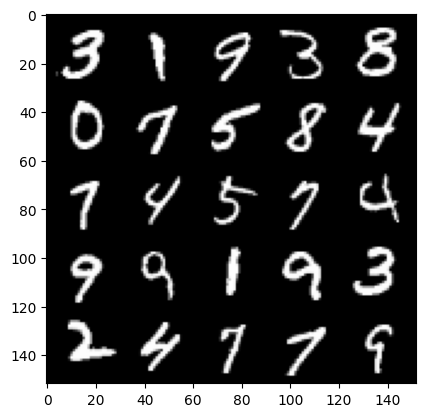

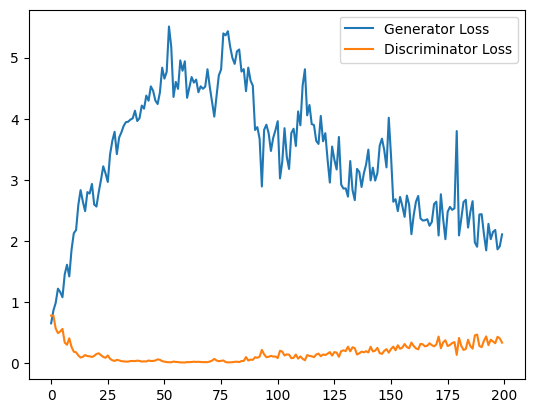

 59%|█████▉    | 277/469 [00:10<00:06, 31.07it/s]

Epoch 9, step 4500: Generator loss: 2.0090748114585875, discriminator loss: 0.36004438129067423


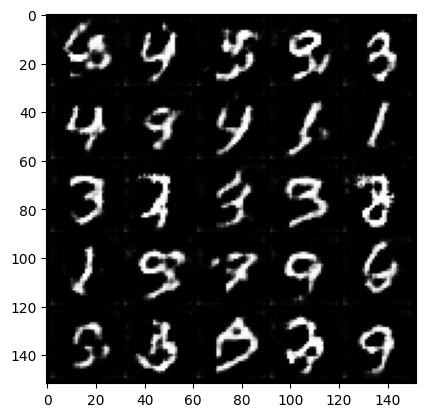

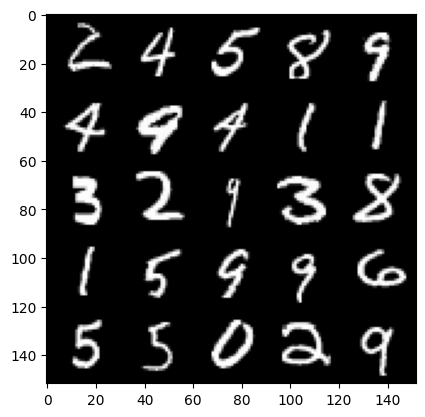

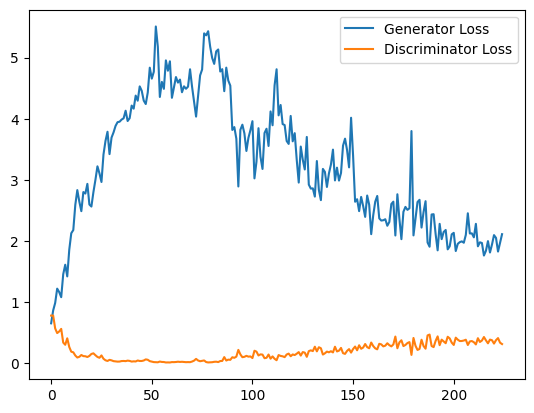

 66%|██████▌   | 308/469 [00:11<00:05, 28.95it/s]

Epoch 10, step 5000: Generator loss: 1.838249383211136, discriminator loss: 0.38693748065829275


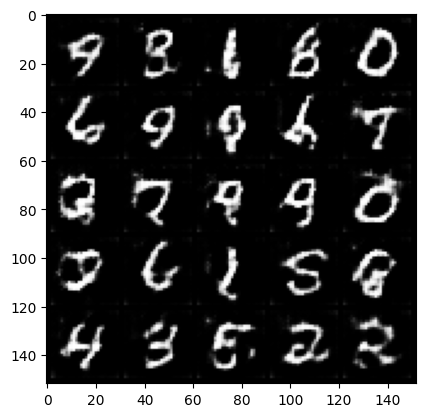

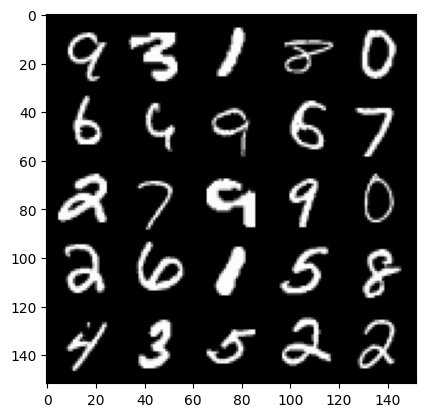

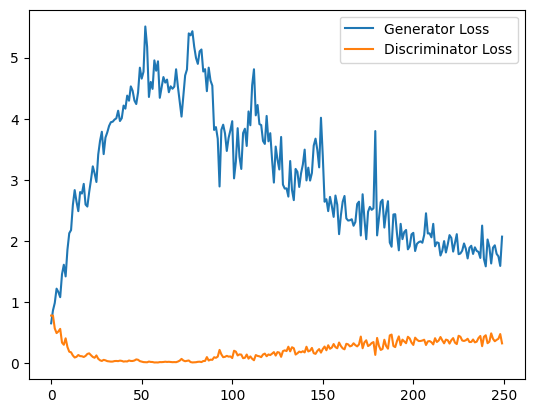

 73%|███████▎  | 341/469 [00:13<00:04, 29.01it/s]

Epoch 11, step 5500: Generator loss: 1.814026335477829, discriminator loss: 0.42018950203061106


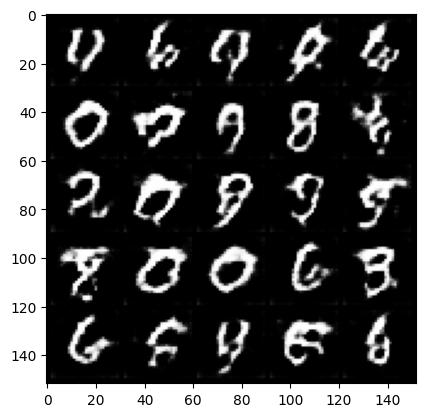

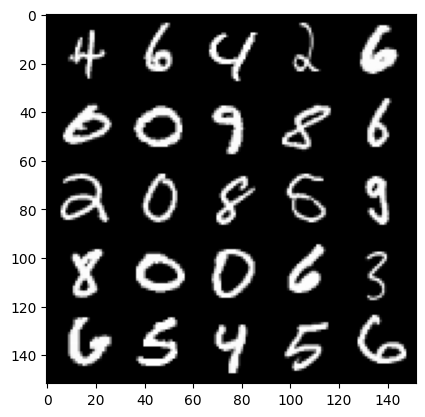

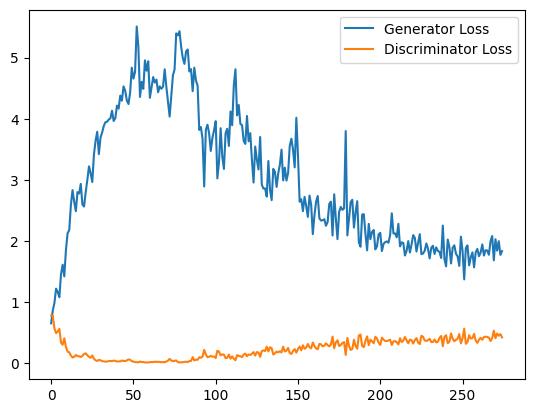

 79%|███████▉  | 372/469 [00:13<00:02, 33.76it/s]

Epoch 12, step 6000: Generator loss: 1.643763249874115, discriminator loss: 0.4425462533831596


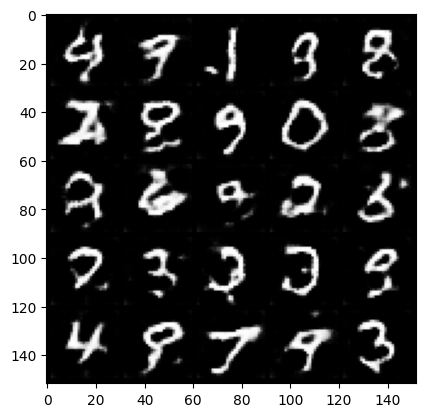

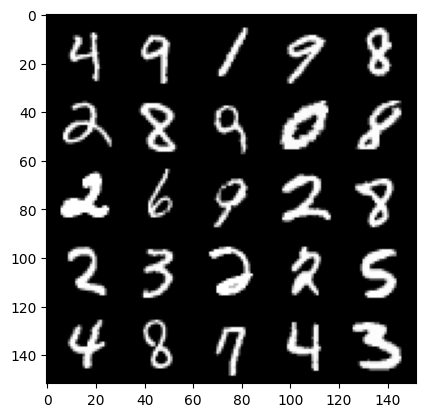

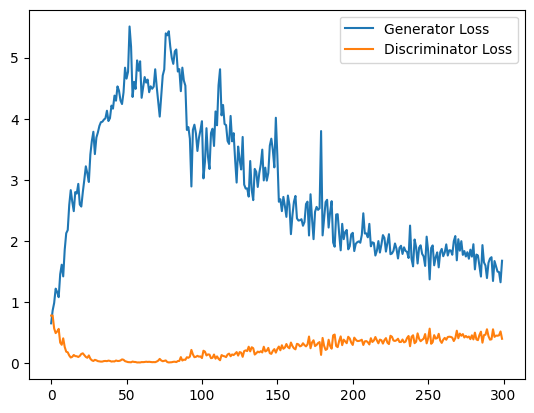

 86%|████████▌ | 402/469 [00:13<00:02, 32.39it/s]

Epoch 13, step 6500: Generator loss: 1.4252715337276458, discriminator loss: 0.48572716760635376


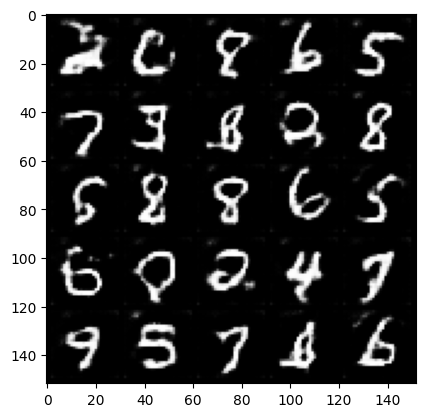

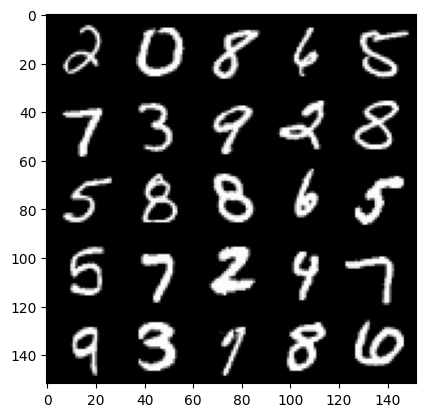

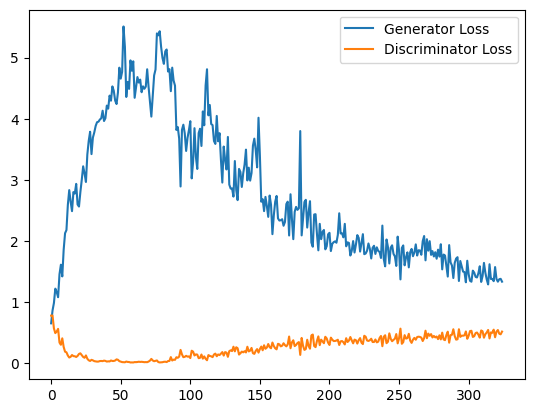

 92%|█████████▏| 431/469 [00:14<00:01, 34.32it/s]

Epoch 14, step 7000: Generator loss: 1.355774701476097, discriminator loss: 0.5088179469108581


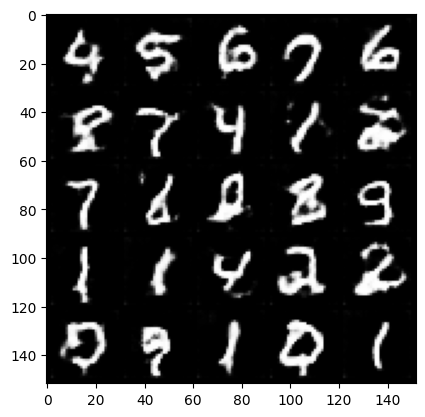

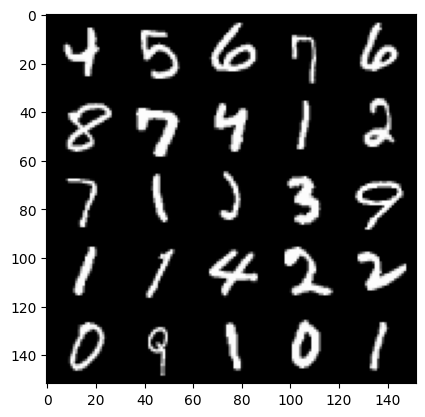

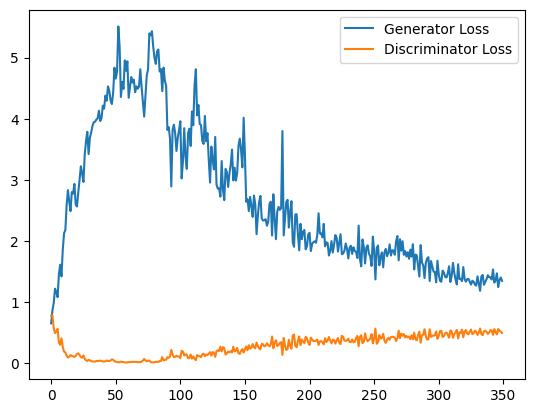

 99%|█████████▊| 462/469 [00:15<00:00, 34.80it/s]

Epoch 15, step 7500: Generator loss: 1.310904933810234, discriminator loss: 0.5362101321816445


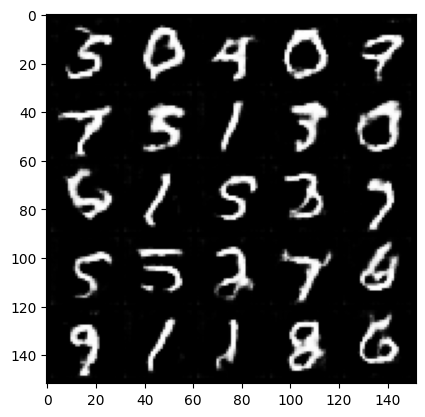

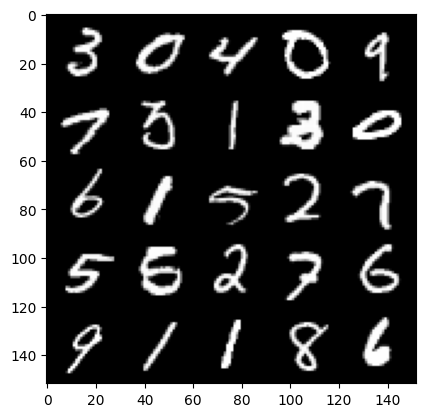

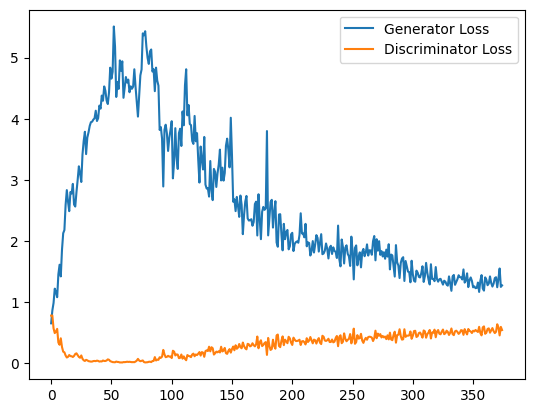

  6%|▌         | 26/469 [00:01<00:17, 24.76it/s]

Epoch 17, step 8000: Generator loss: 1.2878217120170594, discriminator loss: 0.5512668728232384


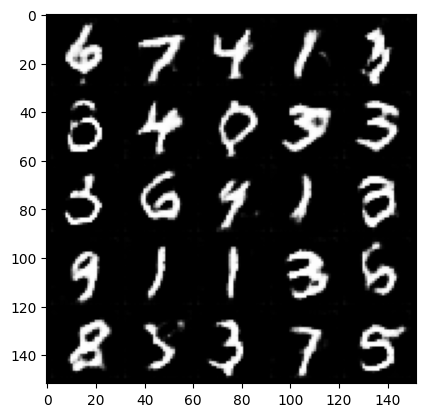

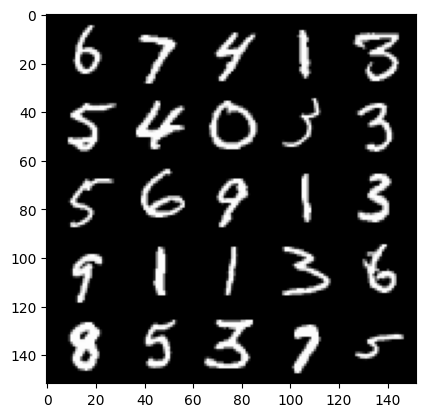

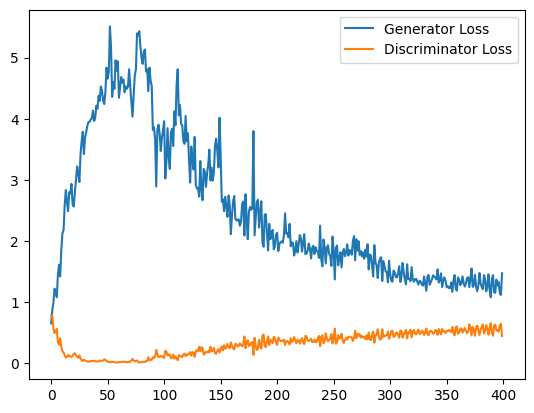

 12%|█▏        | 56/469 [00:01<00:12, 31.93it/s]

Epoch 18, step 8500: Generator loss: 1.211842972755432, discriminator loss: 0.5800194905400277


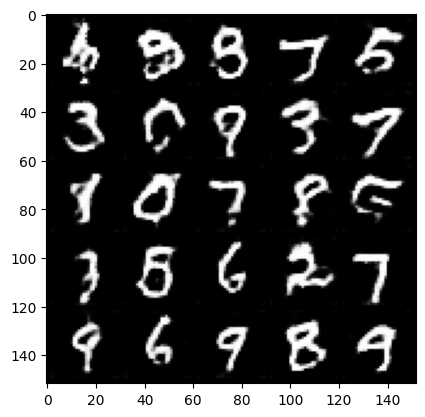

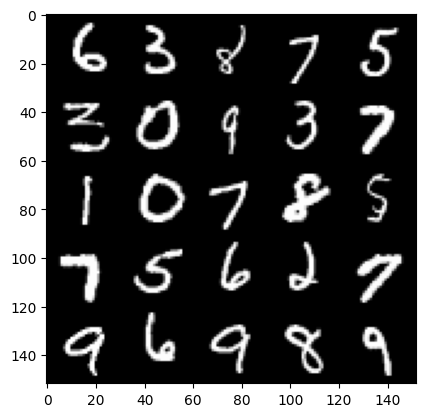

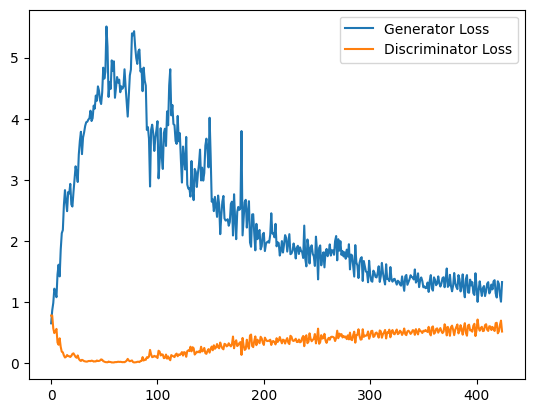

 18%|█▊        | 86/469 [00:02<00:10, 35.42it/s]

Epoch 19, step 9000: Generator loss: 1.1641496096849442, discriminator loss: 0.5835883610248566


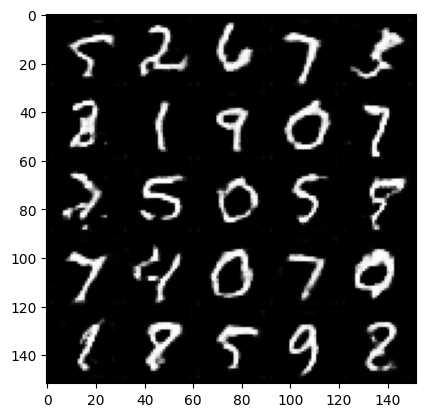

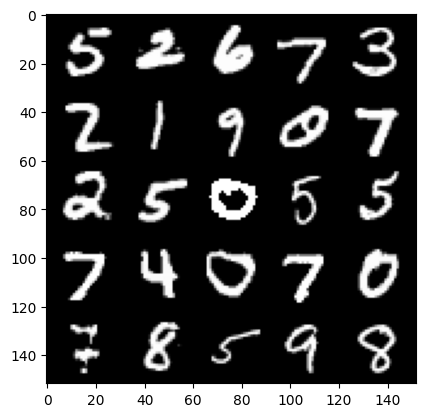

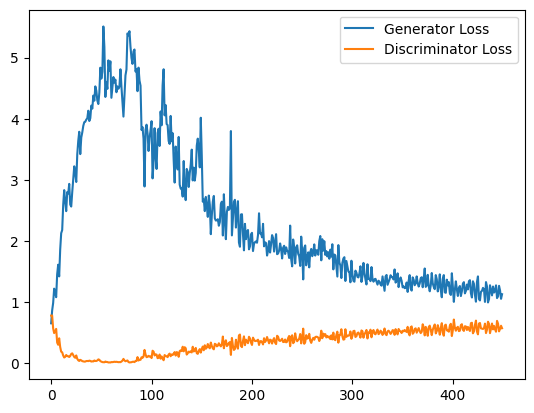

 25%|██▍       | 117/469 [00:03<00:11, 30.28it/s]

Epoch 20, step 9500: Generator loss: 1.128652427315712, discriminator loss: 0.5911470931768418


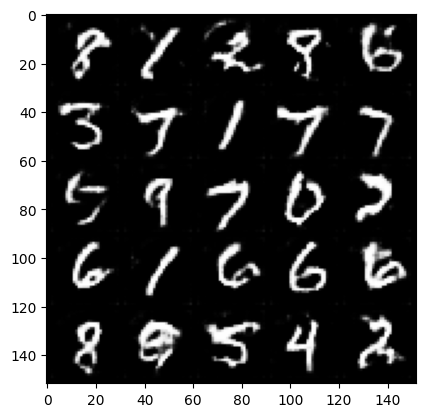

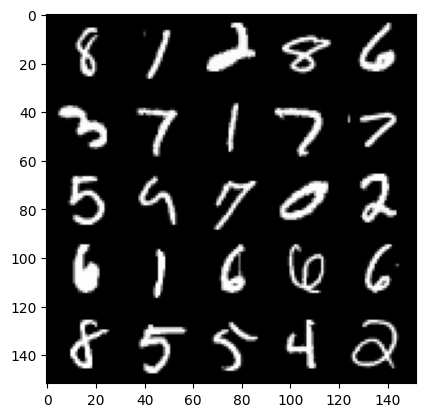

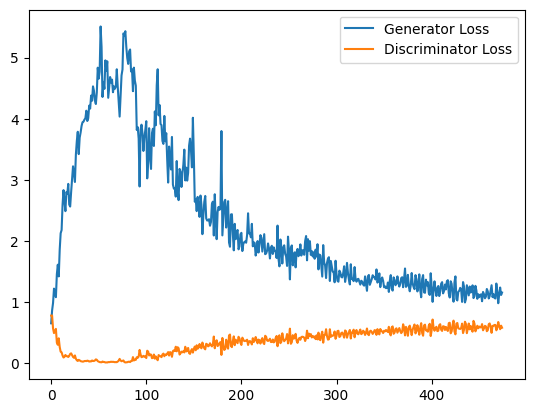

 32%|███▏      | 148/469 [00:06<00:13, 24.18it/s]

Epoch 21, step 10000: Generator loss: 1.0777273523807525, discriminator loss: 0.6144791712760925


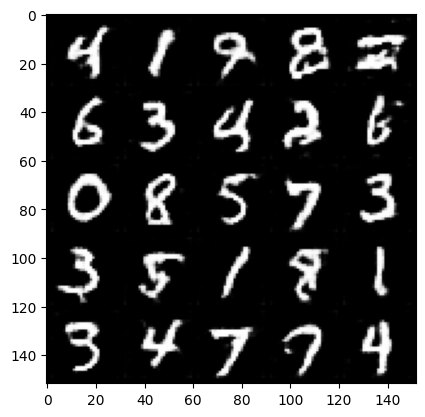

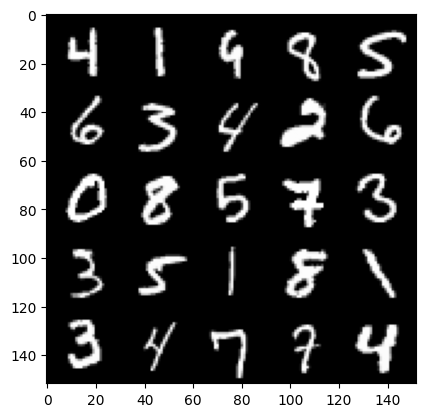

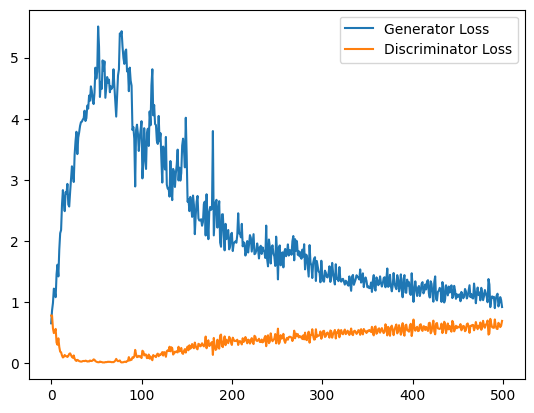

 39%|███▉      | 182/469 [00:07<00:10, 27.01it/s]

Epoch 22, step 10500: Generator loss: 1.0308470540046692, discriminator loss: 0.6202122181653976


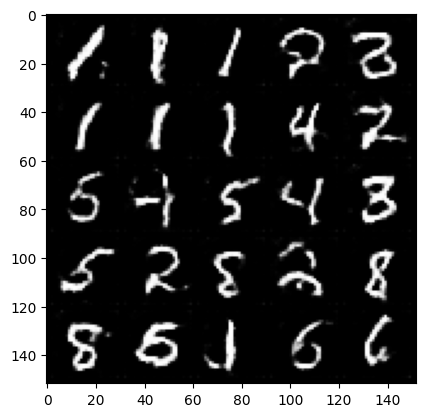

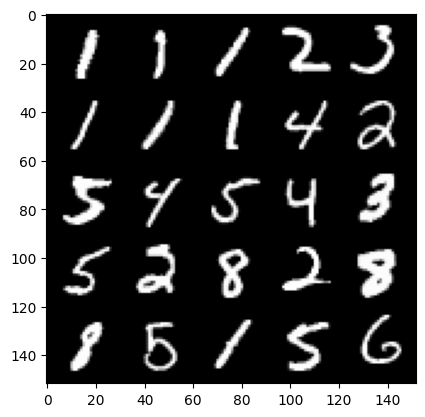

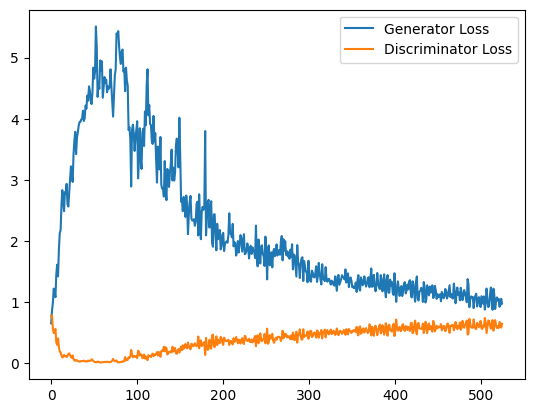

 45%|████▍     | 211/469 [00:05<00:06, 37.65it/s]

Epoch 23, step 11000: Generator loss: 1.0988631634712218, discriminator loss: 0.622013031065464


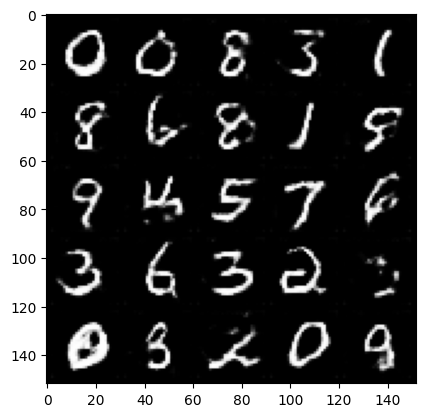

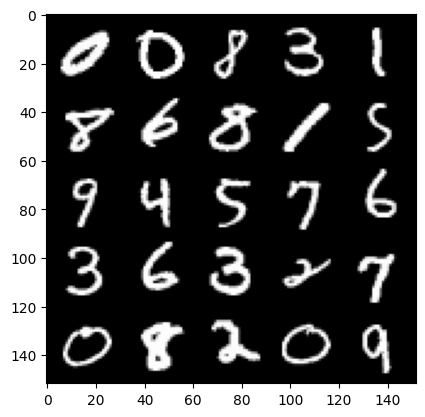

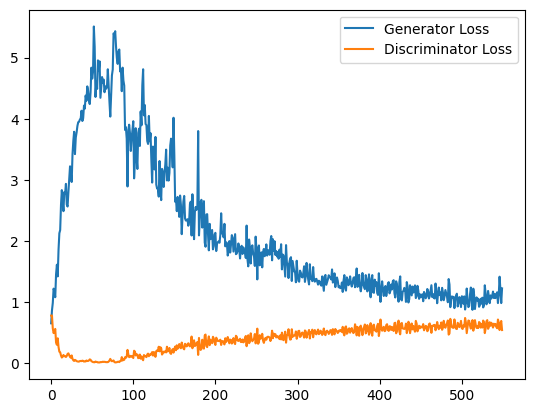

 51%|█████▏    | 241/469 [00:07<00:07, 32.38it/s]

Epoch 24, step 11500: Generator loss: 1.0524108690023422, discriminator loss: 0.6227904856204987


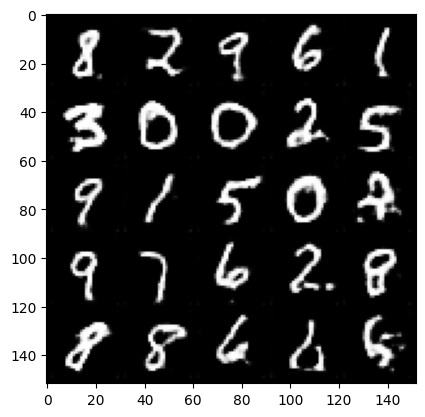

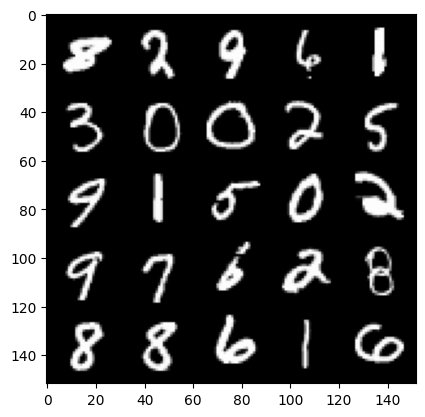

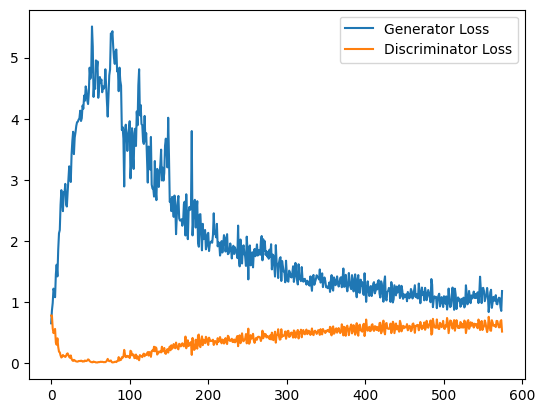

 58%|█████▊    | 274/469 [00:10<00:08, 23.92it/s]

Epoch 25, step 12000: Generator loss: 0.9782889422178268, discriminator loss: 0.6355732223987579


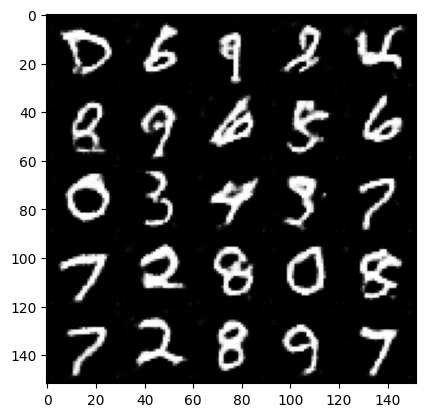

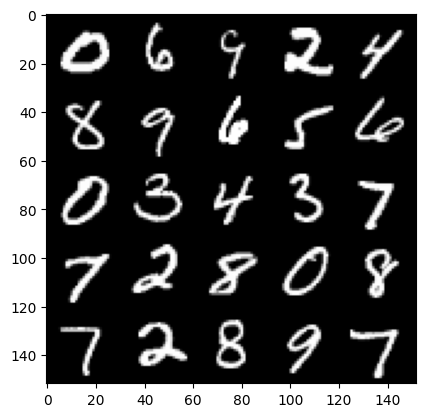

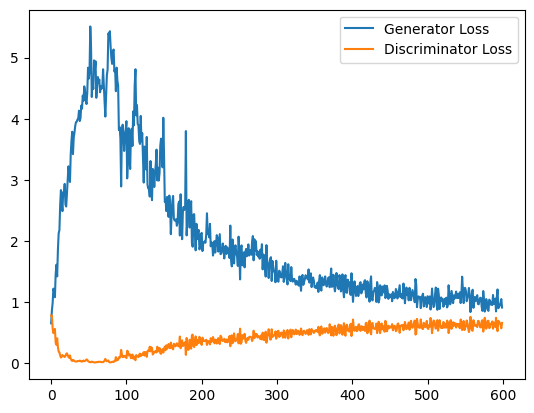

 65%|██████▍   | 304/469 [00:14<00:06, 26.47it/s]

Epoch 26, step 12500: Generator loss: 0.9774553104639053, discriminator loss: 0.6421256293058395


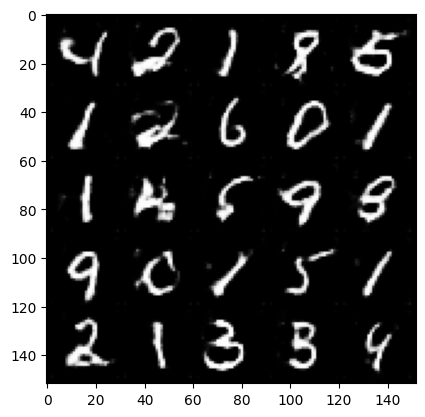

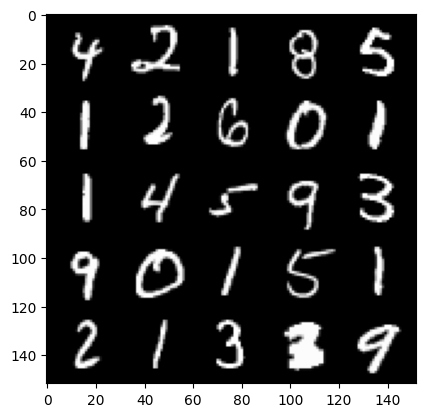

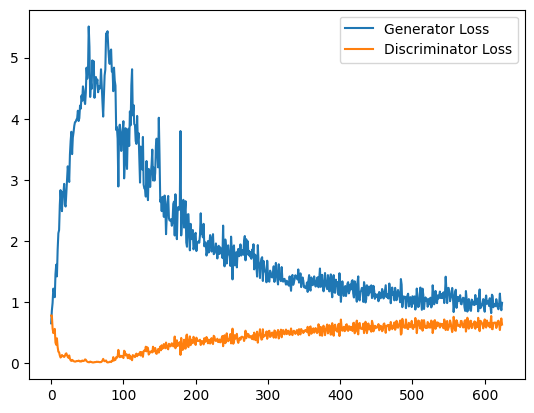

 72%|███████▏  | 337/469 [00:16<00:04, 27.56it/s]

Epoch 27, step 13000: Generator loss: 0.9630061093568801, discriminator loss: 0.6496037877798081


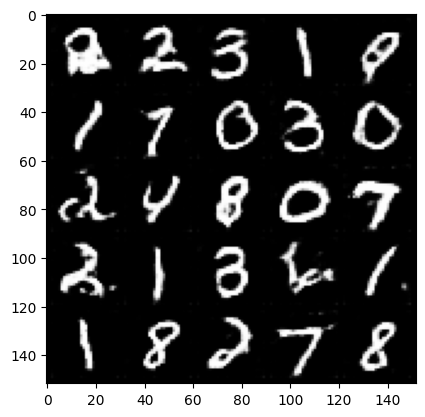

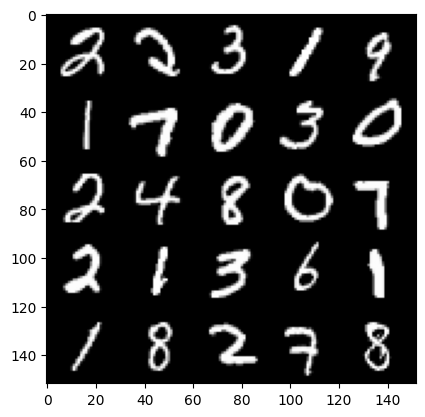

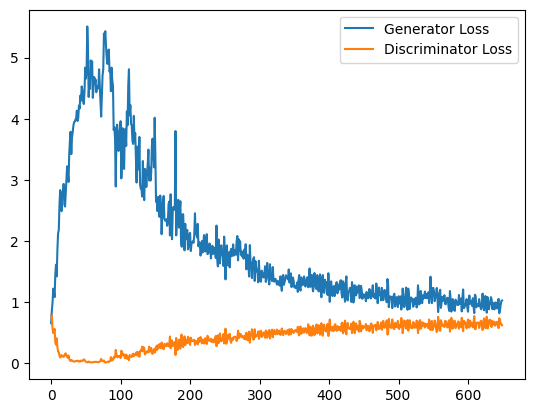

 78%|███████▊  | 367/469 [00:17<00:04, 20.84it/s]

Epoch 28, step 13500: Generator loss: 0.9261596792936325, discriminator loss: 0.6506140979528428


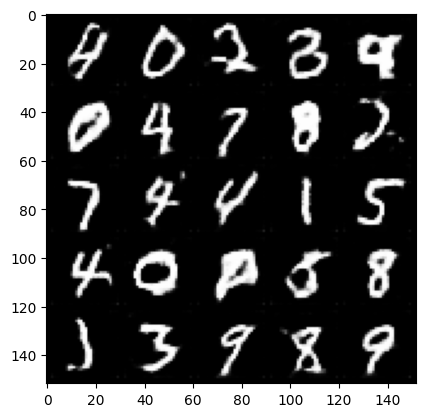

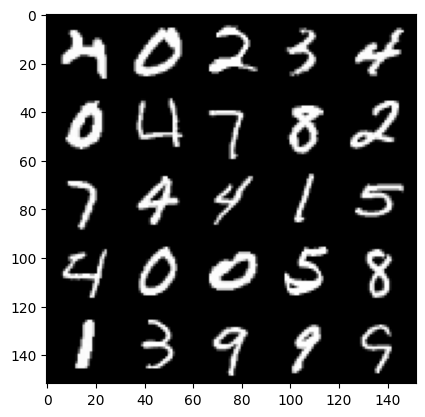

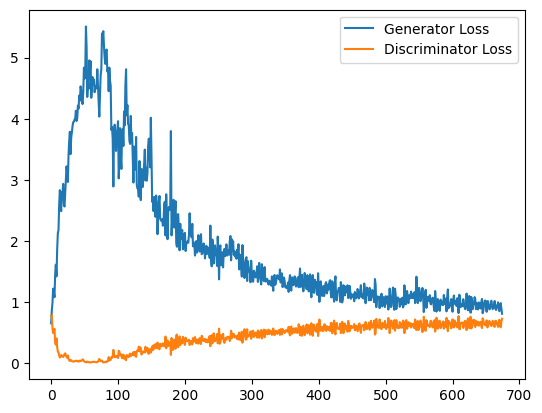

 85%|████████▍ | 397/469 [00:17<00:02, 28.22it/s]

Epoch 29, step 14000: Generator loss: 0.9766234492063522, discriminator loss: 0.6478488396406173


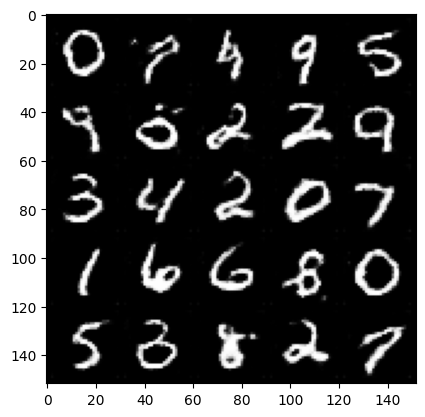

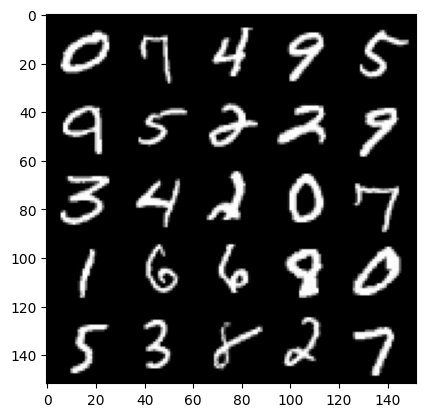

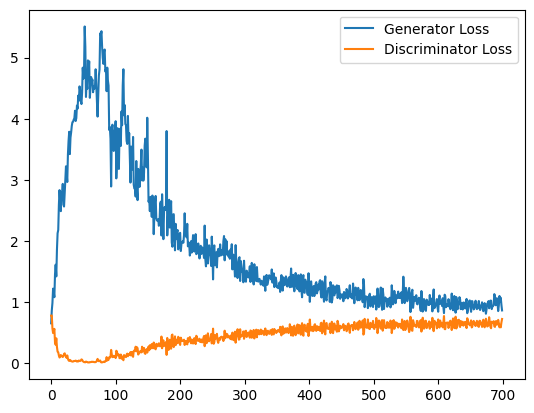

 91%|█████████ | 427/469 [00:20<00:01, 24.47it/s]

Epoch 30, step 14500: Generator loss: 0.9386339089870452, discriminator loss: 0.6552717133760452


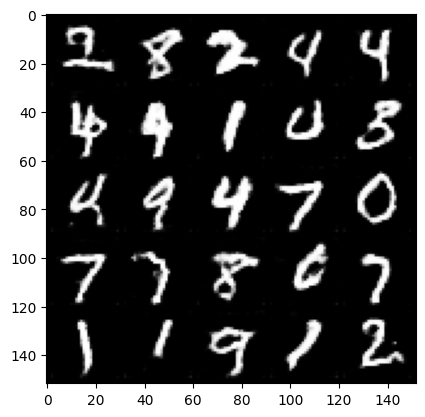

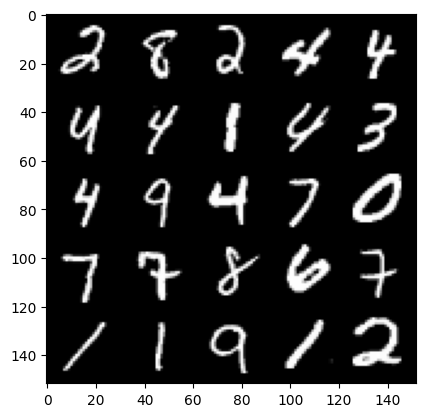

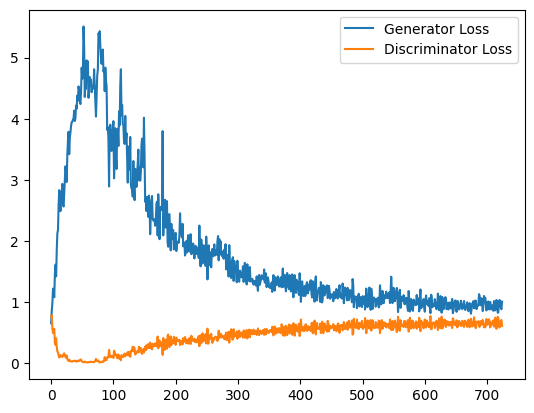

 98%|█████████▊| 459/469 [00:20<00:00, 21.13it/s]

Epoch 31, step 15000: Generator loss: 0.9356965037584305, discriminator loss: 0.6520599191188812


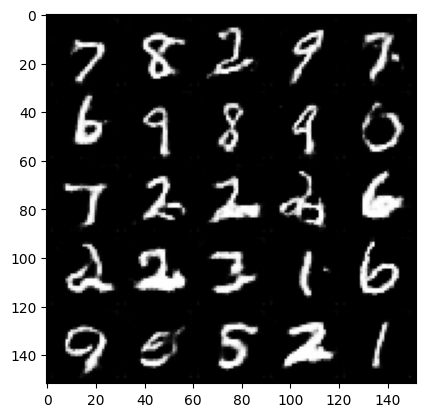

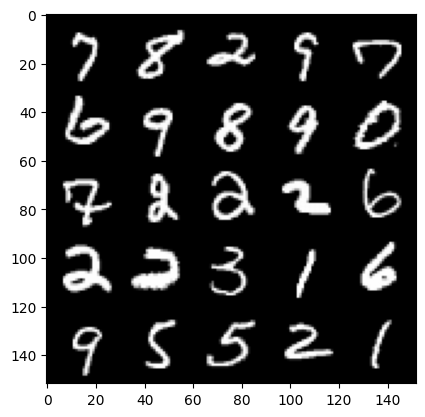

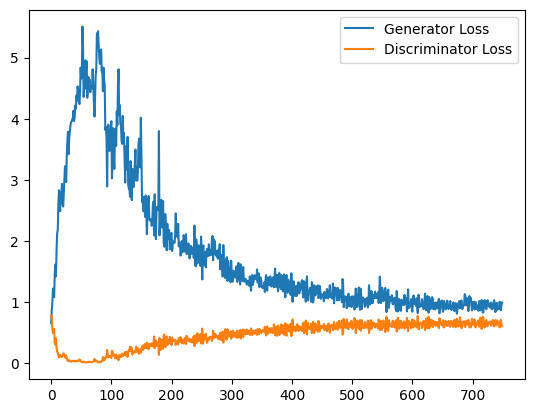

  5%|▍         | 23/469 [00:02<00:45,  9.82it/s]

Epoch 33, step 15500: Generator loss: 0.8983321731090546, discriminator loss: 0.6593468374013901


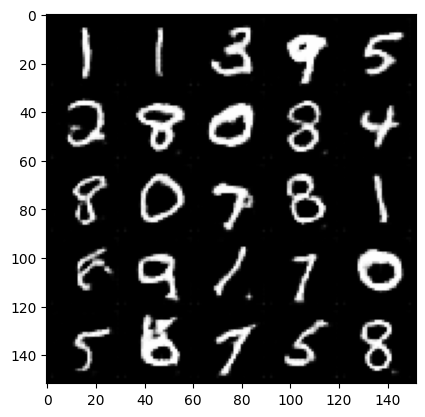

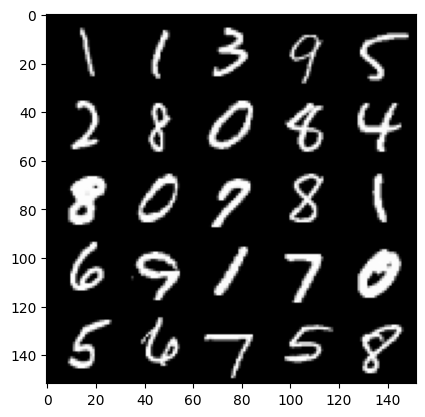

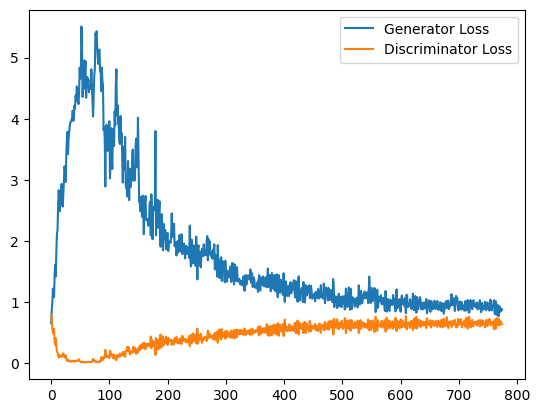

 12%|█▏        | 54/469 [00:06<00:44,  9.23it/s]

Epoch 34, step 16000: Generator loss: 0.8857124637365341, discriminator loss: 0.6614251900911331


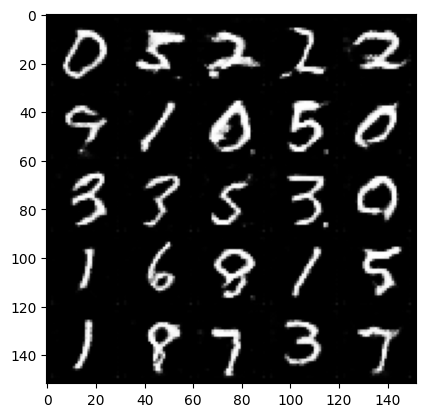

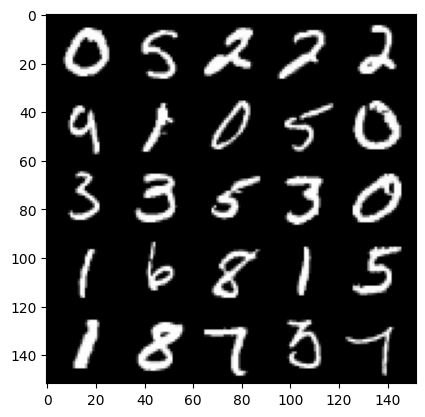

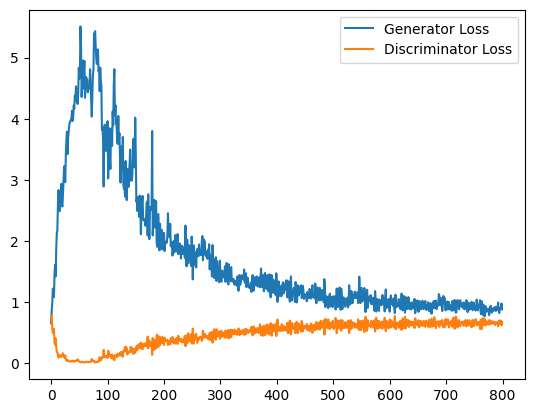

 18%|█▊        | 84/469 [00:02<00:11, 34.07it/s]

Epoch 35, step 16500: Generator loss: 0.9086803588867187, discriminator loss: 0.6637008638381958


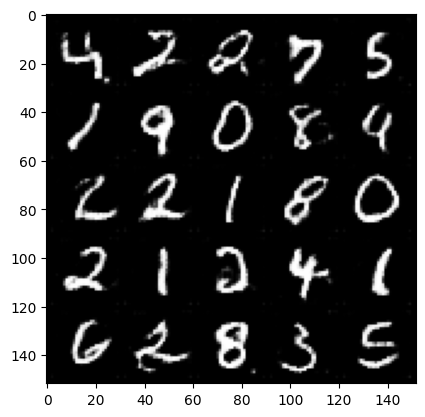

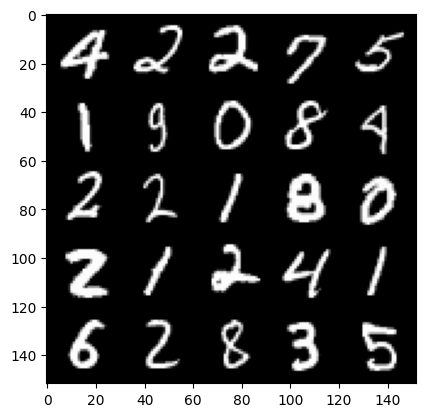

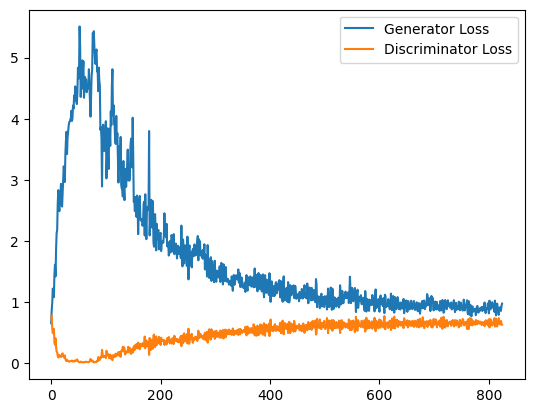

 25%|██▍       | 116/469 [00:03<00:10, 35.25it/s]

Epoch 36, step 17000: Generator loss: 0.8627500309944153, discriminator loss: 0.6654605089426041


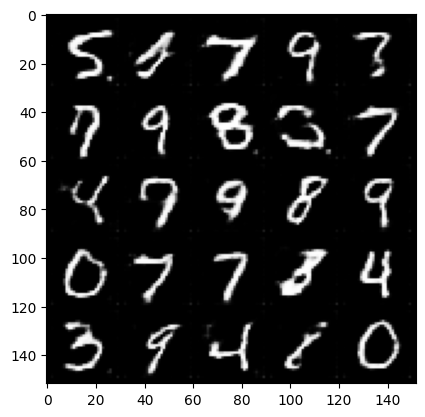

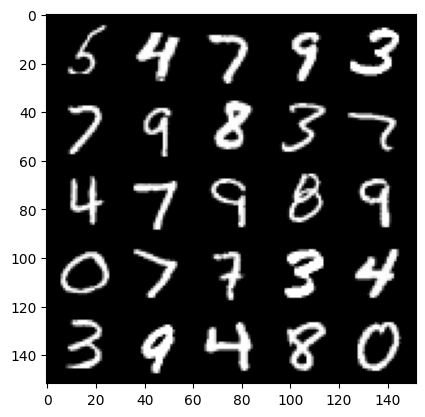

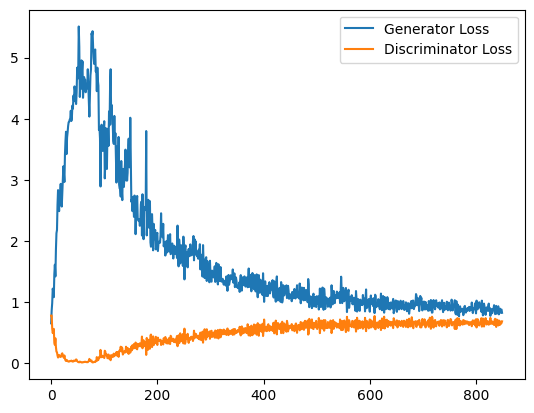

 31%|███       | 146/469 [00:05<00:13, 23.65it/s]

Epoch 37, step 17500: Generator loss: 0.8862428078651429, discriminator loss: 0.6635248430967331


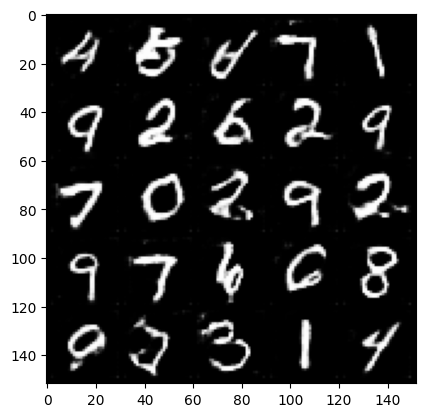

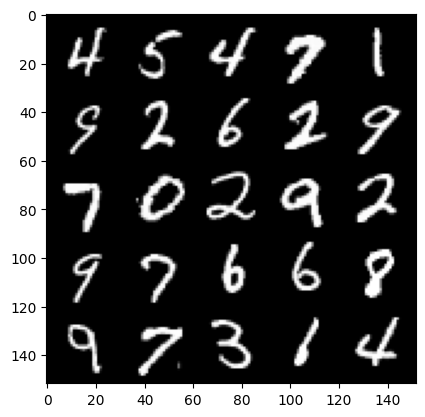

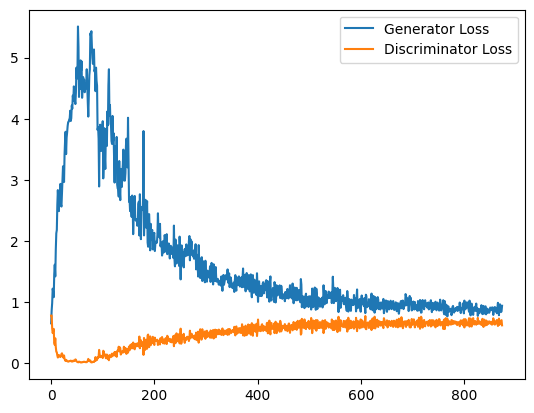

 38%|███▊      | 176/469 [00:05<00:10, 29.13it/s]

Epoch 38, step 18000: Generator loss: 0.8671829586029053, discriminator loss: 0.6747255066633224


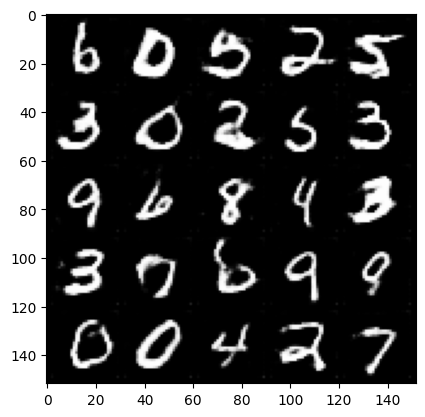

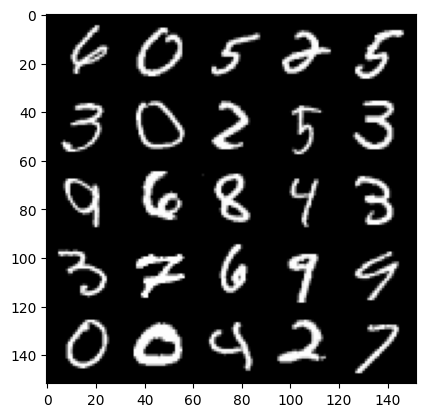

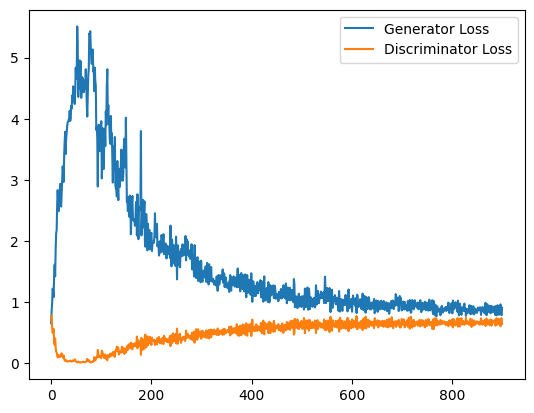

 44%|████▍     | 208/469 [00:08<00:08, 30.25it/s]

Epoch 39, step 18500: Generator loss: 0.8795417147874832, discriminator loss: 0.6728664762973785


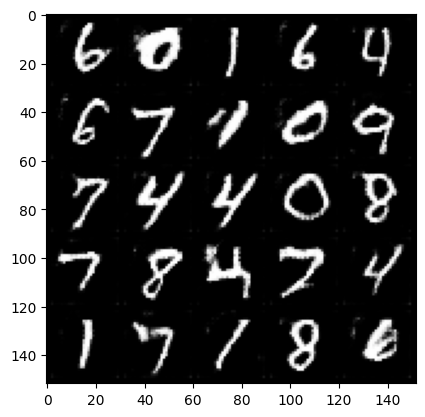

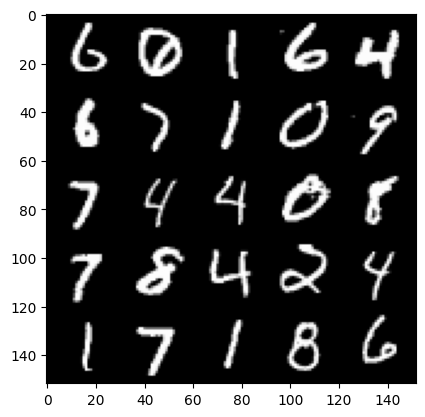

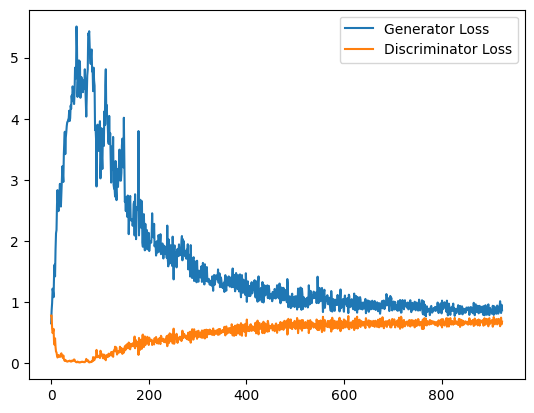

 51%|█████     | 240/469 [00:11<00:11, 19.79it/s]

Epoch 40, step 19000: Generator loss: 0.8888631511926651, discriminator loss: 0.6715570050477981


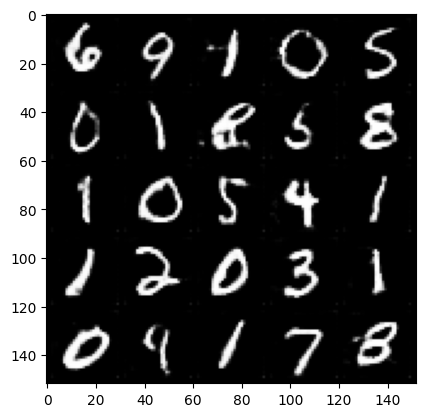

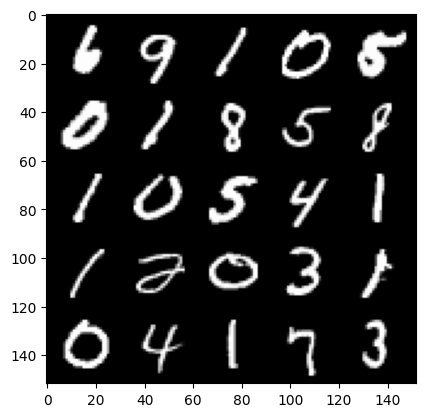

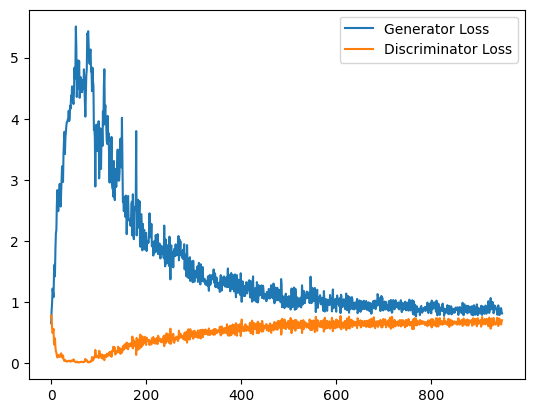

 58%|█████▊    | 271/469 [00:13<00:10, 19.03it/s]

Epoch 41, step 19500: Generator loss: 0.843250060915947, discriminator loss: 0.6717063356637955


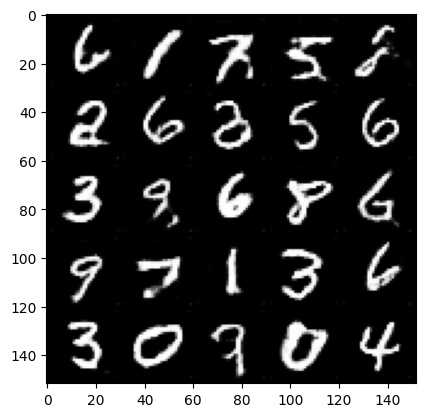

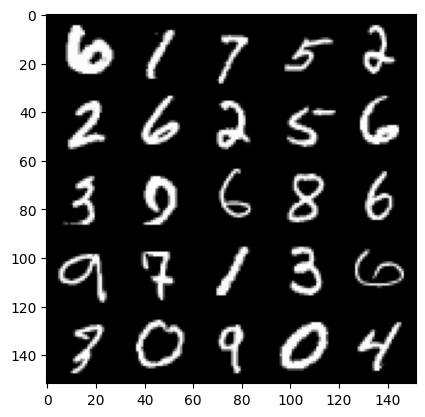

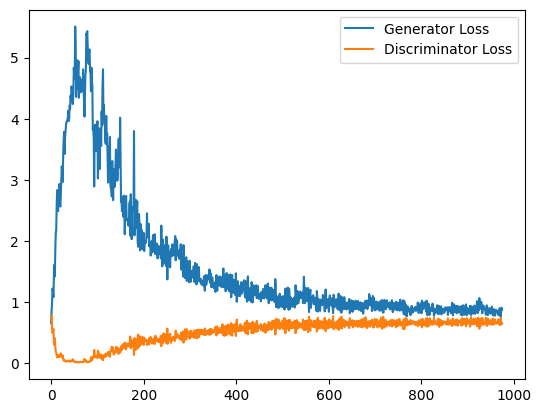

 64%|██████▍   | 300/469 [00:14<00:07, 22.24it/s]

Epoch 42, step 20000: Generator loss: 0.8397833559513092, discriminator loss: 0.6726604541540145


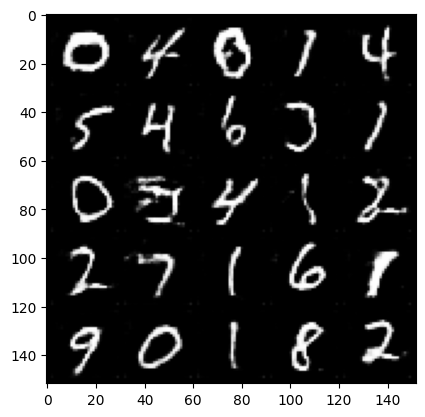

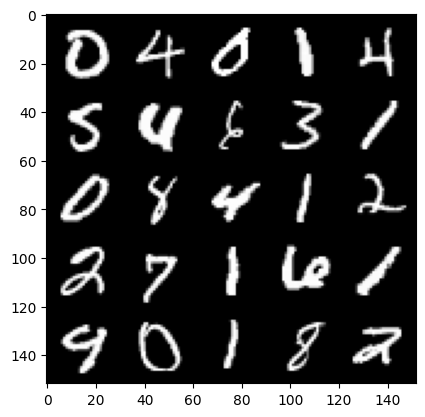

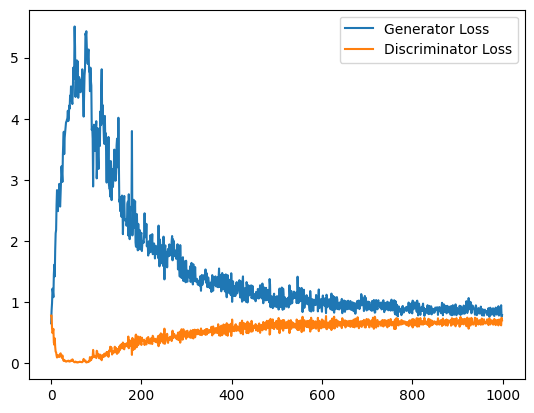

 71%|███████   | 331/469 [00:17<00:07, 18.52it/s]

Epoch 43, step 20500: Generator loss: 0.8615778948068619, discriminator loss: 0.6647985634803772


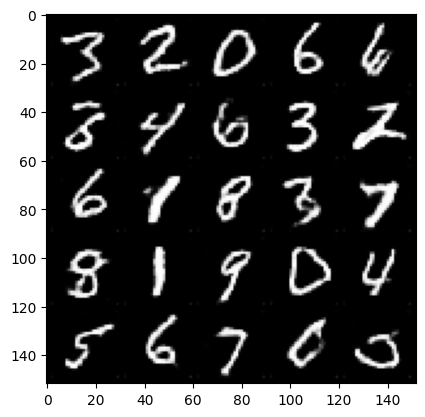

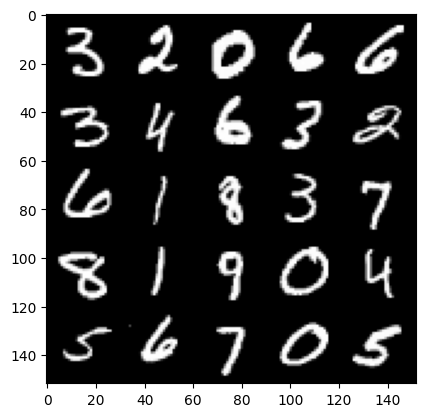

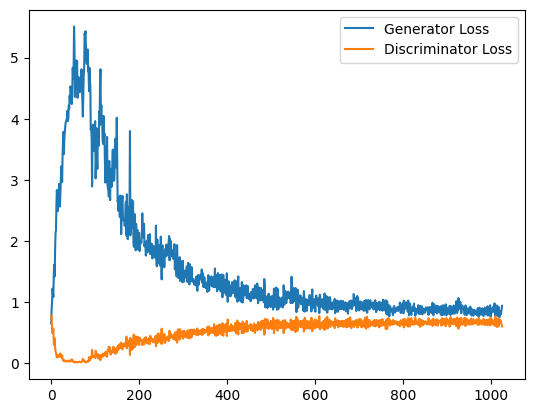

 77%|███████▋  | 363/469 [00:18<00:05, 20.50it/s]

Epoch 44, step 21000: Generator loss: 0.8358058588504791, discriminator loss: 0.6784886046648025


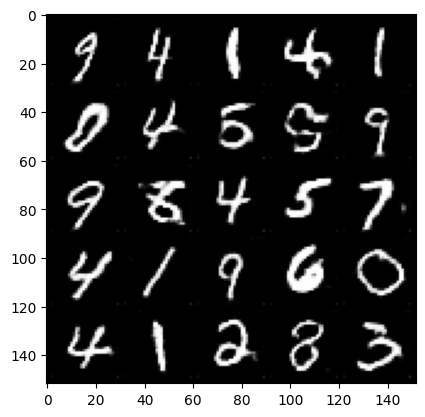

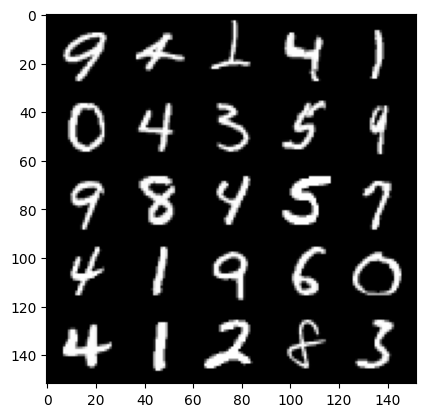

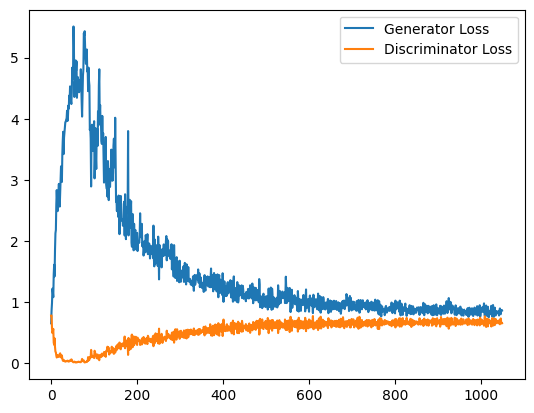

 84%|████████▍ | 395/469 [00:40<00:06, 10.72it/s]

Epoch 45, step 21500: Generator loss: 0.8370631459951401, discriminator loss: 0.6791965230703354


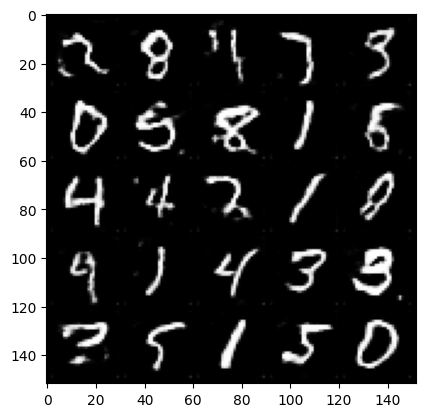

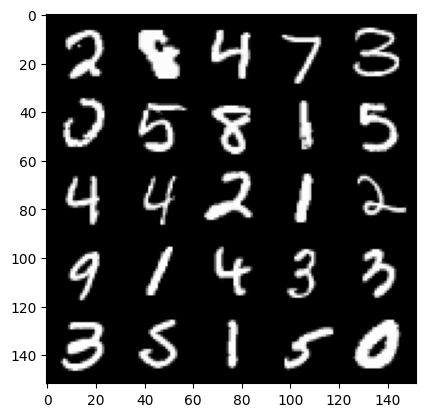

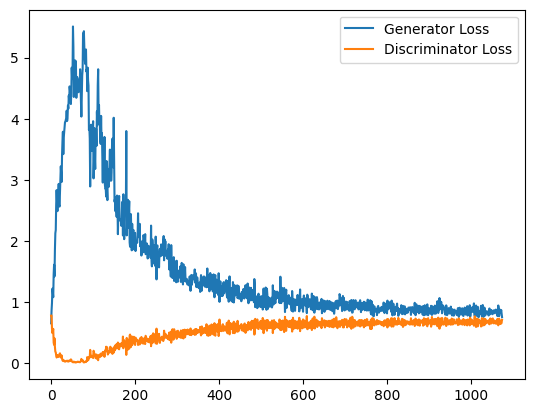

 91%|█████████ | 426/469 [00:43<00:04, 10.25it/s]

Epoch 46, step 22000: Generator loss: 0.8237017214298248, discriminator loss: 0.6738103340864181


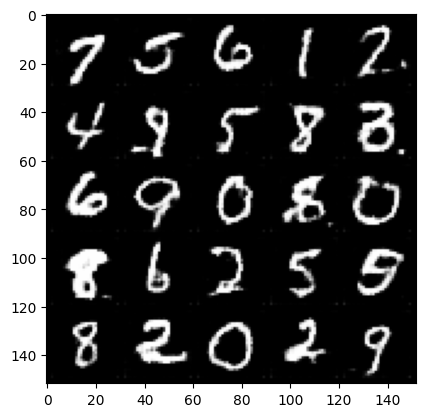

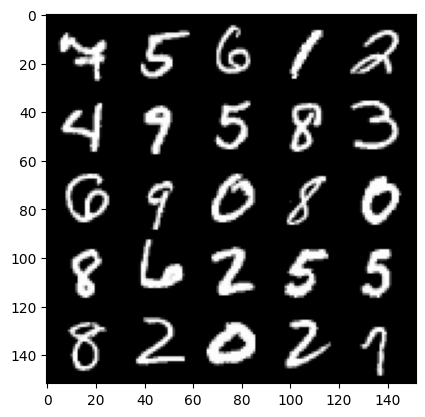

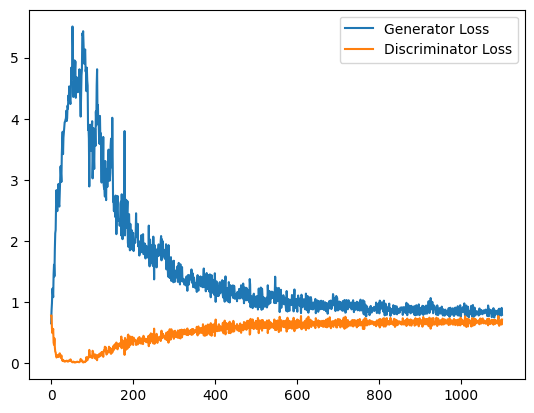

 97%|█████████▋| 456/469 [00:31<00:00, 22.55it/s]

Epoch 47, step 22500: Generator loss: 0.8216153721809387, discriminator loss: 0.6749333891868591


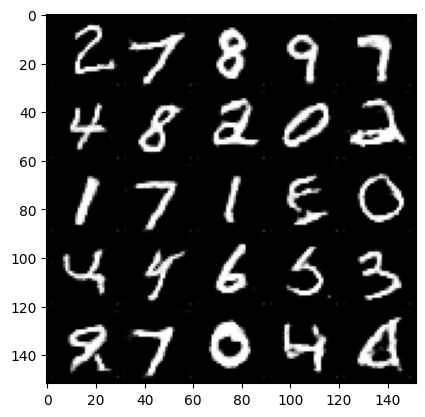

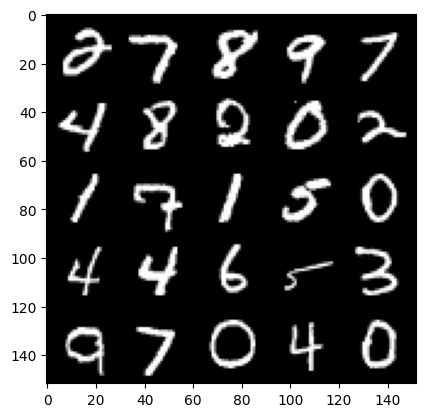

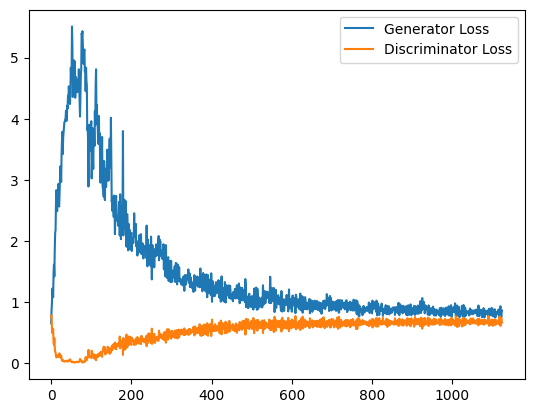

  4%|▍         | 18/469 [00:00<00:17, 25.45it/s]

Epoch 49, step 23000: Generator loss: 0.8189234697818756, discriminator loss: 0.673335721373558


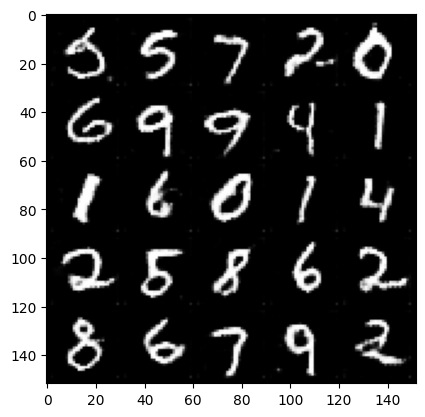

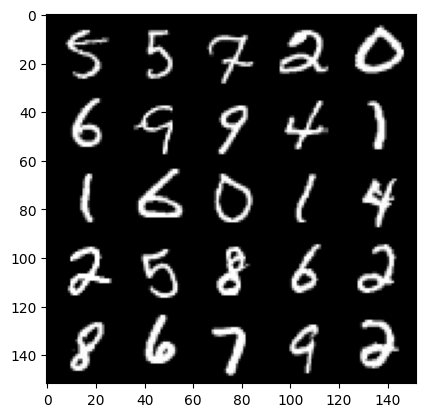

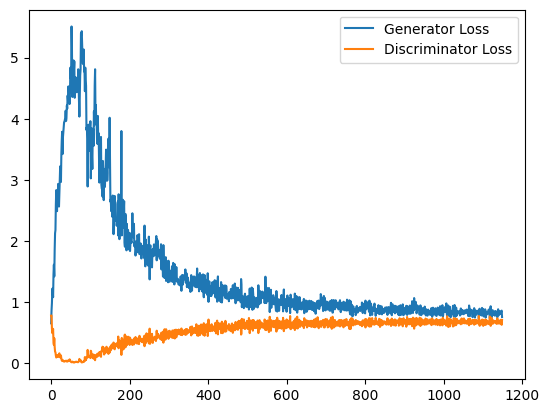

 10%|█         | 47/469 [00:01<00:13, 30.65it/s]

Epoch 50, step 23500: Generator loss: 0.8354870864152908, discriminator loss: 0.6756206940412521


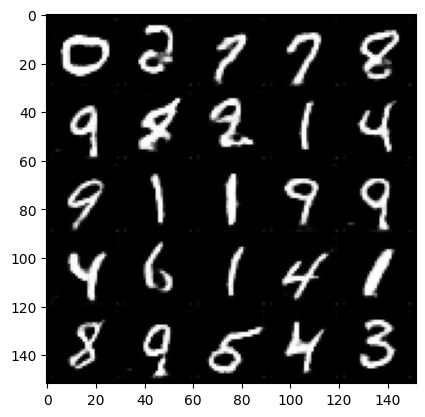

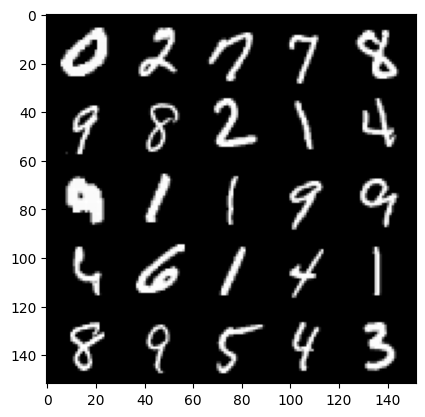

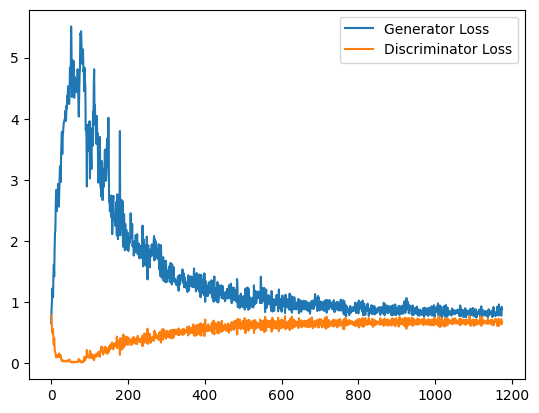

 17%|█▋        | 79/469 [00:02<00:15, 25.77it/s]

Epoch 51, step 24000: Generator loss: 0.8269735629558563, discriminator loss: 0.6762293984889984


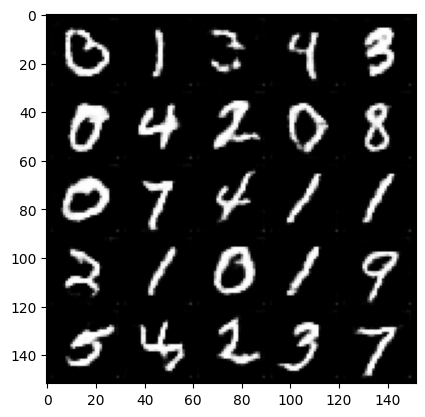

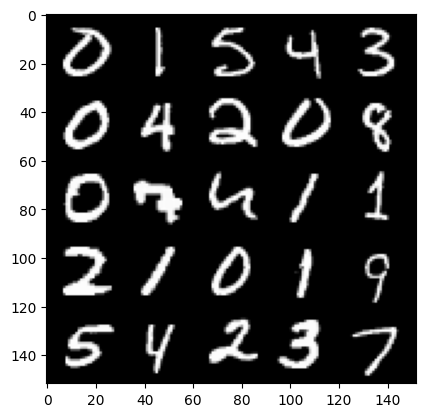

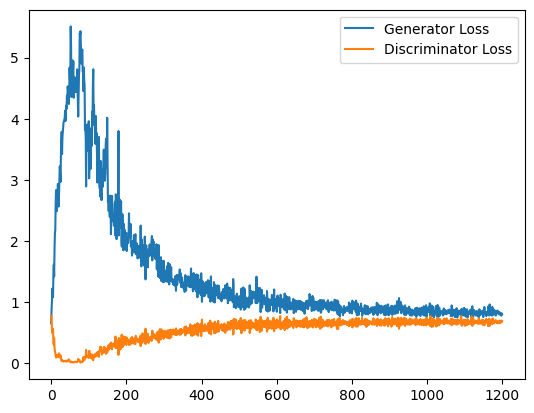

 23%|██▎       | 109/469 [00:04<00:12, 27.79it/s]

Epoch 52, step 24500: Generator loss: 0.8136431015729905, discriminator loss: 0.6783189148902893


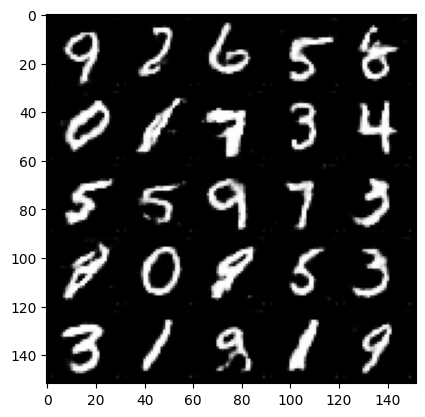

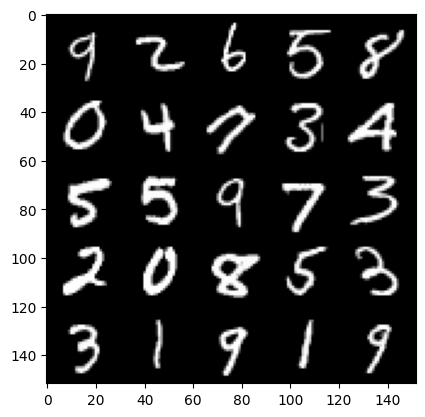

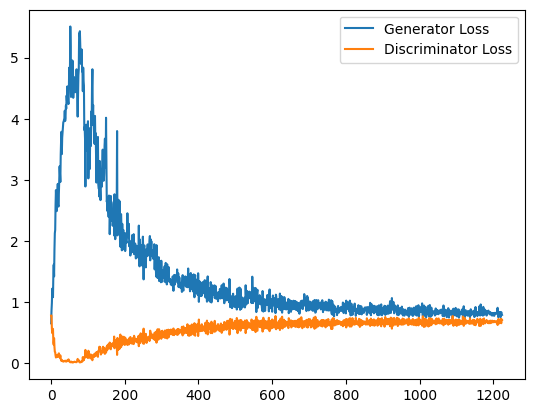

 30%|███       | 143/469 [00:04<00:10, 30.91it/s]

Epoch 53, step 25000: Generator loss: 0.8073669655323028, discriminator loss: 0.6768361048698426


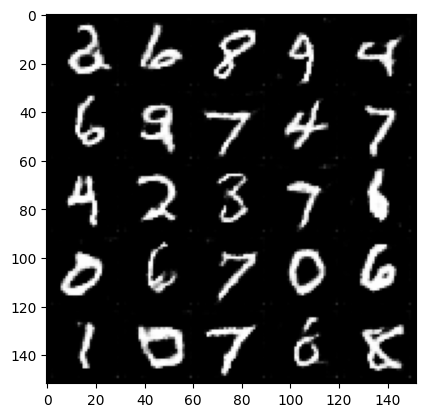

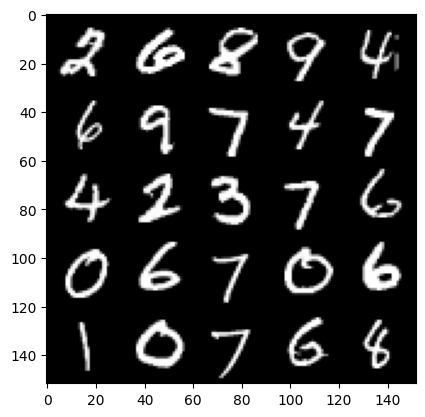

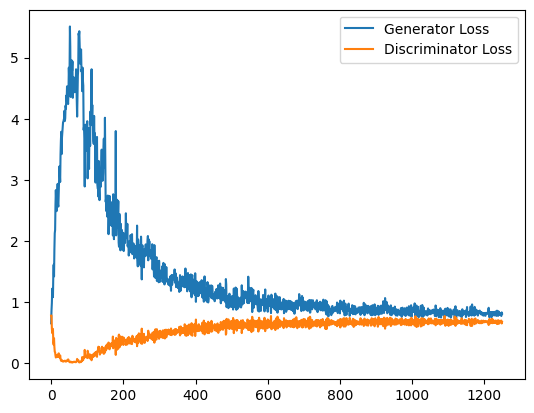

 37%|███▋      | 174/469 [00:15<00:28, 10.34it/s]

Epoch 54, step 25500: Generator loss: 0.8000801072120667, discriminator loss: 0.6738793460130692


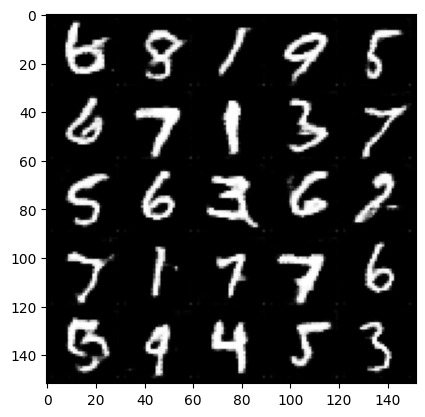

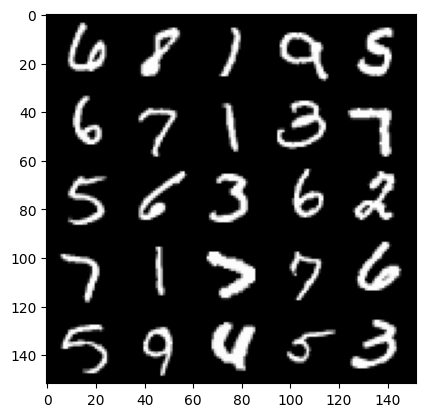

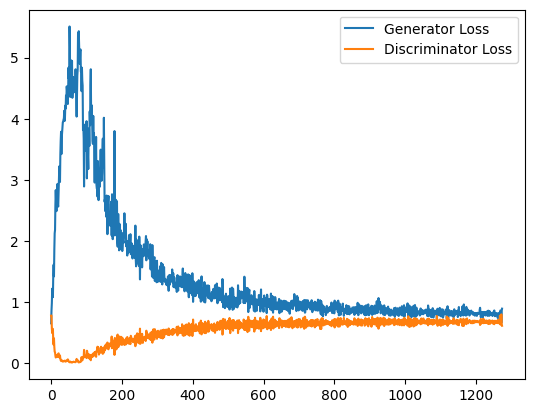

 44%|████▎     | 205/469 [00:17<00:22, 11.71it/s]

Epoch 55, step 26000: Generator loss: 0.8232671498060227, discriminator loss: 0.6812205063104629


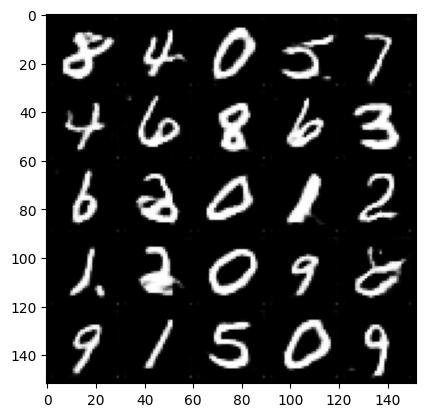

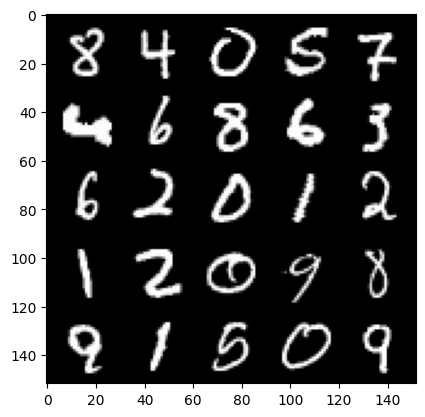

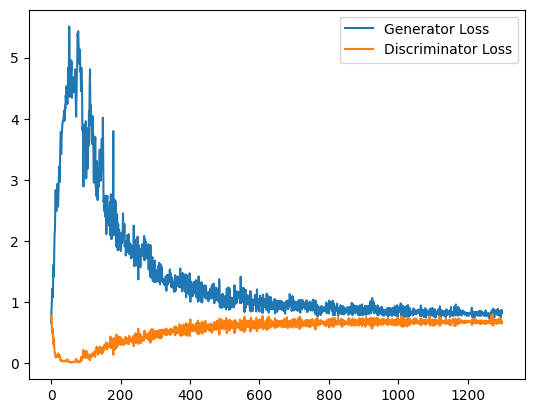

 50%|█████     | 236/469 [00:20<00:18, 12.37it/s]

Epoch 56, step 26500: Generator loss: 0.807518678188324, discriminator loss: 0.6827575209140777


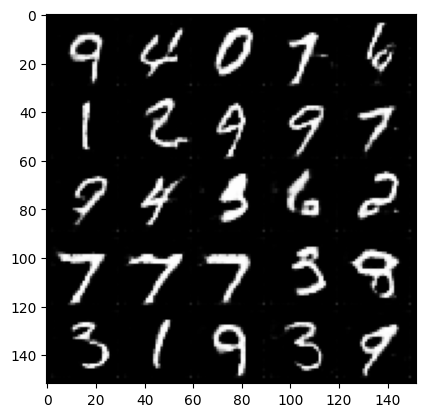

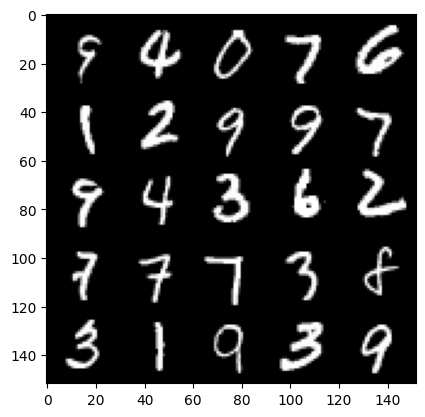

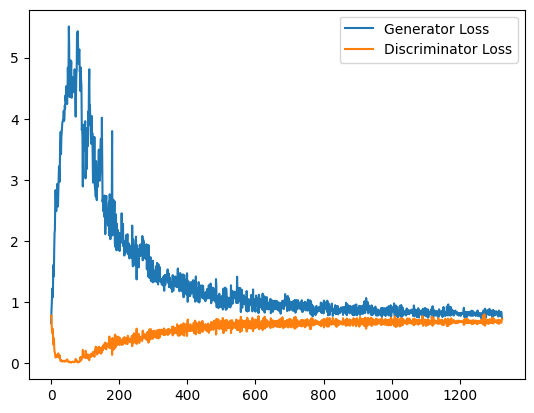

 57%|█████▋    | 267/469 [00:23<00:24,  8.37it/s]

Epoch 57, step 27000: Generator loss: 0.807880390405655, discriminator loss: 0.6766299265623092


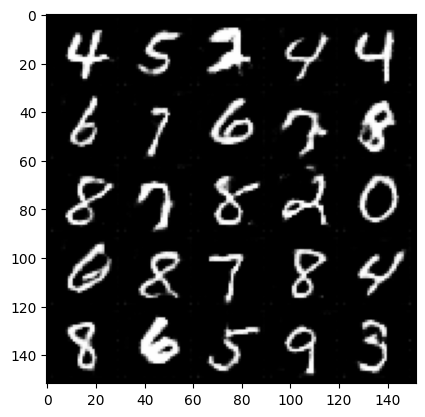

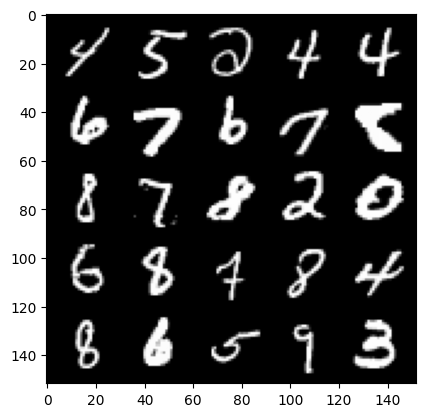

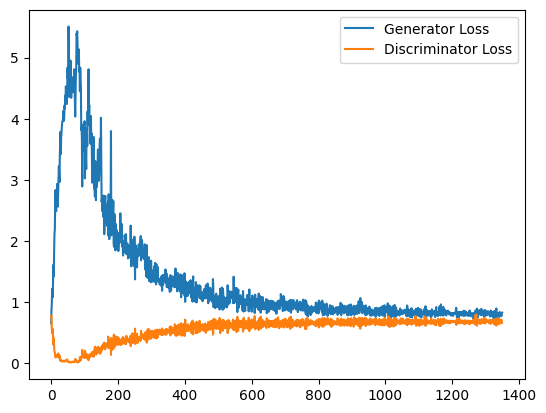

 63%|██████▎   | 297/469 [00:25<00:17,  9.93it/s]

Epoch 58, step 27500: Generator loss: 0.7960593053102494, discriminator loss: 0.6778385925292969


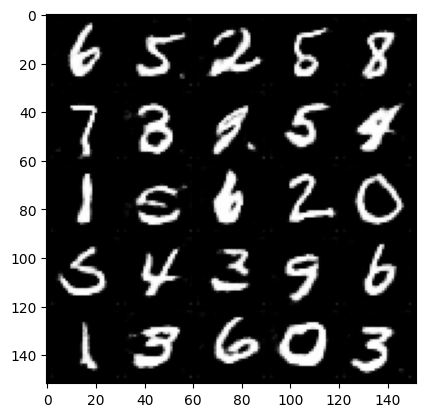

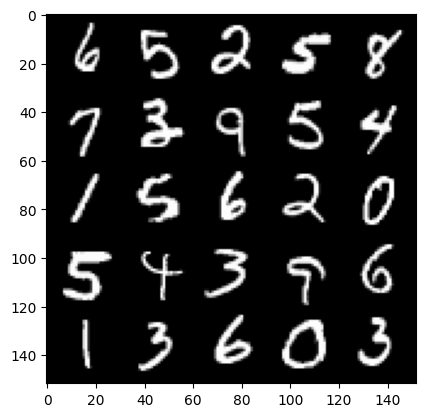

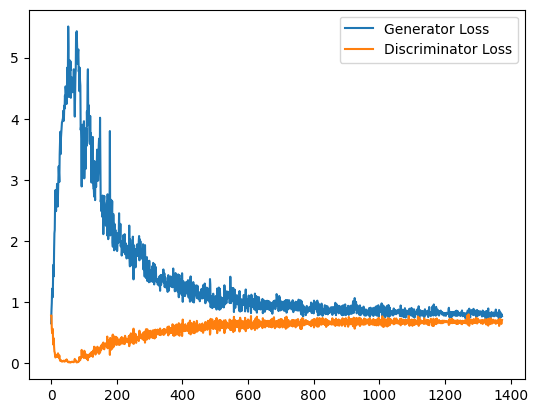

 70%|███████   | 329/469 [00:28<00:10, 12.92it/s]

Epoch 59, step 28000: Generator loss: 0.8014081771373749, discriminator loss: 0.6791652284860611


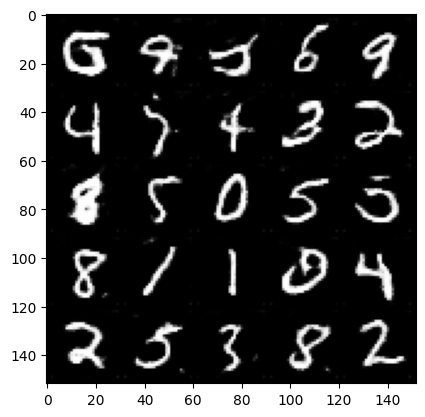

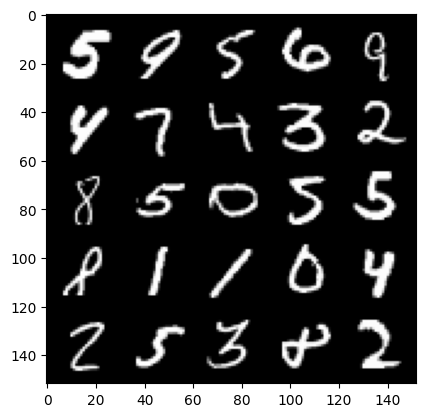

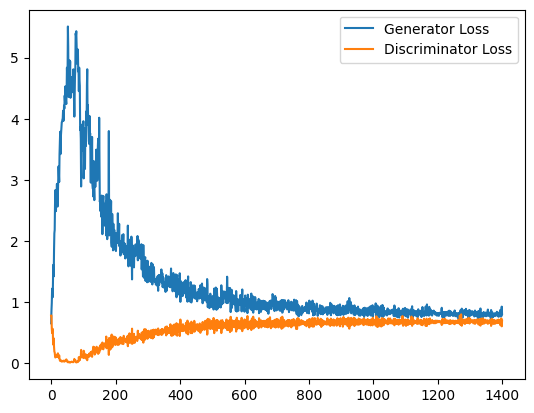

 77%|███████▋  | 359/469 [00:30<00:10, 10.09it/s]

Epoch 60, step 28500: Generator loss: 0.7994764828681946, discriminator loss: 0.6779838228225707


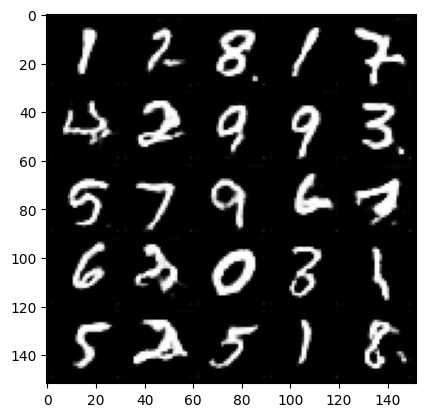

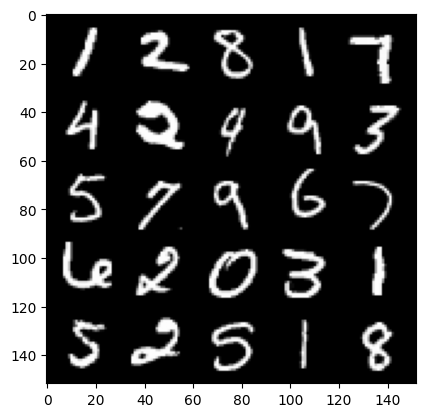

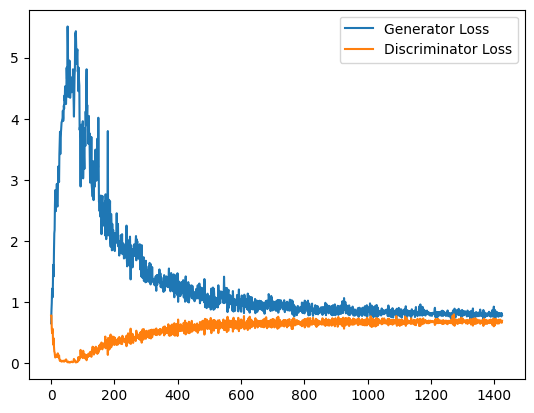

 83%|████████▎ | 391/469 [00:33<00:06, 11.83it/s]

Epoch 61, step 29000: Generator loss: 0.8086614953279495, discriminator loss: 0.6822514228820801


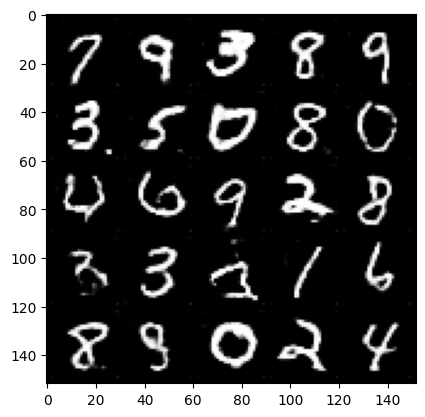

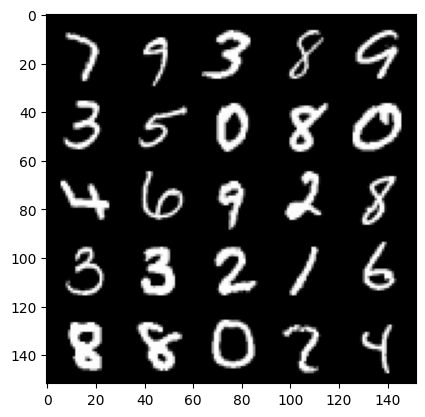

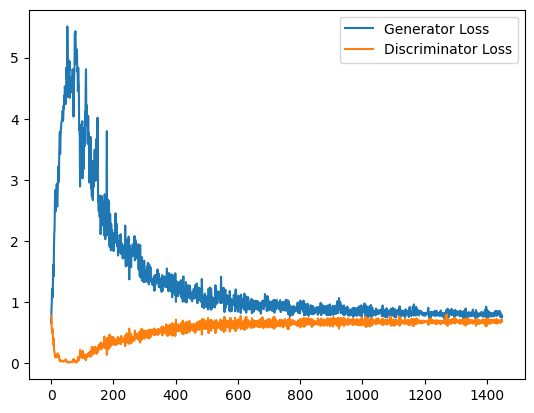

 90%|████████▉ | 421/469 [00:36<00:03, 13.00it/s]

Epoch 62, step 29500: Generator loss: 0.769466118812561, discriminator loss: 0.6805433599948884


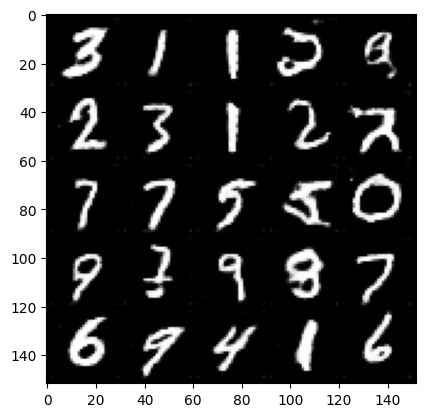

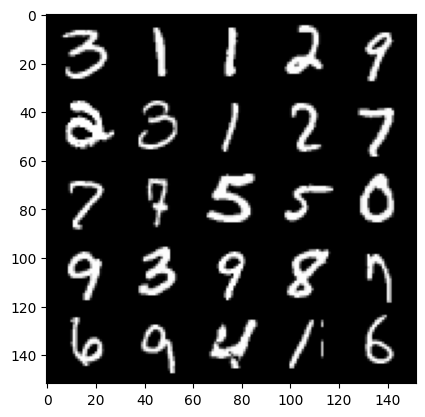

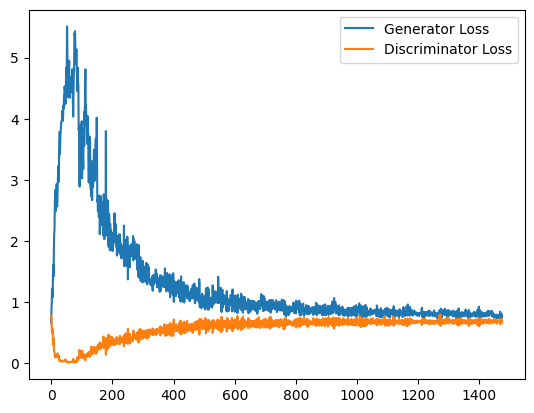

 97%|█████████▋| 453/469 [00:39<00:01, 11.99it/s]

Epoch 63, step 30000: Generator loss: 0.7885620630979538, discriminator loss: 0.677203594326973


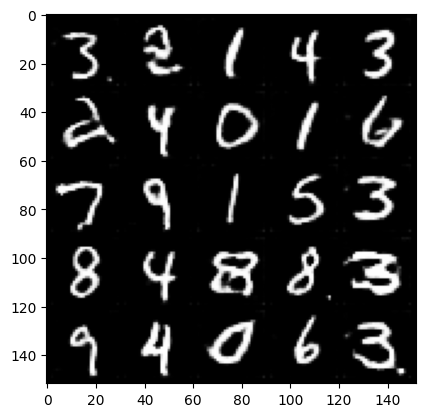

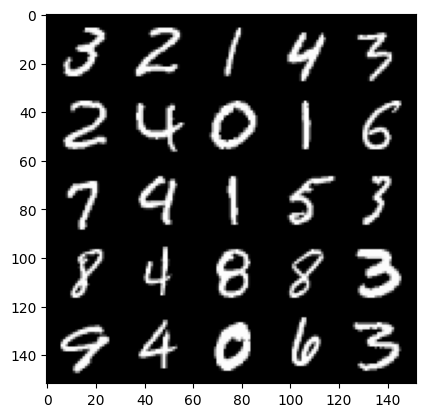

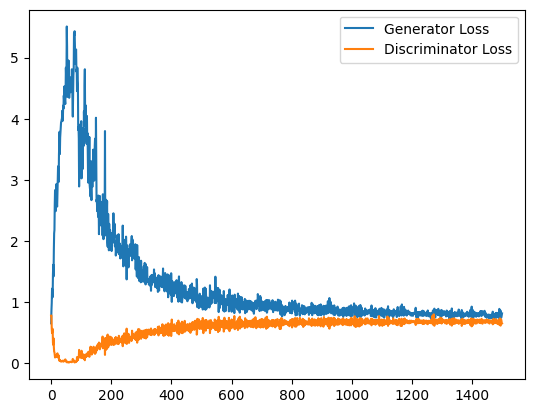

  3%|▎         | 15/469 [00:01<00:58,  7.77it/s]

Epoch 65, step 30500: Generator loss: 0.782740737080574, discriminator loss: 0.6801684489250183


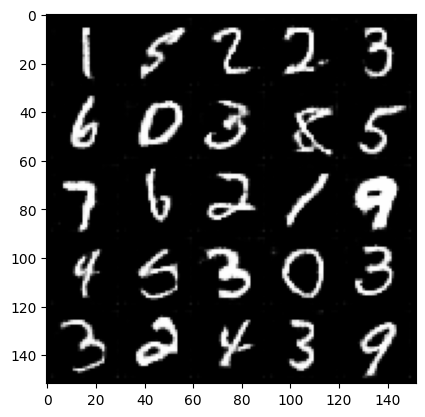

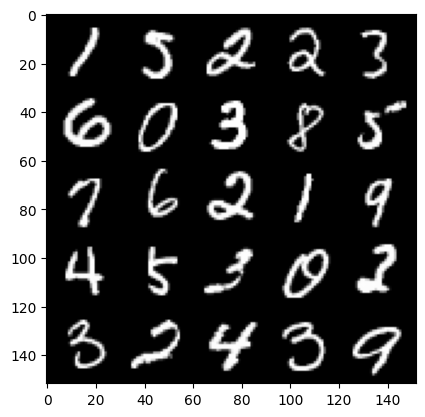

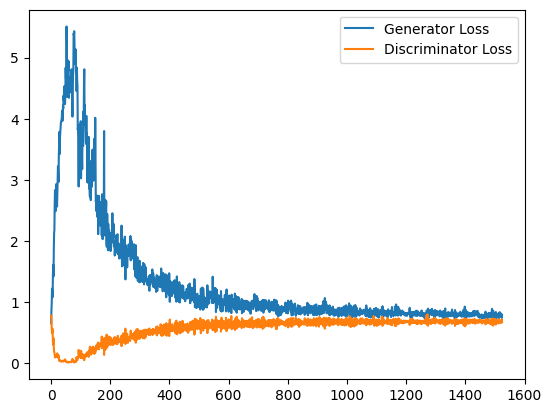

 10%|▉         | 46/469 [00:04<00:35, 11.90it/s]

Epoch 66, step 31000: Generator loss: 0.7756849535703659, discriminator loss: 0.6829208147525787


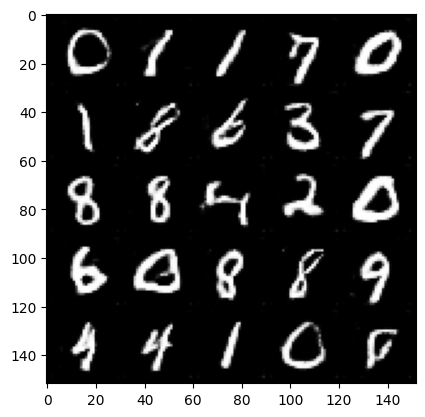

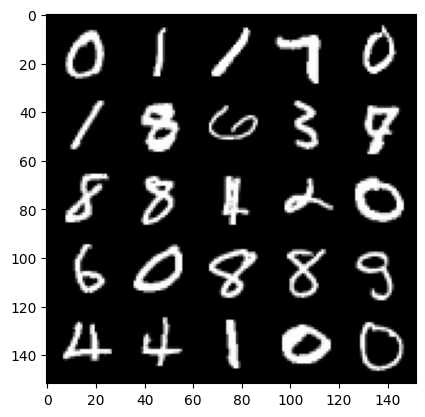

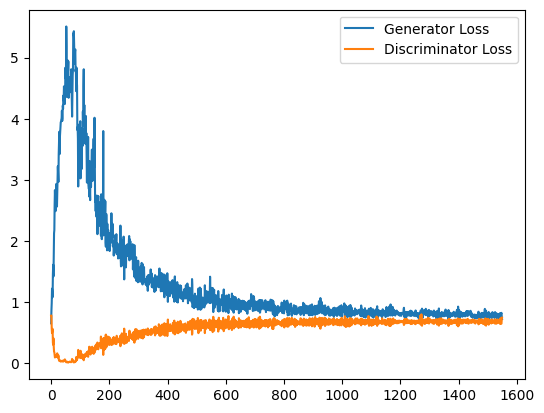

 16%|█▌        | 76/469 [00:06<00:31, 12.51it/s]

Epoch 67, step 31500: Generator loss: 0.8091747808456421, discriminator loss: 0.6803283451795578


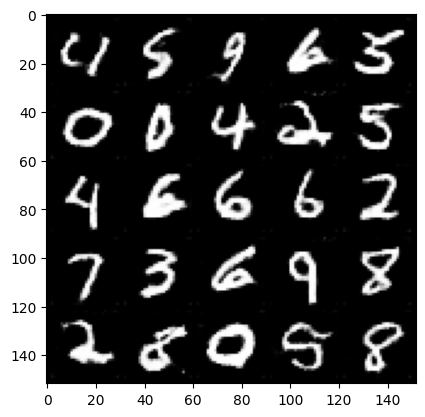

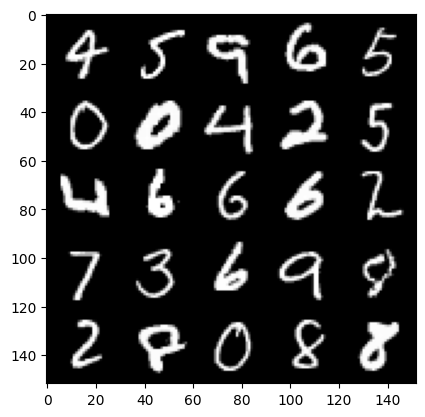

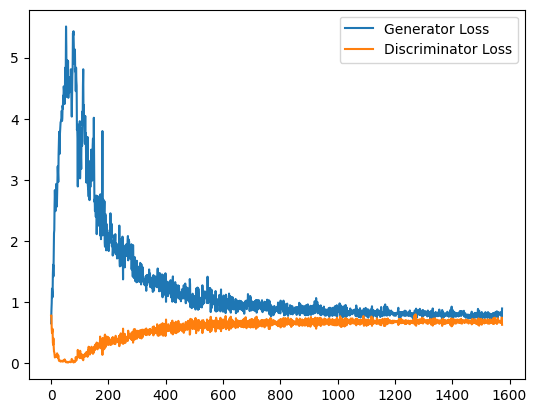

 23%|██▎       | 108/469 [00:09<00:32, 11.03it/s]

Epoch 68, step 32000: Generator loss: 0.7916554809808731, discriminator loss: 0.6777911788225174


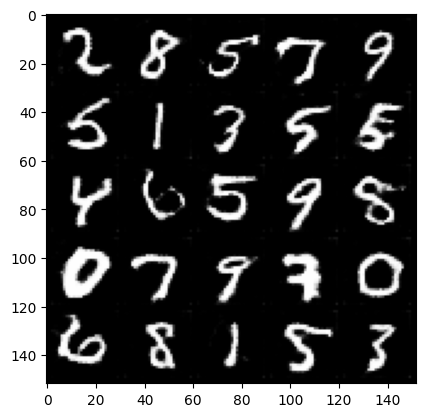

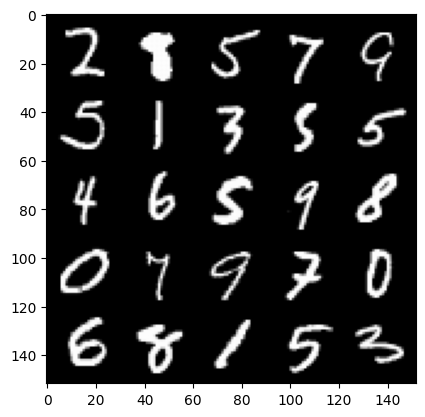

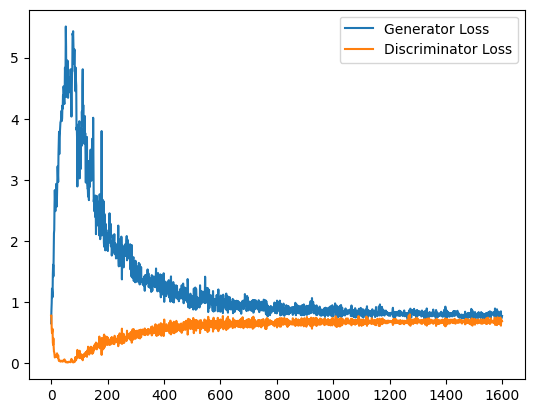

 30%|██▉       | 139/469 [00:12<00:32, 10.04it/s]

Epoch 69, step 32500: Generator loss: 0.7676922161579132, discriminator loss: 0.680742872595787


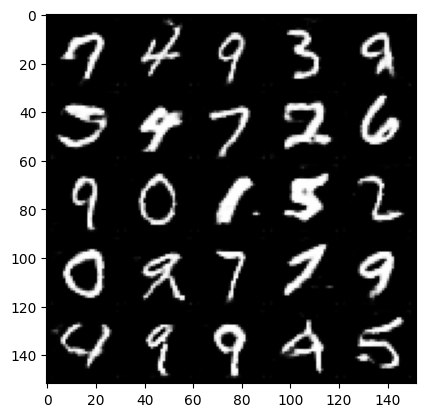

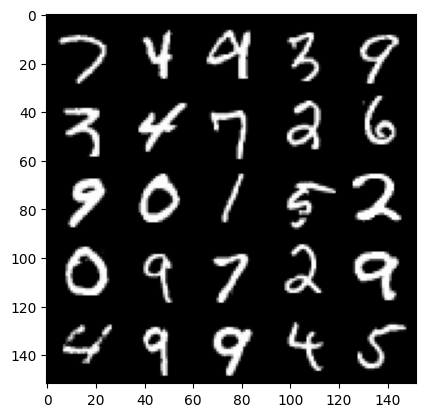

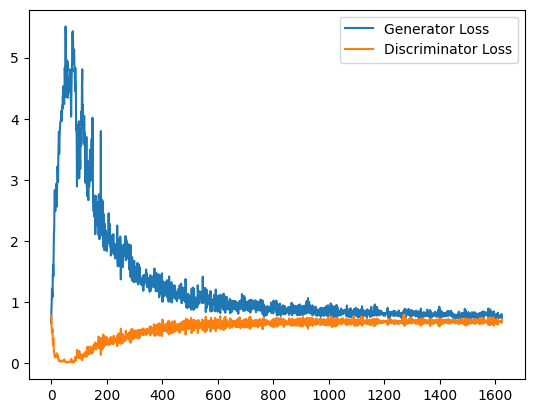

 36%|███▌      | 170/469 [00:15<00:32,  9.25it/s]

Epoch 70, step 33000: Generator loss: 0.7744226188659667, discriminator loss: 0.6819721363782882


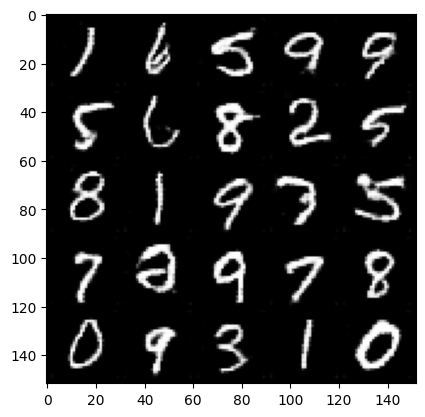

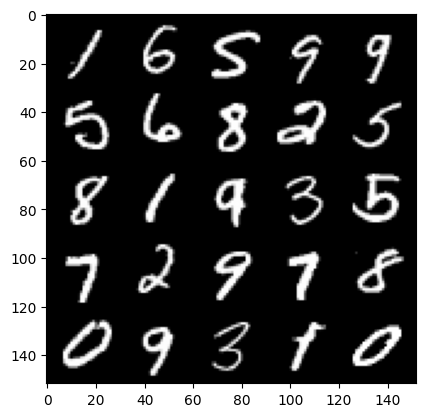

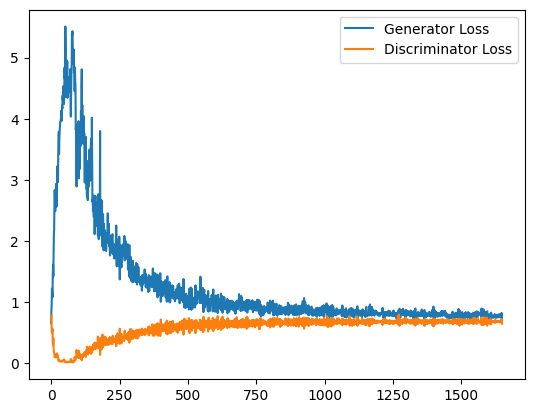

 43%|████▎     | 201/469 [00:17<00:22, 11.84it/s]

Epoch 71, step 33500: Generator loss: 0.7819809002876281, discriminator loss: 0.680628348827362


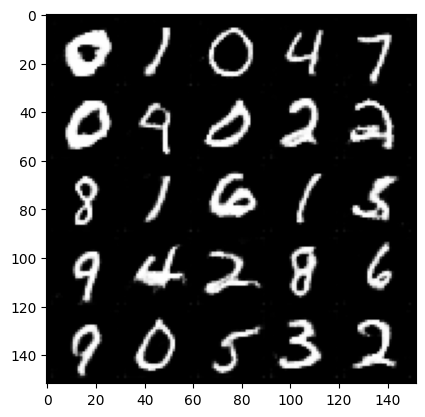

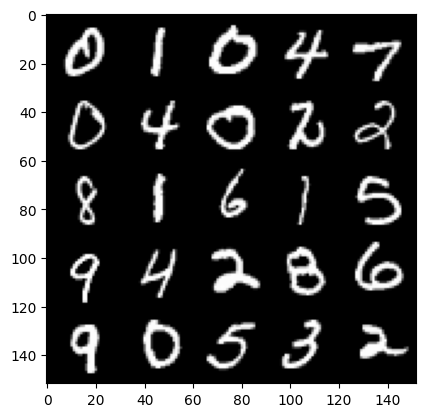

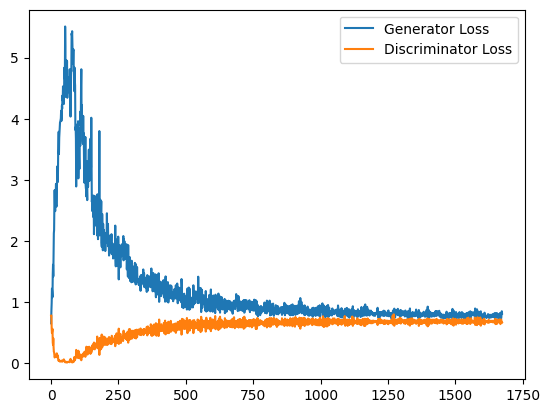

 49%|████▉     | 231/469 [00:19<00:20, 11.59it/s]

Epoch 72, step 34000: Generator loss: 0.7729580298662185, discriminator loss: 0.681250135421753


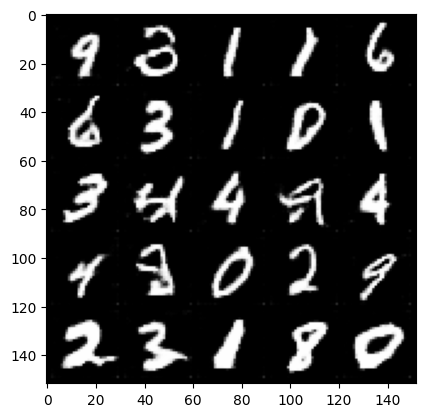

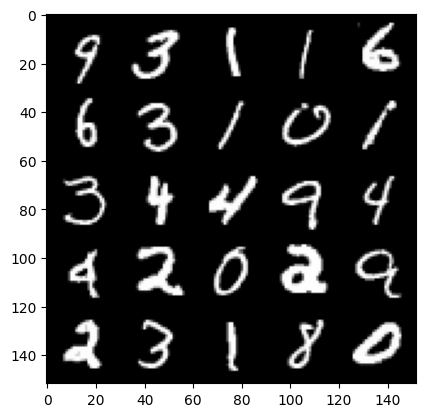

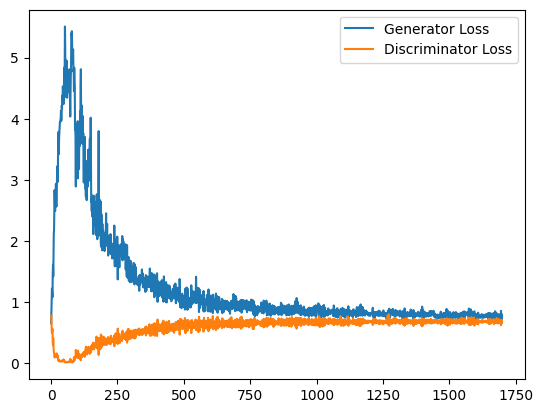

 56%|█████▌    | 263/469 [00:22<00:23,  8.71it/s]

Epoch 73, step 34500: Generator loss: 0.7726434806585312, discriminator loss: 0.6790539788007737


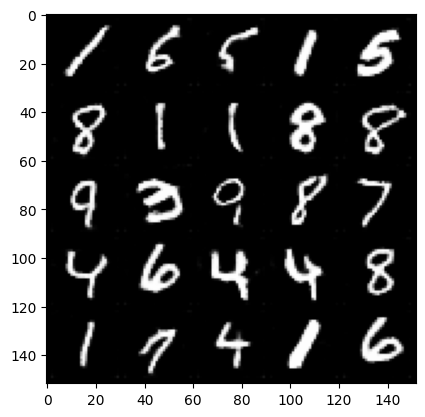

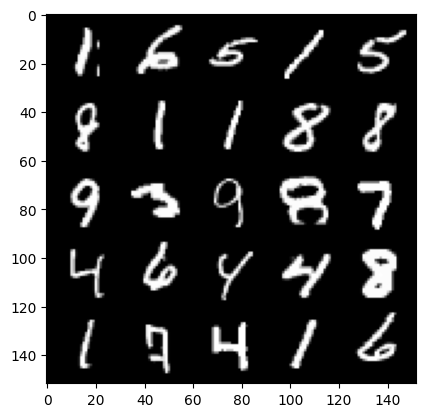

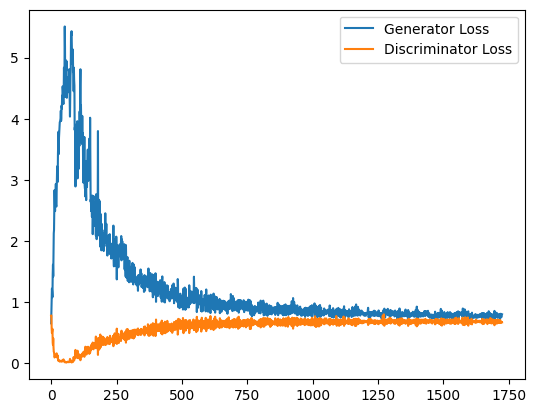

 63%|██████▎   | 294/469 [00:26<00:14, 12.09it/s]

Epoch 74, step 35000: Generator loss: 0.7774178818464279, discriminator loss: 0.6845815007686615


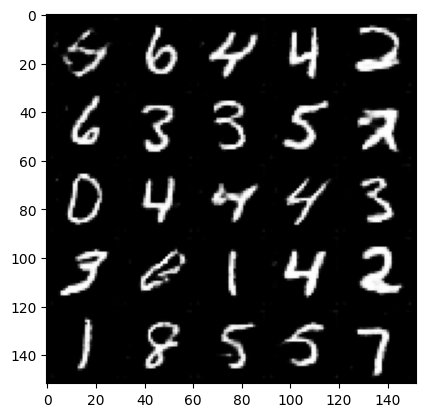

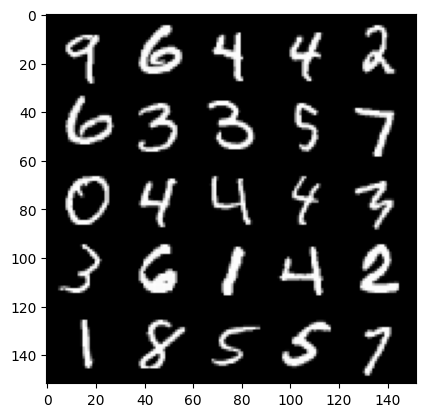

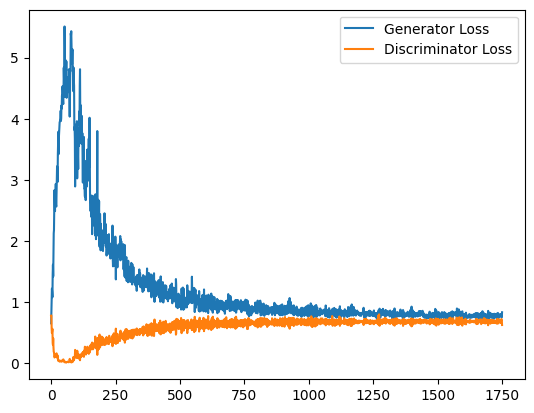

 69%|██████▉   | 324/469 [00:28<00:11, 12.19it/s]

Epoch 75, step 35500: Generator loss: 0.7816032633781433, discriminator loss: 0.6804062473773956


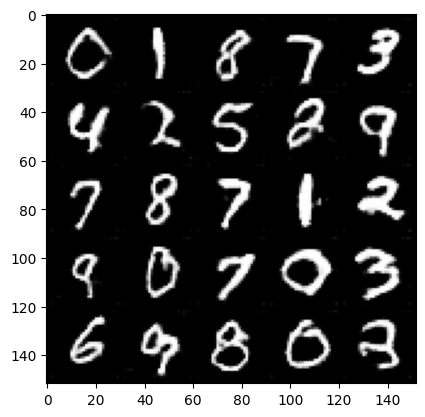

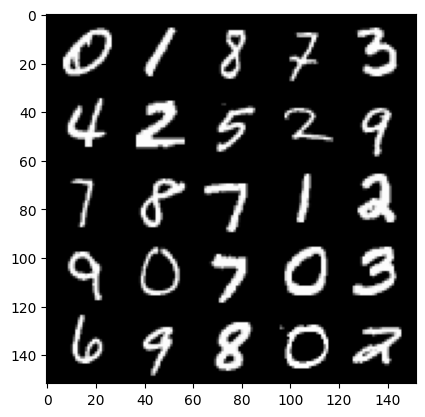

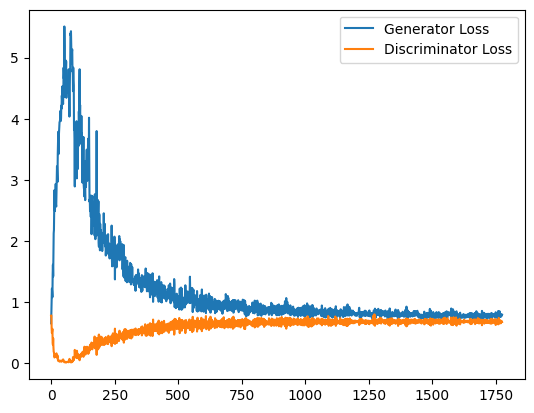

 76%|███████▌  | 356/469 [00:32<00:15,  7.41it/s]

Epoch 76, step 36000: Generator loss: 0.7854640573263169, discriminator loss: 0.6815276316404343


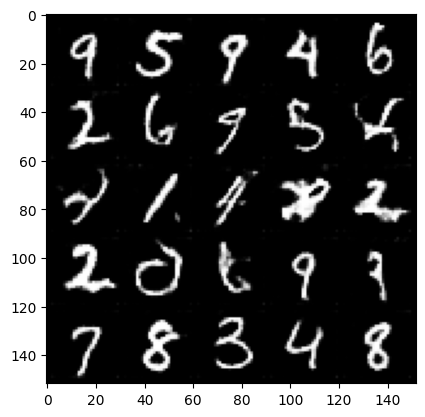

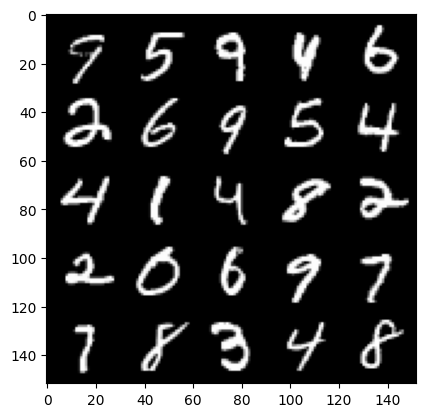

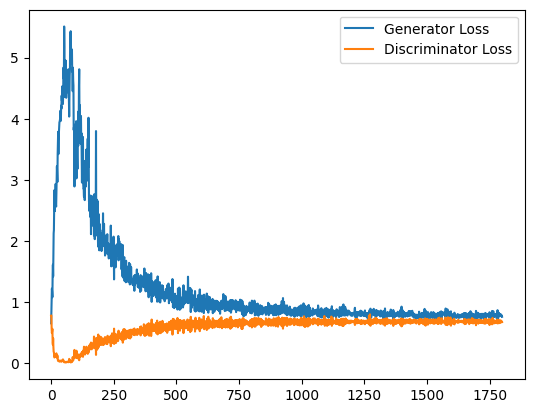

 82%|████████▏ | 385/469 [00:15<00:03, 23.11it/s]

Epoch 77, step 36500: Generator loss: 0.7704545432329177, discriminator loss: 0.6844705423116684


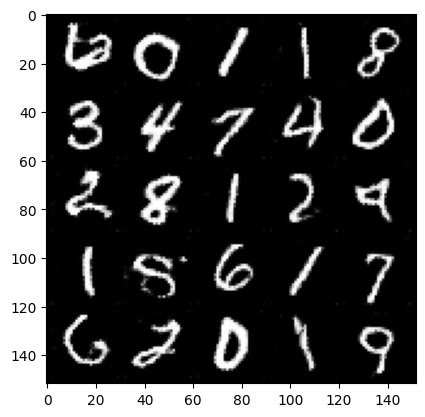

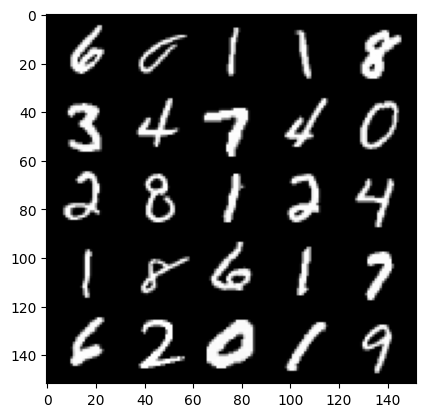

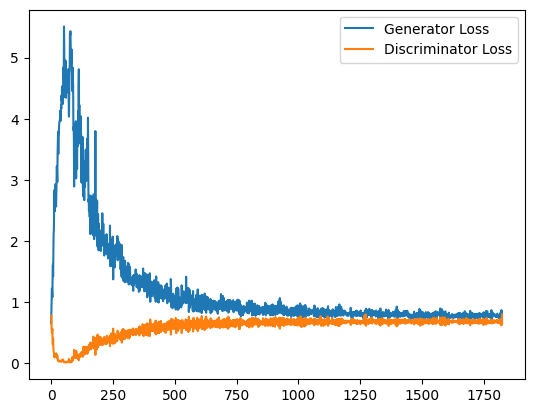

 89%|████████▉ | 418/469 [00:48<00:04, 10.33it/s]

Epoch 78, step 37000: Generator loss: 0.7753926182985306, discriminator loss: 0.6785660661458969


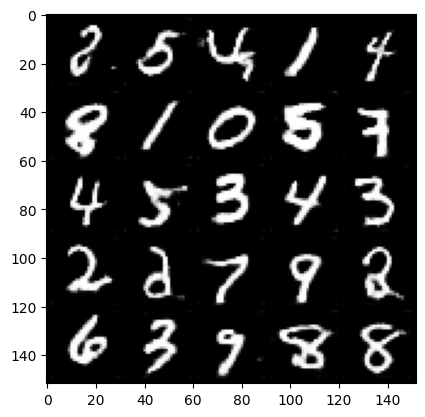

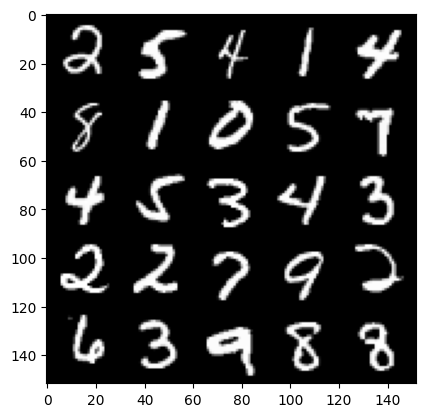

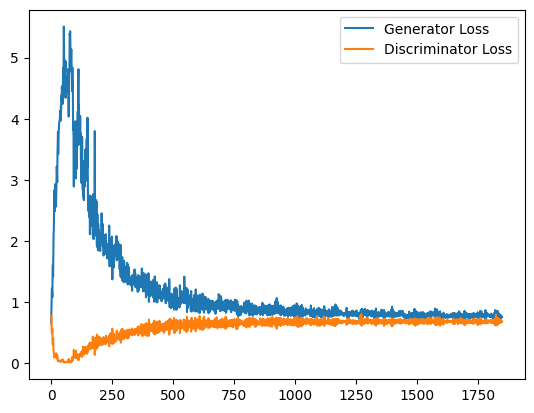

 96%|█████████▌| 449/469 [00:52<00:02,  9.25it/s]

Epoch 79, step 37500: Generator loss: 0.7560459290742874, discriminator loss: 0.6809691410064698


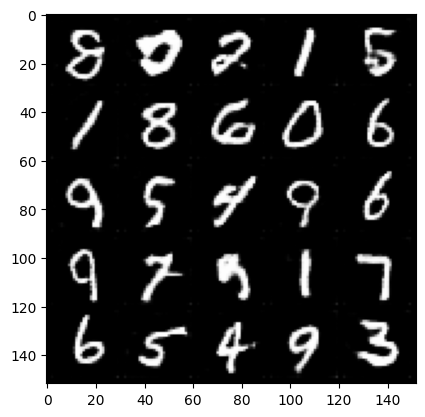

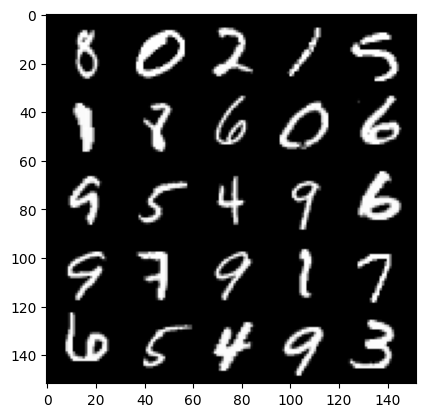

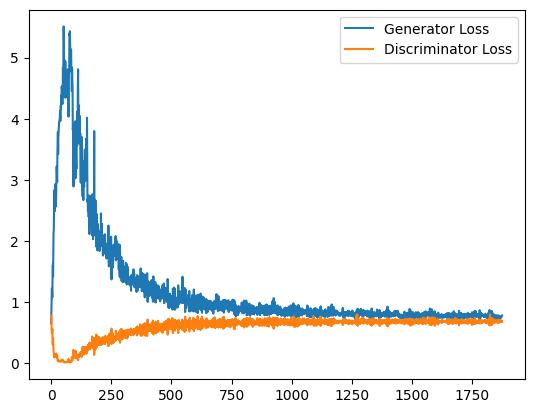

  2%|▏         | 11/469 [00:01<00:50,  9.12it/s]

Epoch 81, step 38000: Generator loss: 0.7714839287996292, discriminator loss: 0.6804760113954544


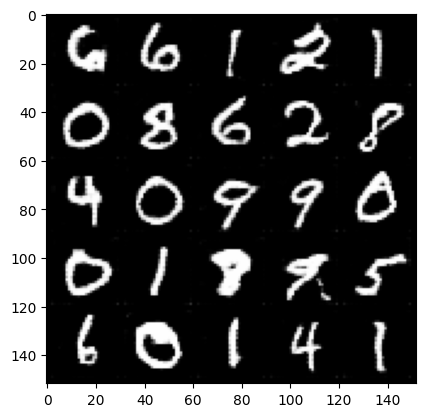

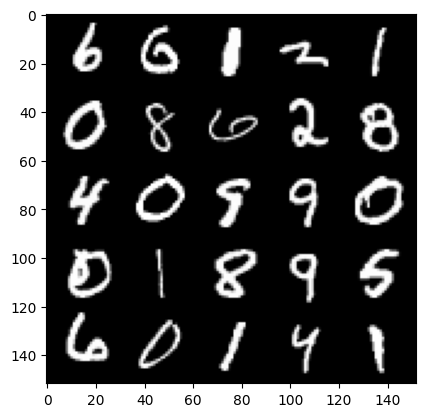

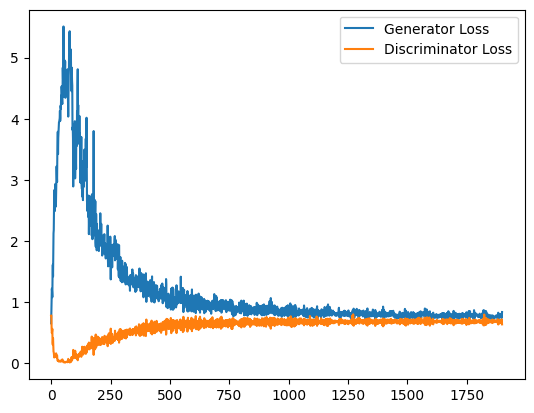

  9%|▉         | 42/469 [00:05<00:51,  8.23it/s]

Epoch 82, step 38500: Generator loss: 0.7935764688253403, discriminator loss: 0.6758429951667786


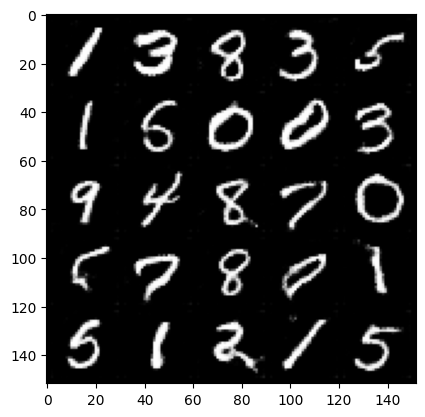

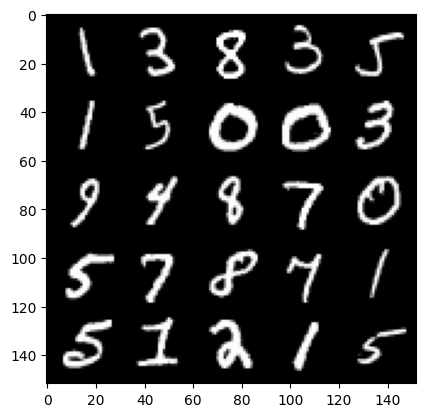

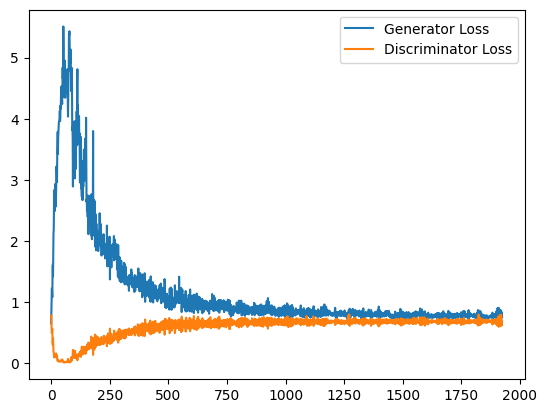

 16%|█▌        | 73/469 [00:07<00:41,  9.44it/s]

Epoch 83, step 39000: Generator loss: 0.7799504735469818, discriminator loss: 0.6852959177494049


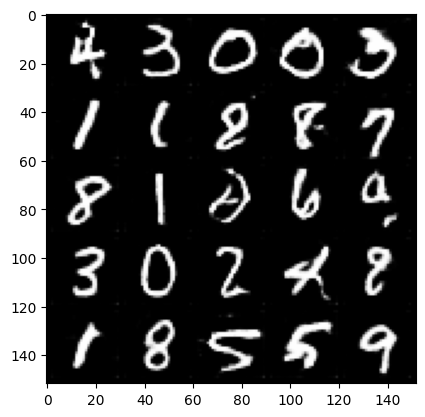

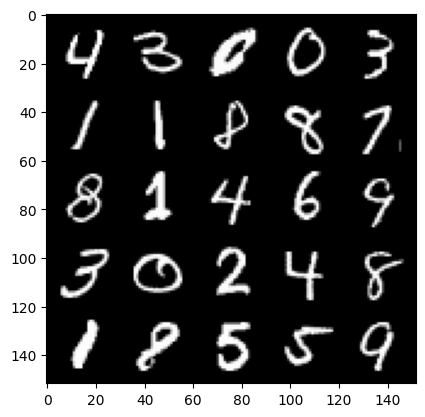

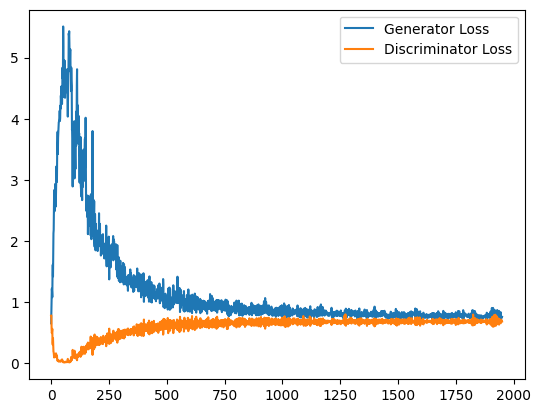

 22%|██▏       | 104/469 [00:12<00:39,  9.30it/s]

Epoch 84, step 39500: Generator loss: 0.7672862886190415, discriminator loss: 0.6831537821292877


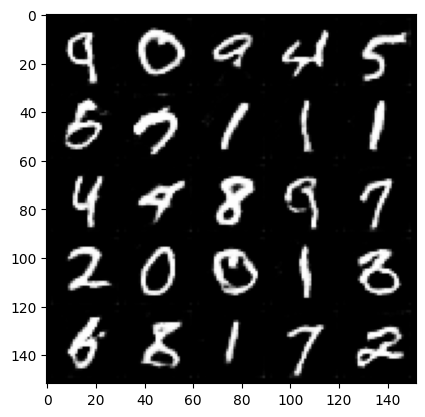

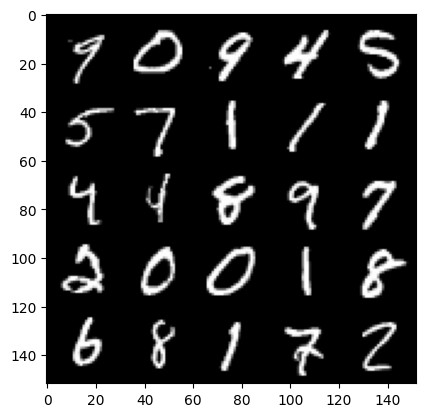

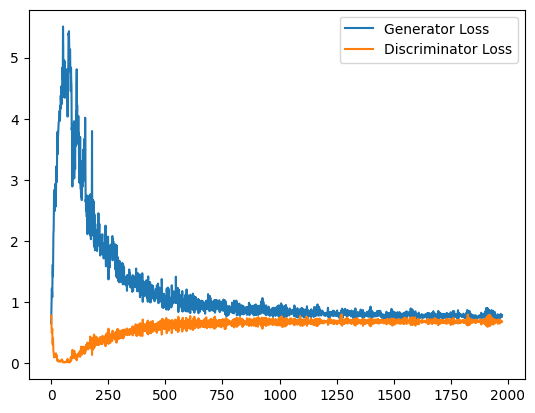

 29%|██▉       | 135/469 [00:15<00:34,  9.67it/s]

Epoch 85, step 40000: Generator loss: 0.7604107553958893, discriminator loss: 0.681270366191864


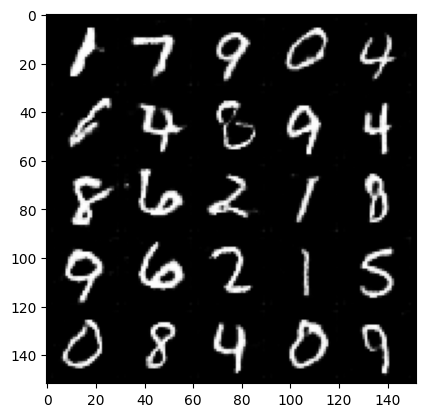

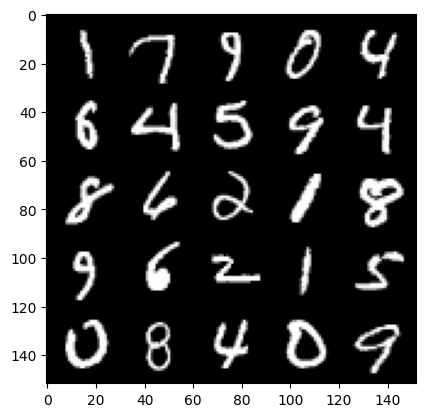

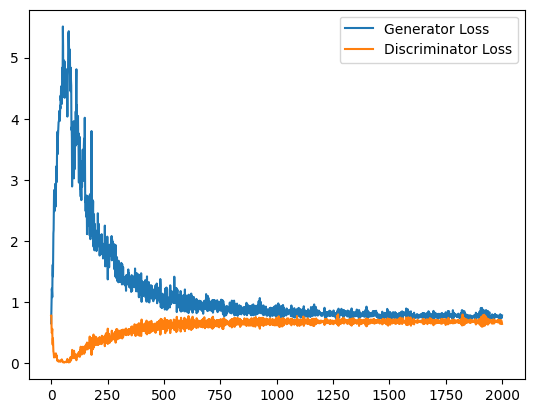

 35%|███▌      | 166/469 [00:20<00:34,  8.83it/s]

Epoch 86, step 40500: Generator loss: 0.7596867973804474, discriminator loss: 0.6820261070728302


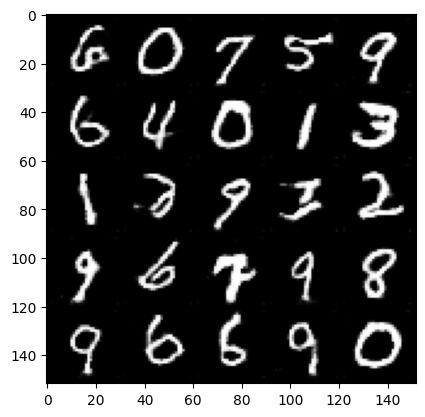

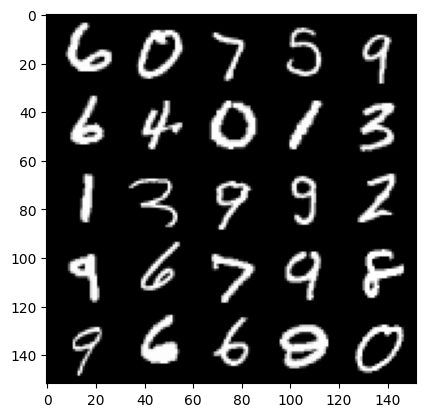

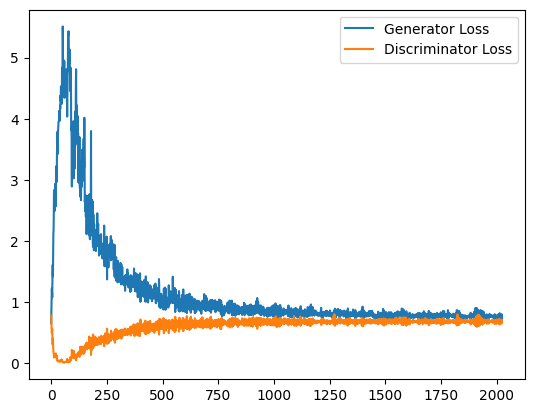

 42%|████▏     | 197/469 [00:23<00:39,  6.85it/s]

Epoch 87, step 41000: Generator loss: 0.7737565016746522, discriminator loss: 0.6790506713390351


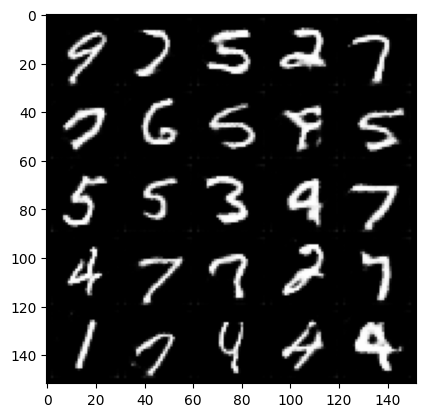

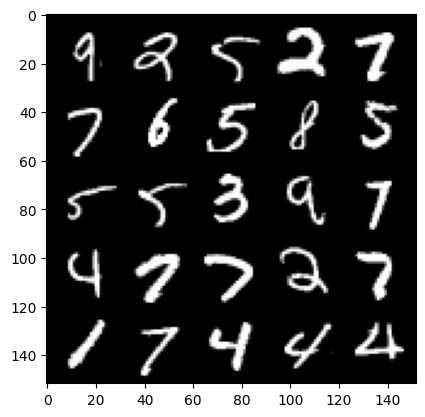

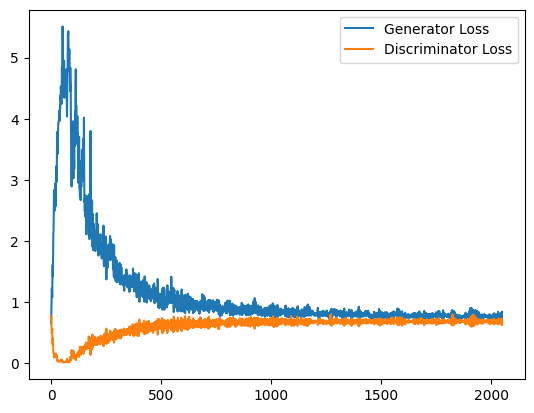

 49%|████▊     | 228/469 [00:28<00:29,  8.17it/s]

Epoch 88, step 41500: Generator loss: 0.7827157046794891, discriminator loss: 0.6769784841537475


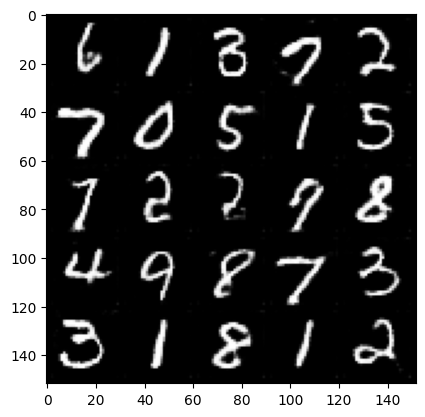

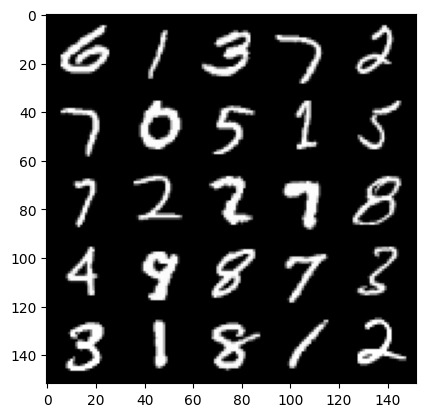

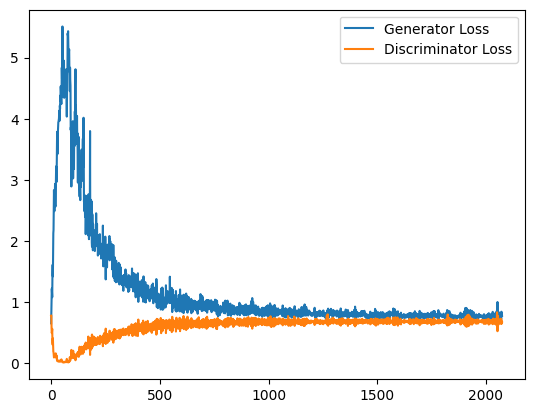

 55%|█████▍    | 256/469 [00:21<00:07, 27.95it/s]

Epoch 89, step 42000: Generator loss: 0.7832292783260345, discriminator loss: 0.6829205623865128


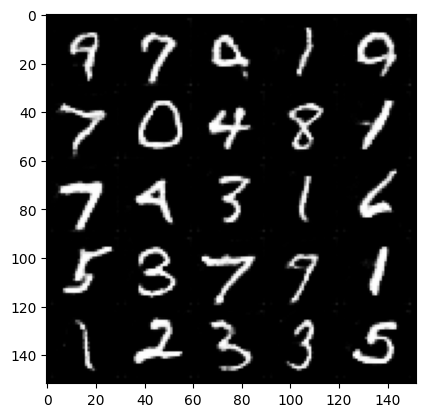

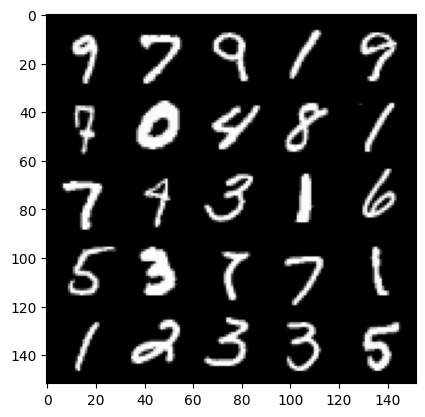

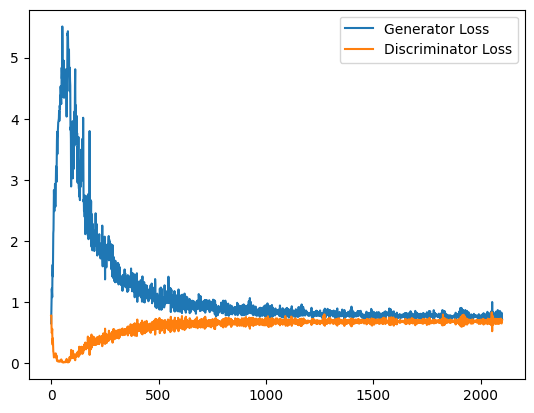

 62%|██████▏   | 290/469 [00:33<00:24,  7.24it/s]

Epoch 90, step 42500: Generator loss: 0.7622839369773865, discriminator loss: 0.6828871556520462


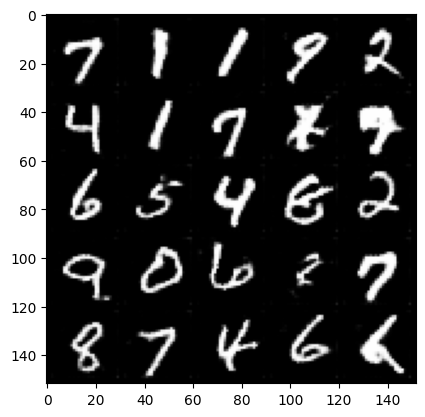

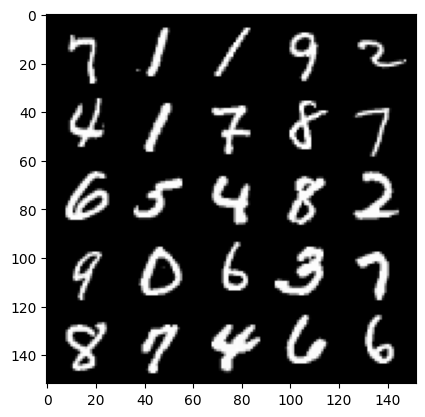

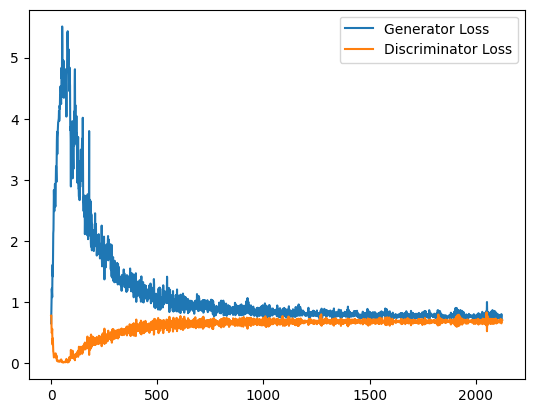

 68%|██████▊   | 321/469 [00:37<00:17,  8.47it/s]

Epoch 91, step 43000: Generator loss: 0.7617555874586105, discriminator loss: 0.6799091064929962


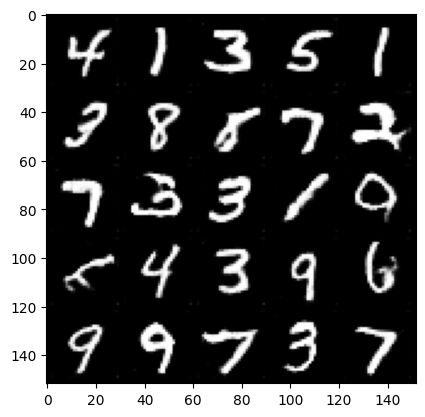

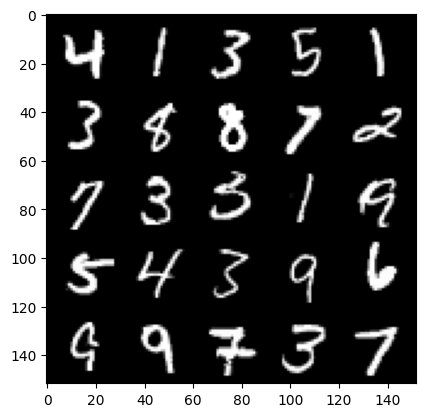

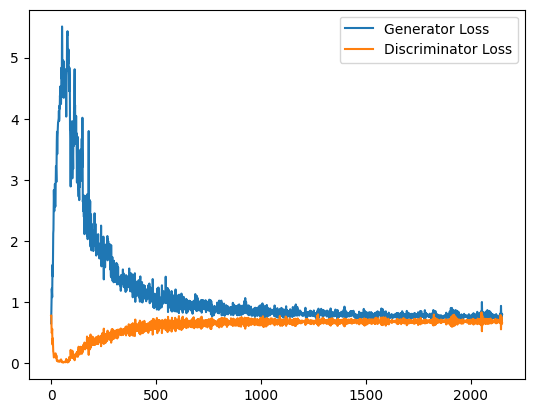

 75%|███████▌  | 352/469 [00:23<00:09, 12.87it/s]

Epoch 92, step 43500: Generator loss: 0.7559300441741943, discriminator loss: 0.6852101442813874


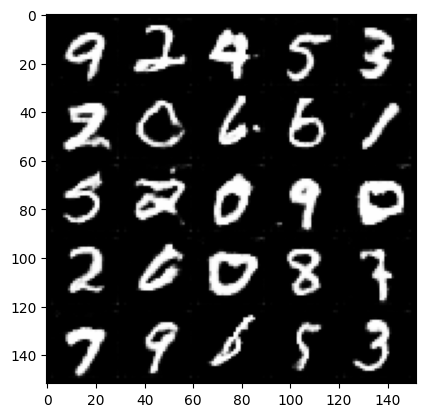

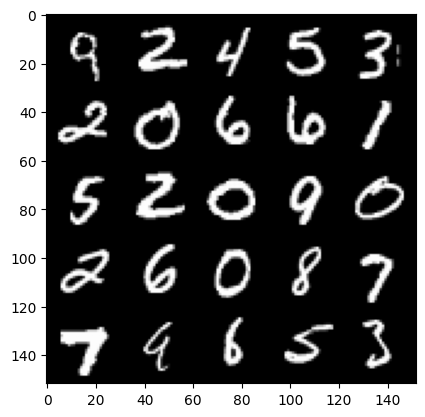

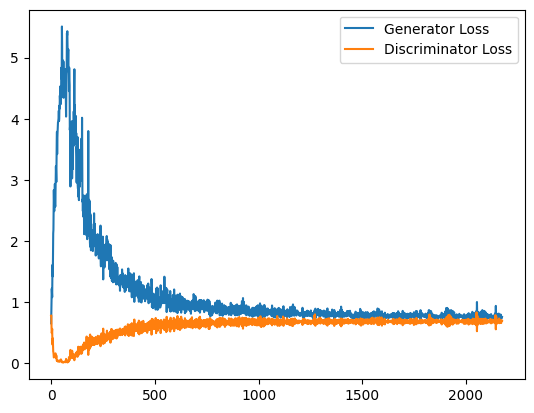

 81%|████████▏ | 382/469 [00:34<00:06, 12.66it/s]

Epoch 93, step 44000: Generator loss: 0.7616342700719834, discriminator loss: 0.6802167630195618


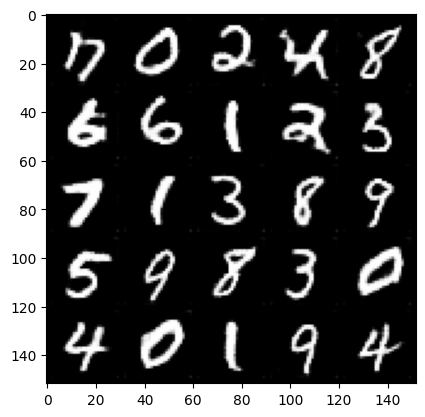

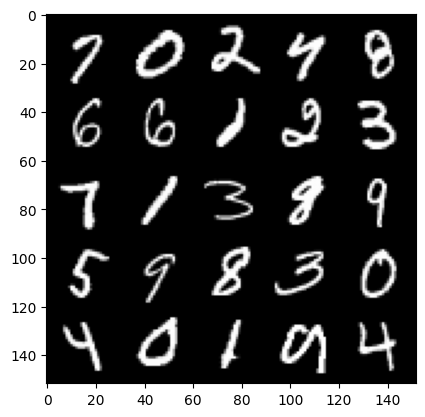

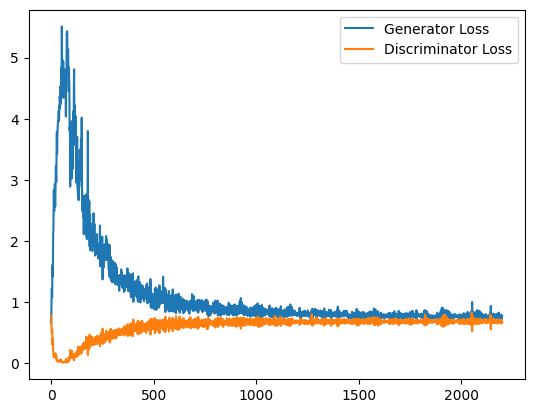

 88%|████████▊ | 413/469 [00:36<00:05, 11.04it/s]

Epoch 94, step 44500: Generator loss: 0.7464289712905884, discriminator loss: 0.684843825340271


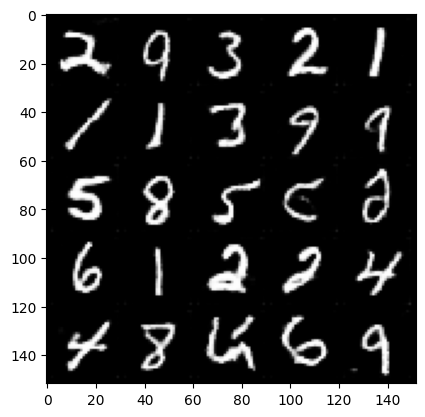

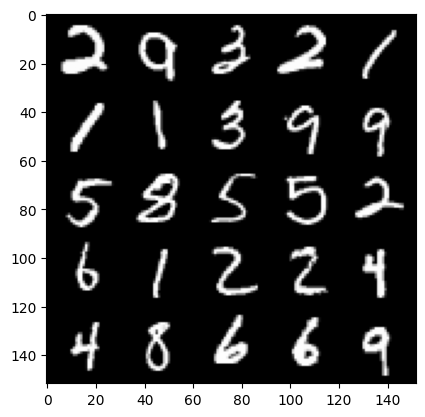

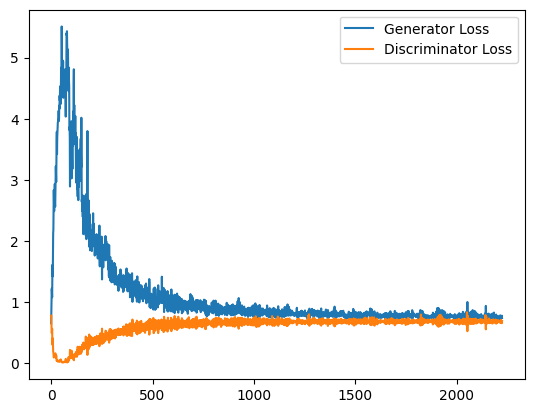

 95%|█████████▍| 444/469 [00:38<00:01, 13.02it/s]

Epoch 95, step 45000: Generator loss: 0.755617373585701, discriminator loss: 0.6830543767213821


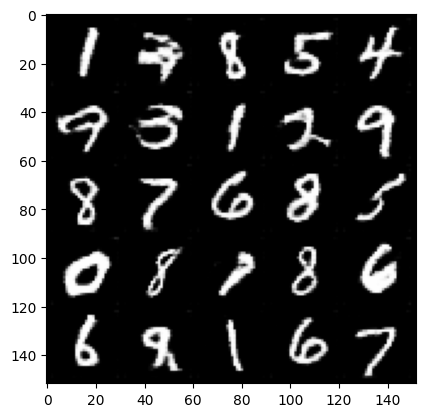

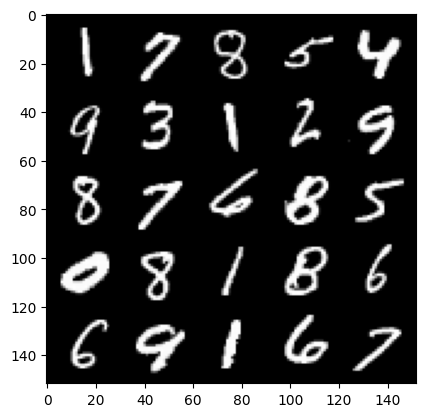

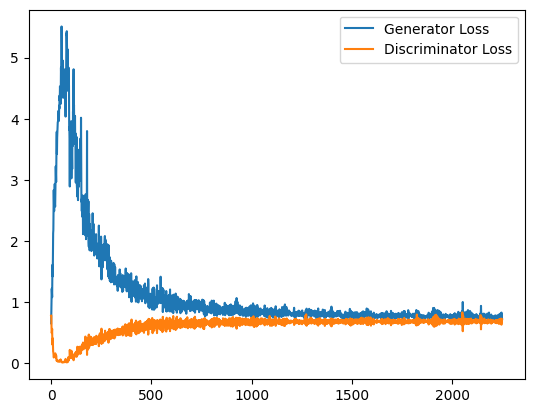

  1%|▏         | 6/469 [00:00<00:46,  9.93it/s]

Epoch 97, step 45500: Generator loss: 0.7592366642951965, discriminator loss: 0.6820328032970429


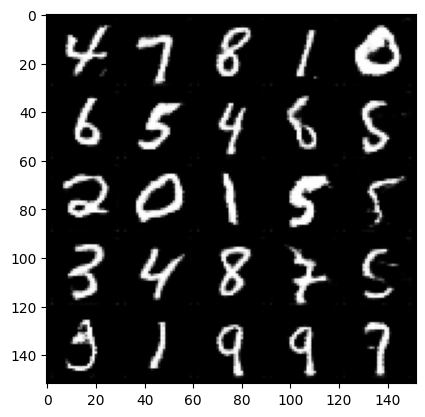

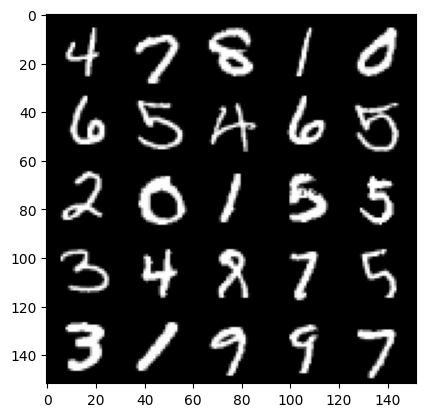

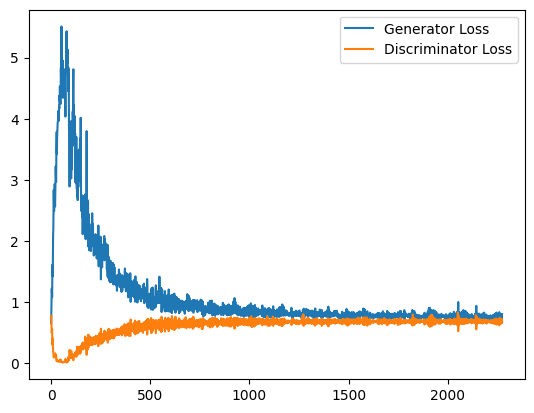

  8%|▊         | 37/469 [00:03<00:44,  9.81it/s]

Epoch 98, step 46000: Generator loss: 0.7553002744913101, discriminator loss: 0.6843549859523773


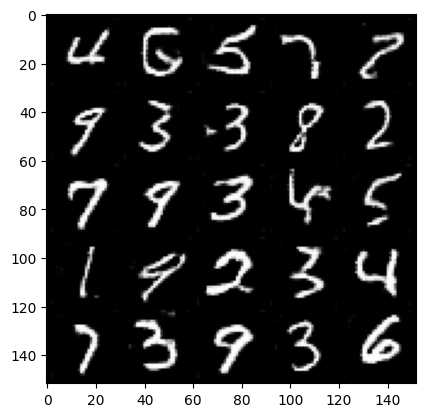

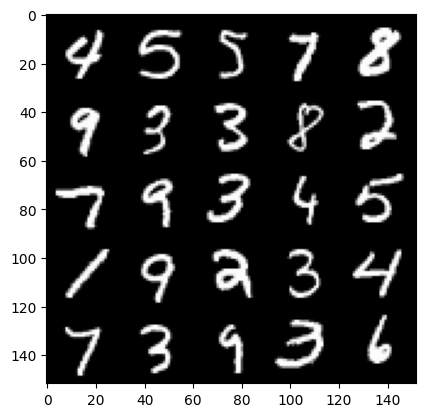

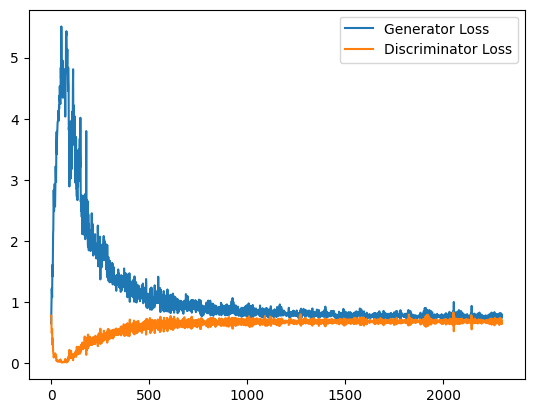

 15%|█▍        | 69/469 [00:06<00:31, 12.53it/s]

Epoch 99, step 46500: Generator loss: 0.7612333726882935, discriminator loss: 0.6828847060203552


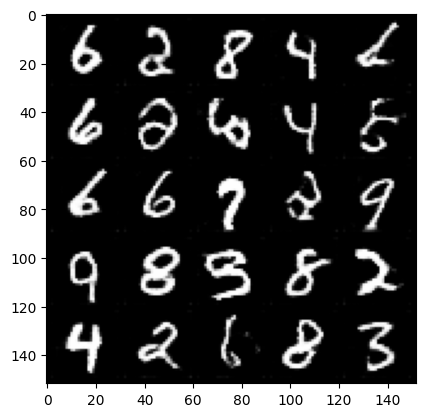

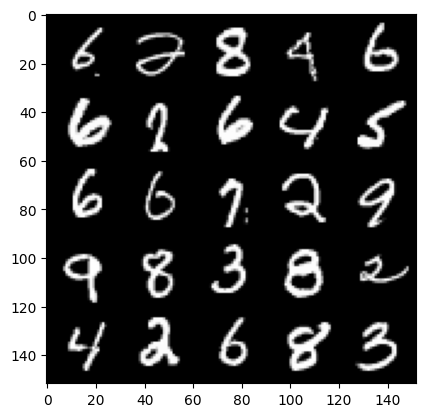

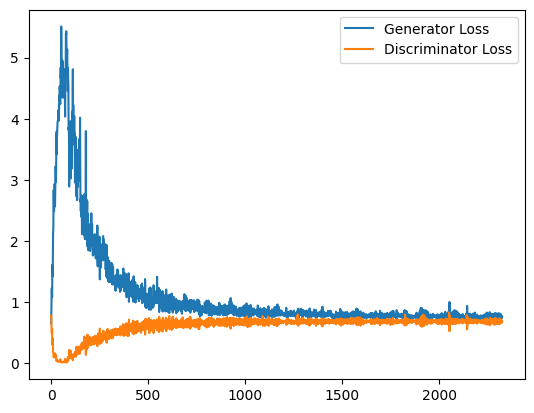

 21%|██        | 99/469 [00:08<00:31, 11.67it/s]

Epoch 100, step 47000: Generator loss: 0.7613901190757751, discriminator loss: 0.6788745613098145


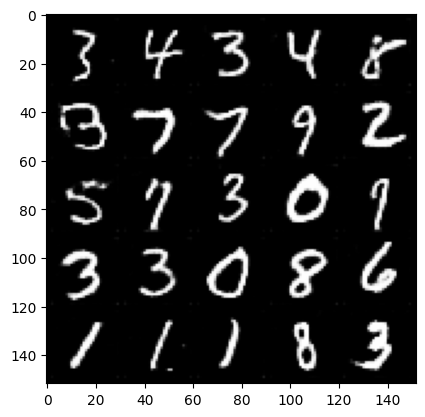

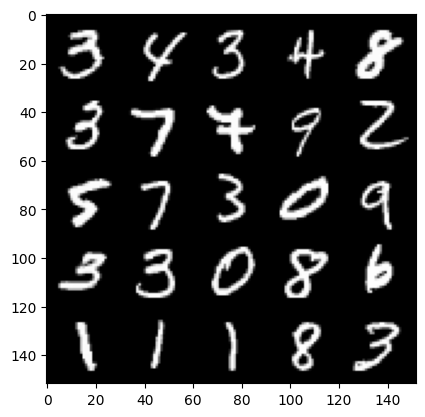

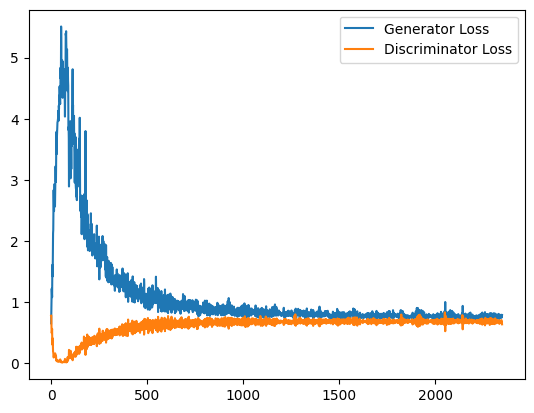

 28%|██▊       | 130/469 [00:11<00:43,  7.72it/s]

Epoch 101, step 47500: Generator loss: 0.7665811488628388, discriminator loss: 0.6829676370620728


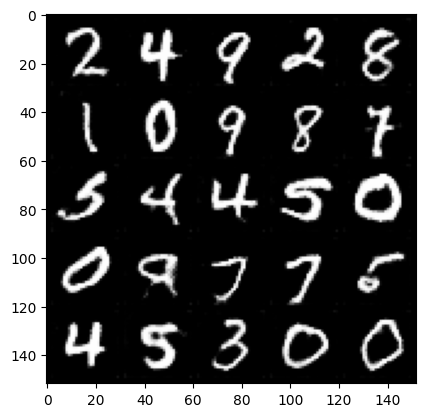

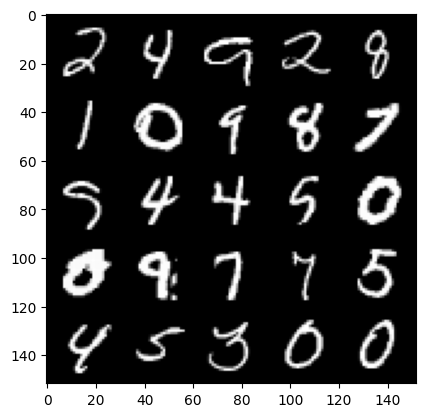

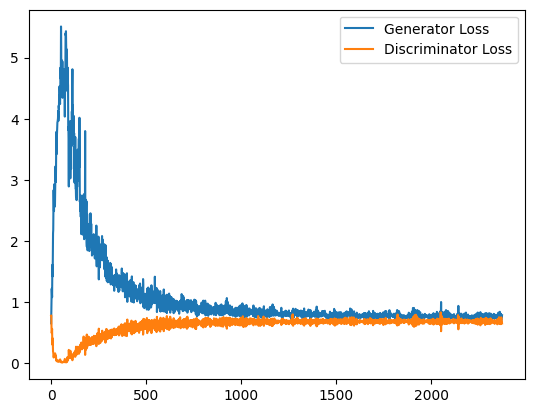

 34%|███▍      | 161/469 [00:13<00:24, 12.64it/s]

Epoch 102, step 48000: Generator loss: 0.755635505437851, discriminator loss: 0.6859630814790726


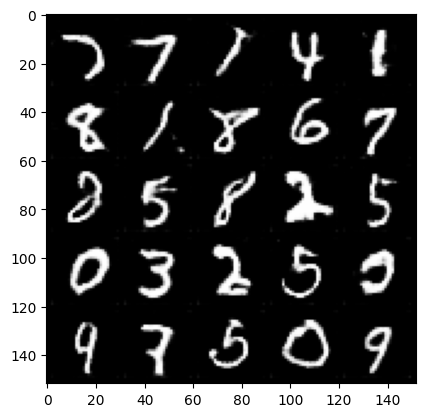

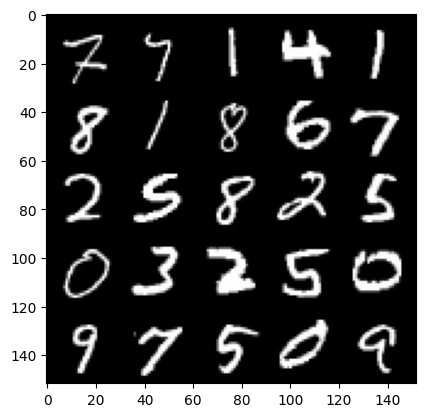

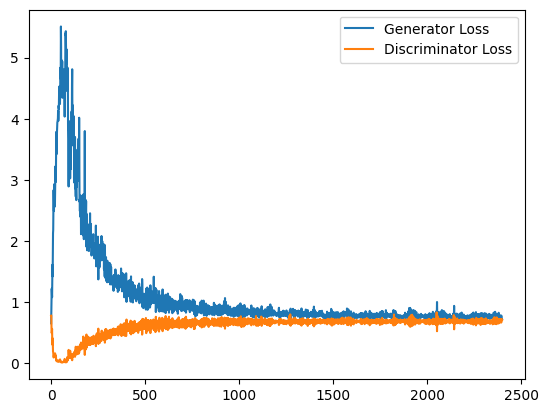

 41%|████      | 192/469 [00:16<00:23, 11.59it/s]

Epoch 103, step 48500: Generator loss: 0.7557113968133926, discriminator loss: 0.6810367621183395


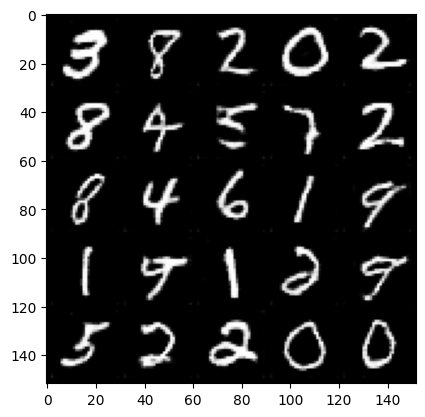

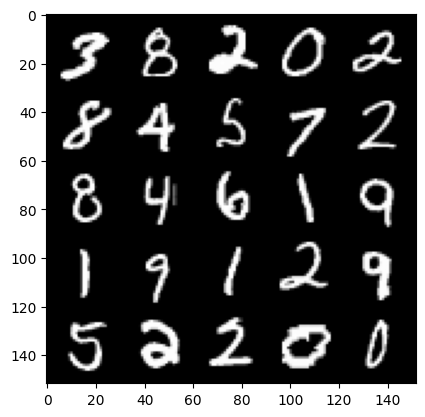

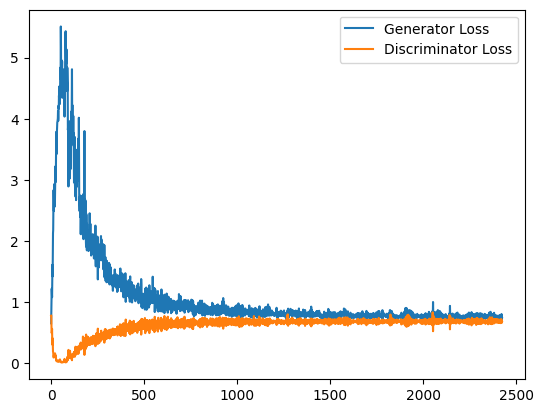

 48%|████▊     | 224/469 [00:19<00:29,  8.42it/s]

Epoch 104, step 49000: Generator loss: 0.7691408048868179, discriminator loss: 0.6784660252332687


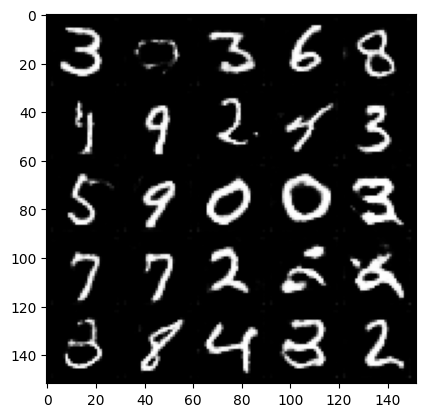

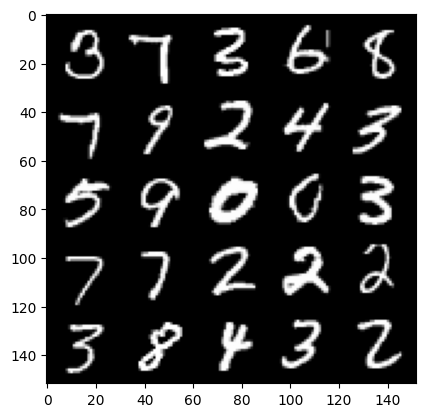

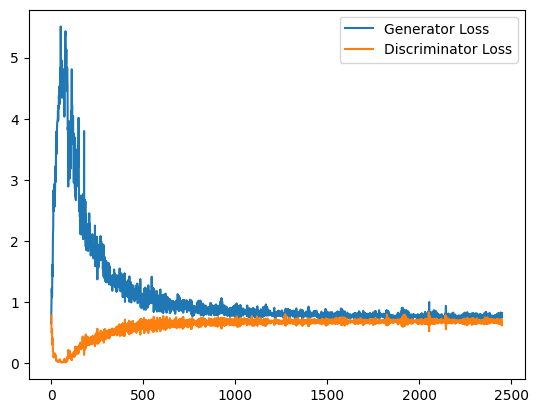

 54%|█████▍    | 255/469 [00:22<00:18, 11.65it/s]

Epoch 105, step 49500: Generator loss: 0.753171097278595, discriminator loss: 0.6840521278381347


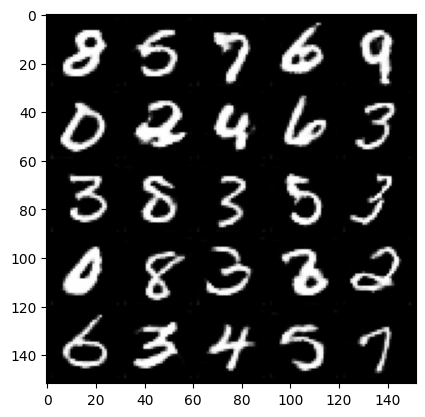

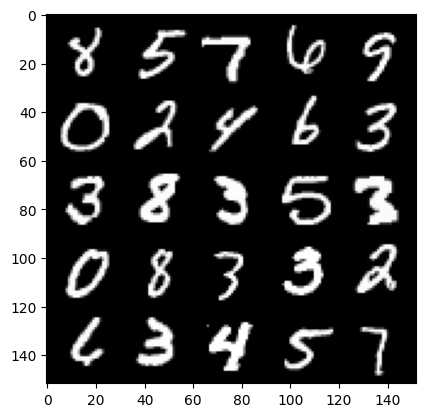

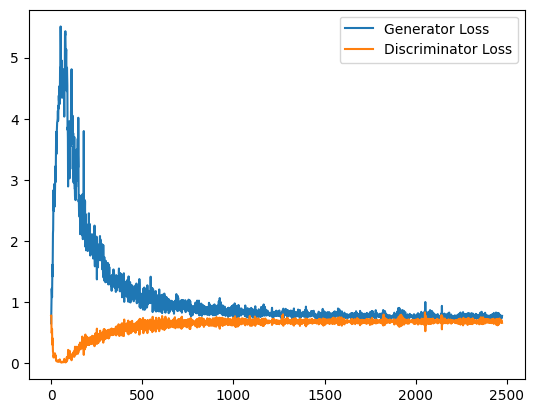

 61%|██████    | 286/469 [00:25<00:16, 11.24it/s]

Epoch 106, step 50000: Generator loss: 0.7473114860057831, discriminator loss: 0.6837035796642303


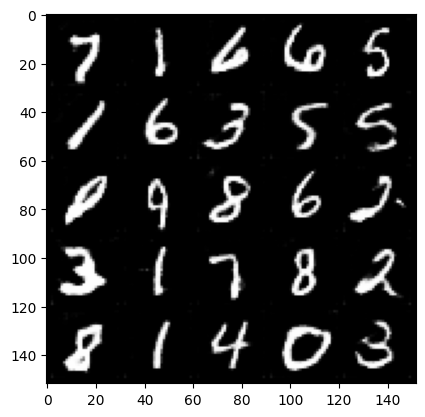

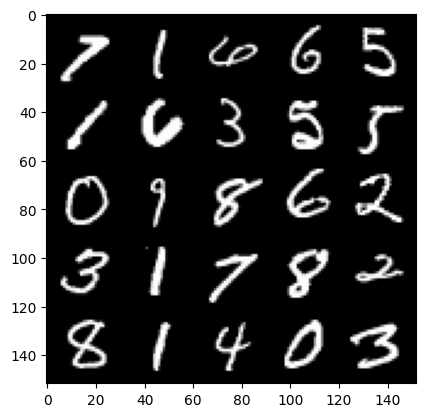

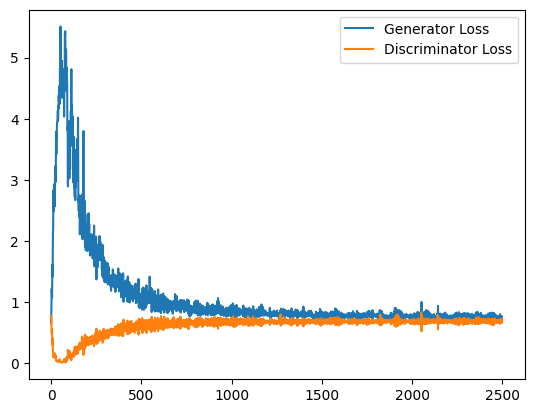

 68%|██████▊   | 317/469 [00:27<00:13, 11.61it/s]

Epoch 107, step 50500: Generator loss: 0.7664516645669938, discriminator loss: 0.6795854990482331


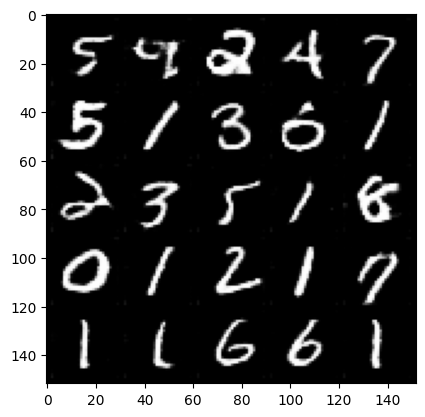

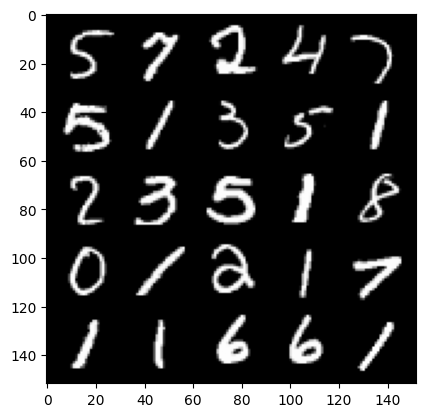

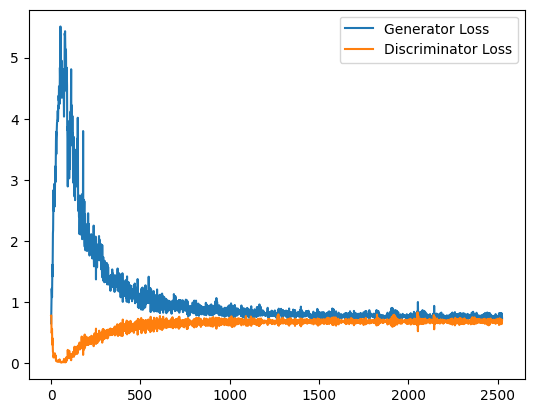

 74%|███████▍  | 348/469 [00:29<00:10, 11.03it/s]

Epoch 108, step 51000: Generator loss: 0.7703978271484375, discriminator loss: 0.6779613231420517


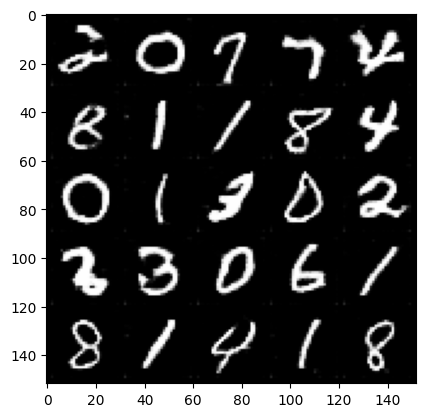

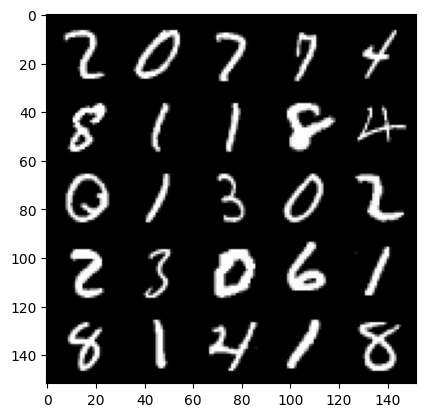

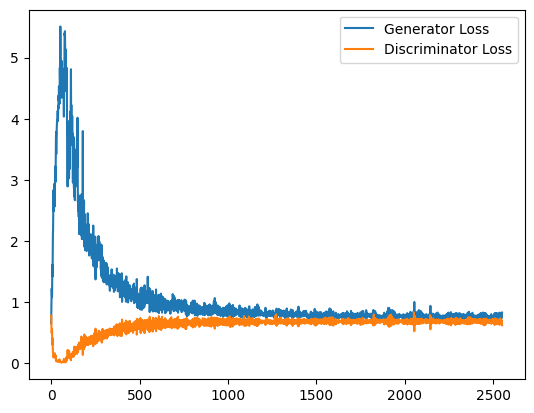

 81%|████████  | 379/469 [00:32<00:07, 12.18it/s]

Epoch 109, step 51500: Generator loss: 0.7517496571540833, discriminator loss: 0.6850244942903518


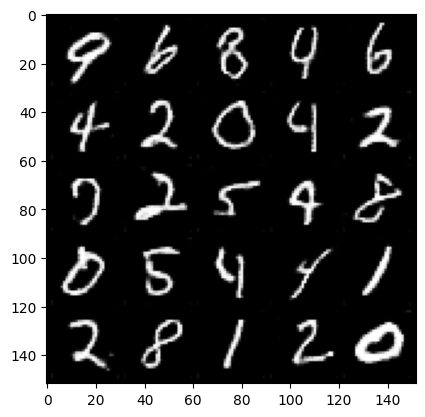

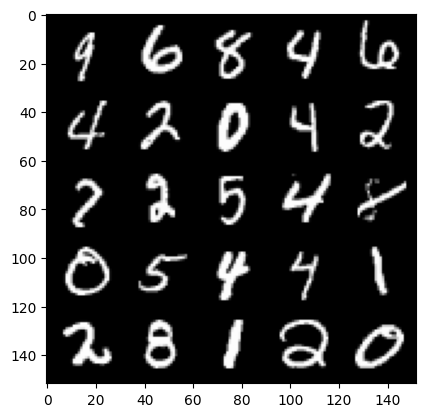

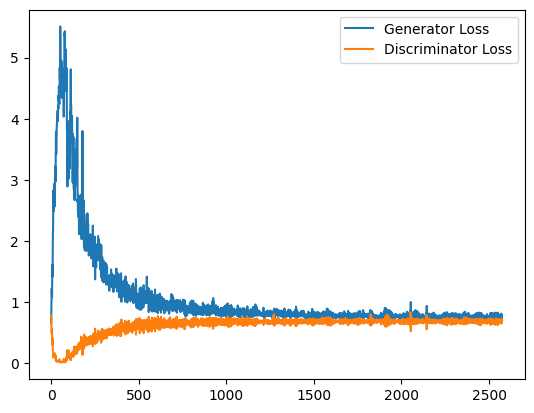

 87%|████████▋ | 410/469 [00:35<00:04, 12.48it/s]

Epoch 110, step 52000: Generator loss: 0.7443364665508271, discriminator loss: 0.6855784398317337


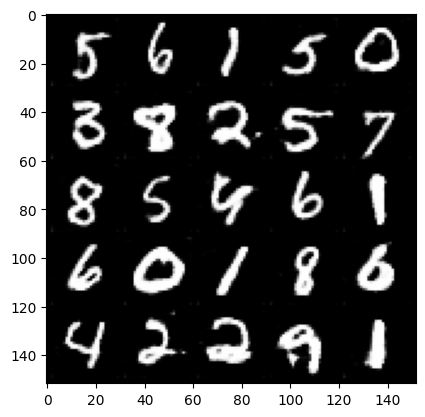

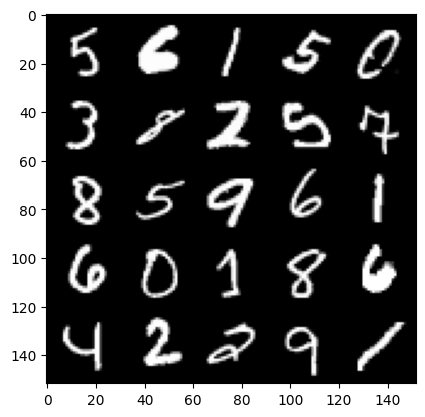

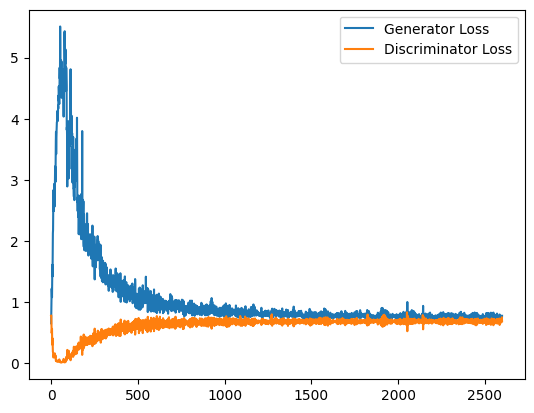

 94%|█████████▍| 440/469 [00:38<00:02, 11.71it/s]

Epoch 111, step 52500: Generator loss: 0.7609972275495529, discriminator loss: 0.6796965829133987


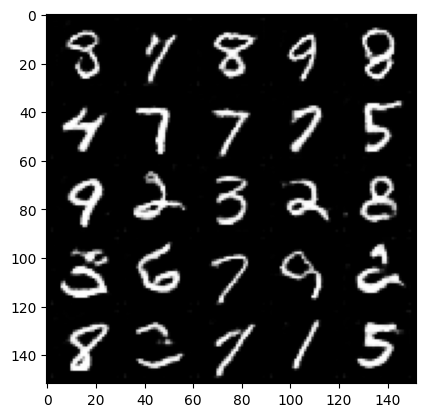

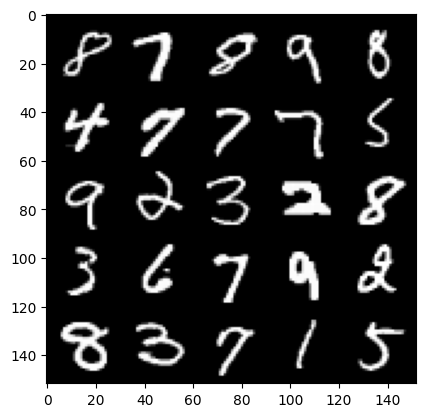

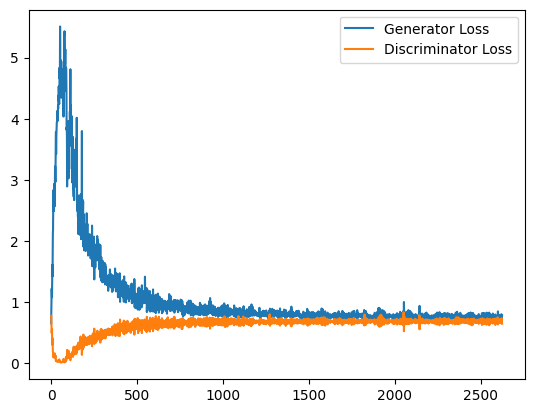

  1%|          | 3/469 [00:00<00:54,  8.49it/s]

Epoch 113, step 53000: Generator loss: 0.7502492533922196, discriminator loss: 0.6801402595043182


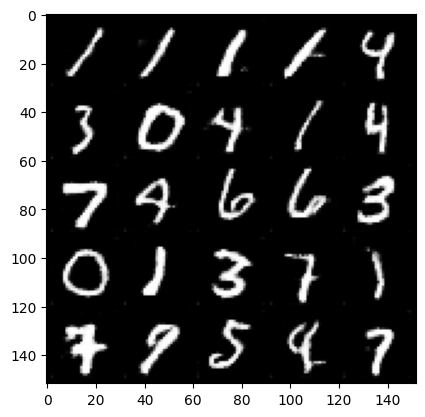

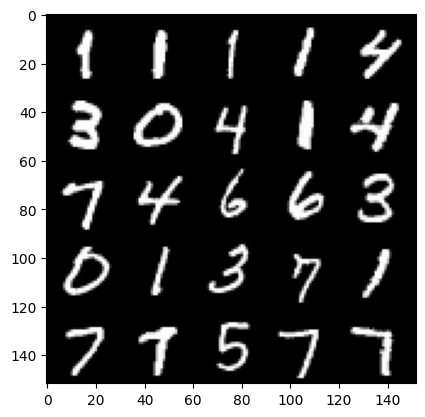

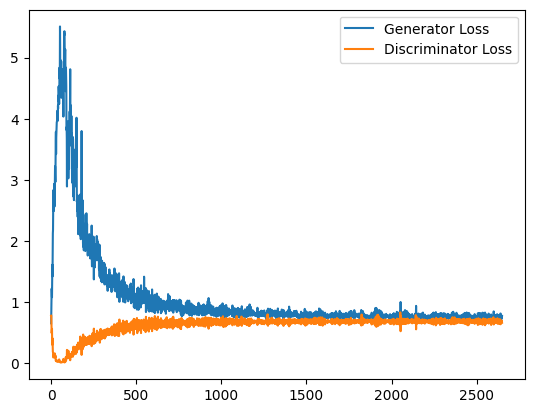

  7%|▋         | 34/469 [00:02<00:35, 12.40it/s]

Epoch 114, step 53500: Generator loss: 0.7539107360839844, discriminator loss: 0.6798736073970795


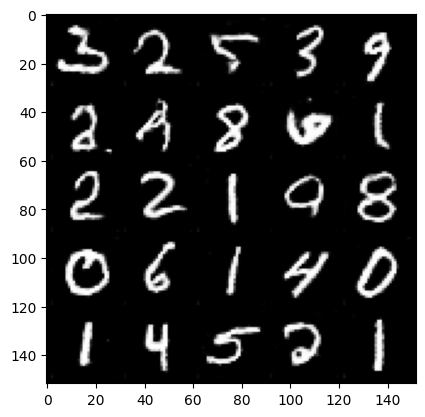

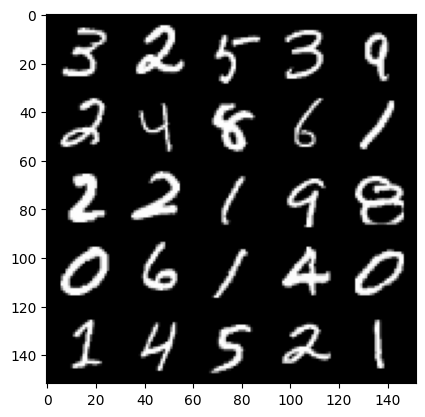

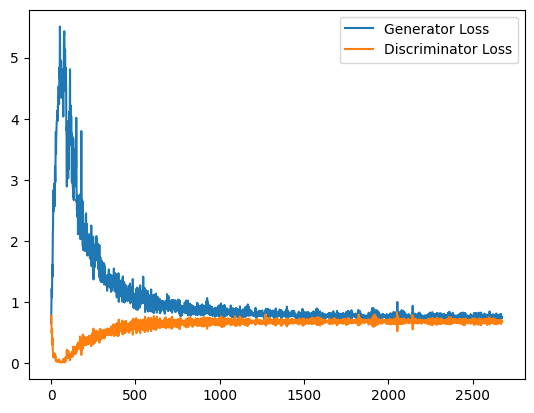

 14%|█▍        | 65/469 [00:05<00:33, 12.15it/s]

Epoch 115, step 54000: Generator loss: 0.7513773691654205, discriminator loss: 0.6831571586132049


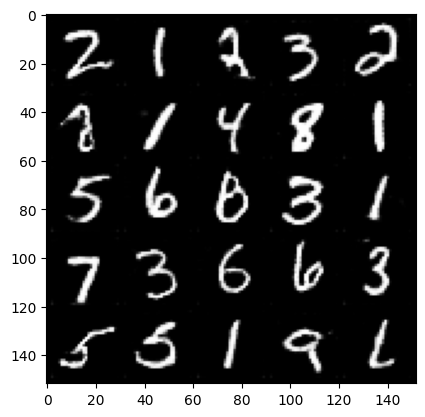

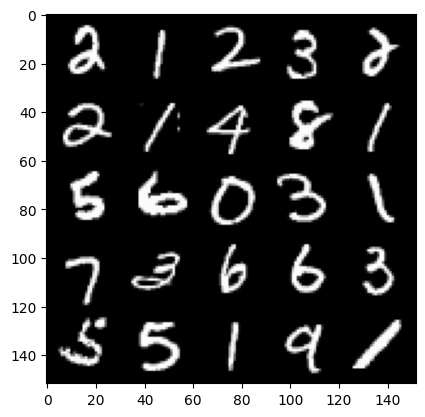

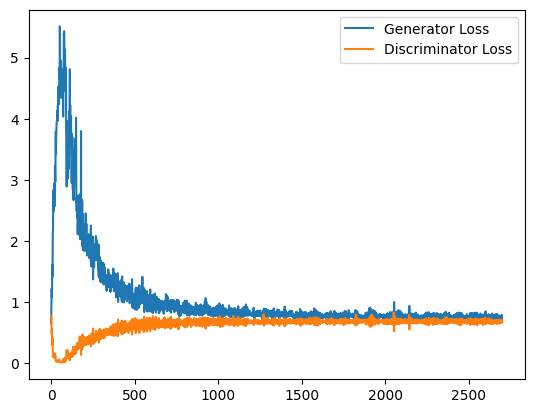

 20%|██        | 96/469 [00:08<00:28, 13.02it/s]

Epoch 116, step 54500: Generator loss: 0.7512999016046524, discriminator loss: 0.681651776432991


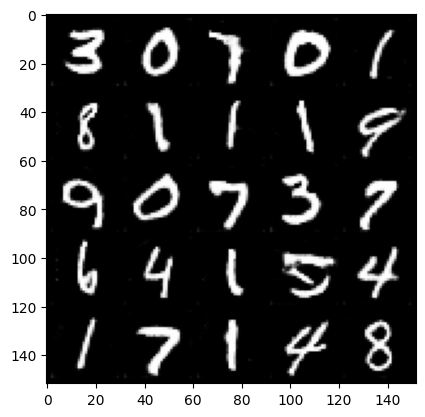

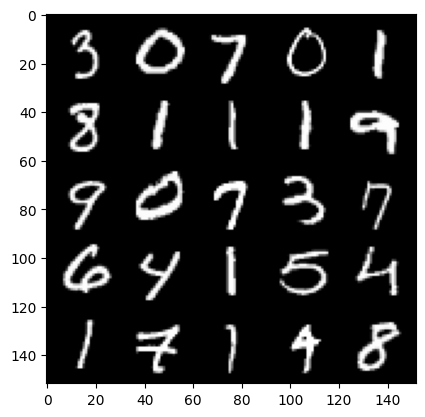

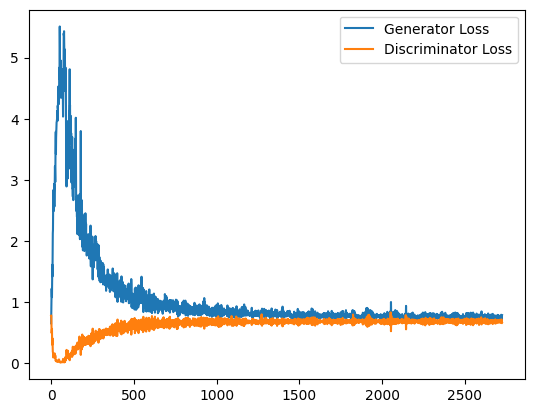

 27%|██▋       | 127/469 [00:10<00:26, 12.86it/s]

Epoch 117, step 55000: Generator loss: 0.7533400728702545, discriminator loss: 0.6830461809635162


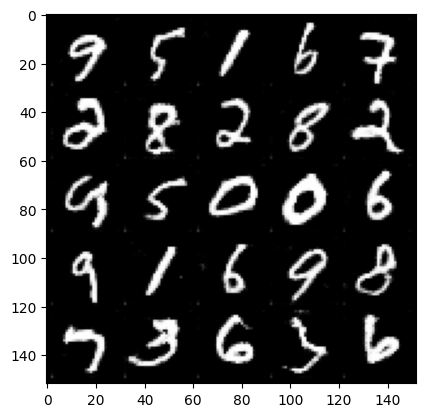

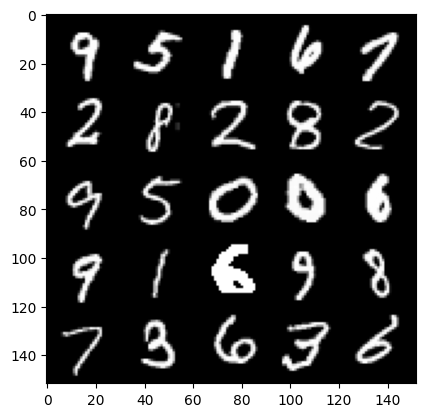

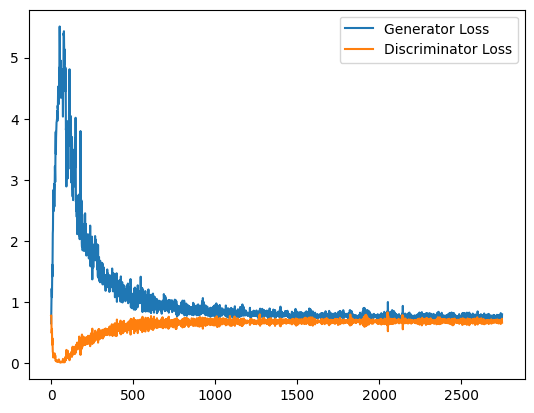

 33%|███▎      | 157/469 [00:13<00:29, 10.75it/s]

Epoch 118, step 55500: Generator loss: 0.7661777201890946, discriminator loss: 0.6808241472244263


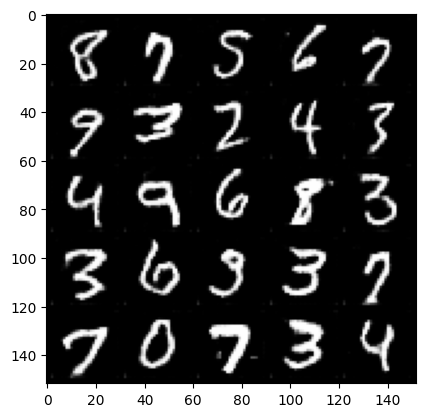

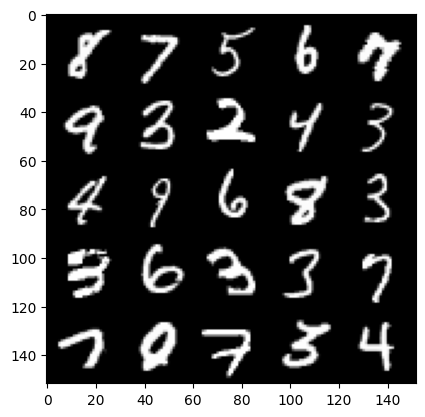

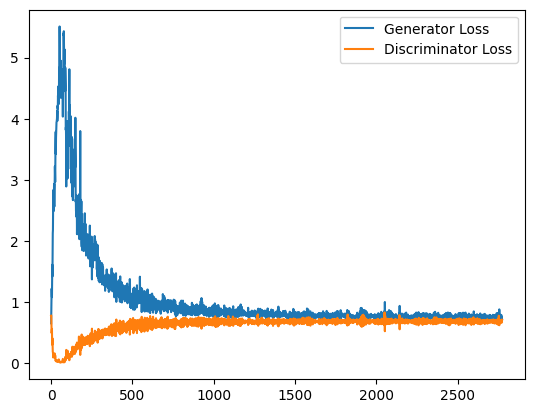

 40%|████      | 188/469 [00:16<00:27, 10.31it/s]

Epoch 119, step 56000: Generator loss: 0.7529306662082672, discriminator loss: 0.6805175838470459


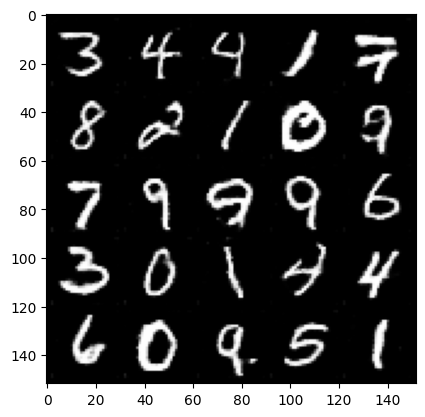

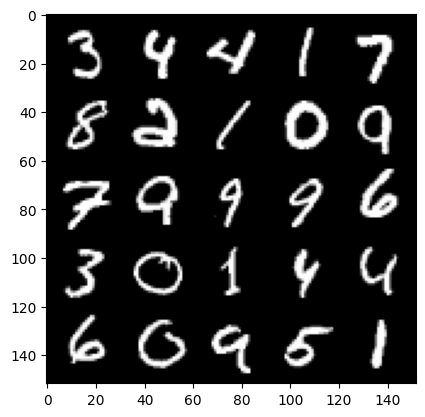

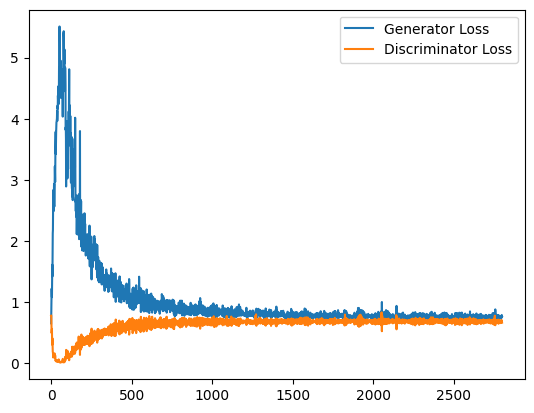

 47%|████▋     | 220/469 [00:18<00:20, 12.37it/s]

Epoch 120, step 56500: Generator loss: 0.7539917857646942, discriminator loss: 0.6796599311828613


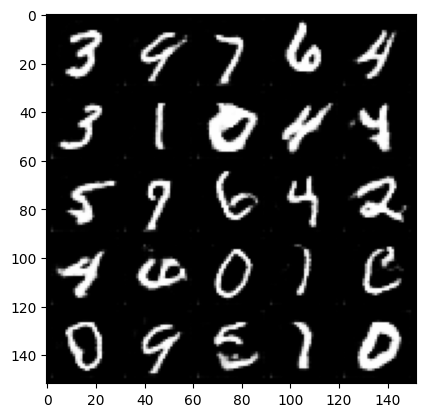

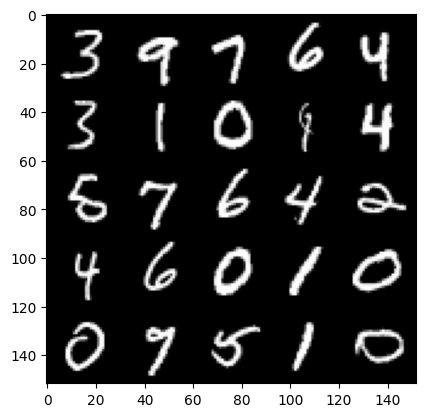

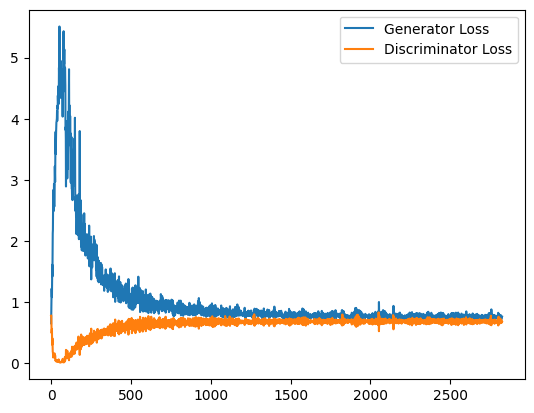

 54%|█████▎    | 251/469 [00:22<00:18, 11.97it/s]

Epoch 121, step 57000: Generator loss: 0.7515746268033981, discriminator loss: 0.6822308044433594


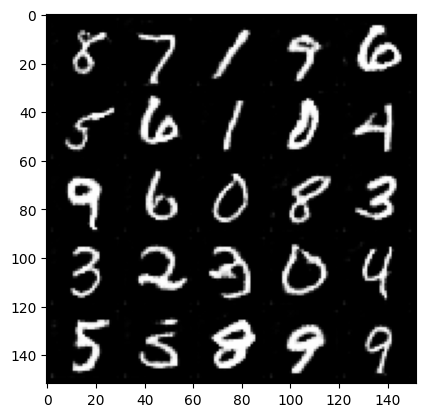

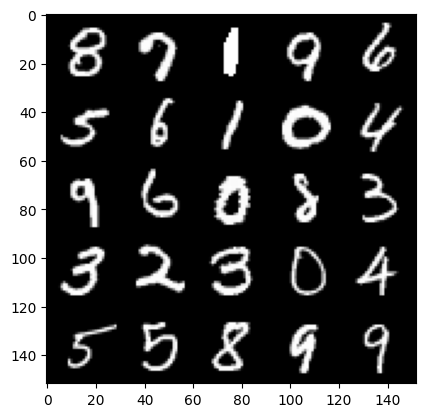

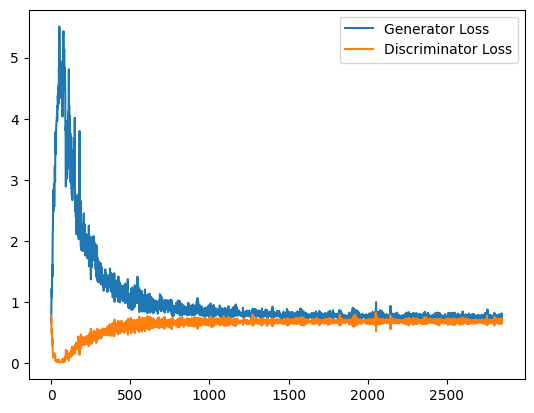

 60%|██████    | 282/469 [00:23<00:16, 11.30it/s]

Epoch 122, step 57500: Generator loss: 0.7556260499954224, discriminator loss: 0.6784473375082016


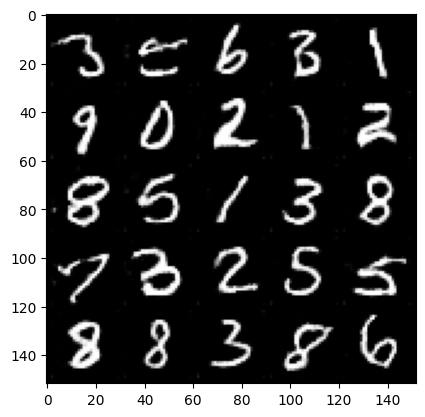

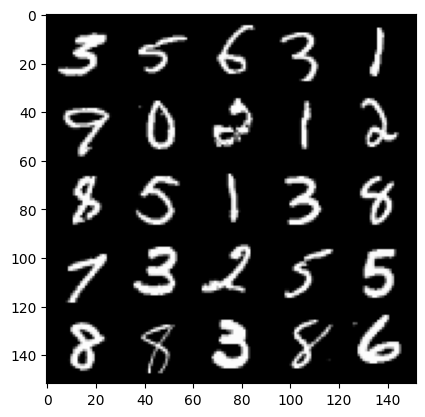

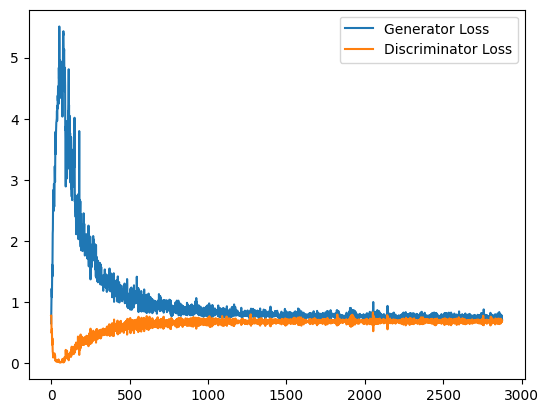

 67%|██████▋   | 313/469 [00:27<00:14, 10.50it/s]

Epoch 123, step 58000: Generator loss: 0.7503262941837311, discriminator loss: 0.6787361037731171


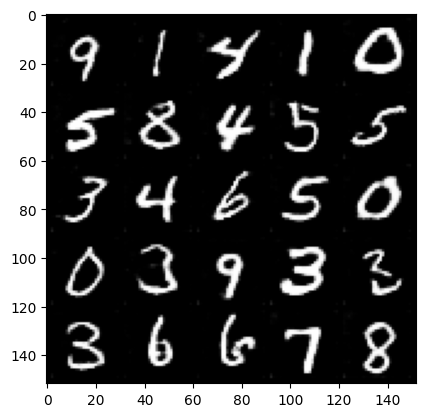

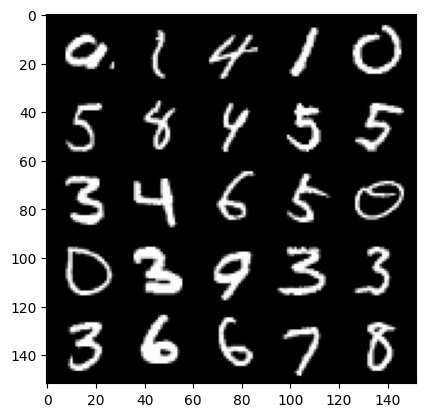

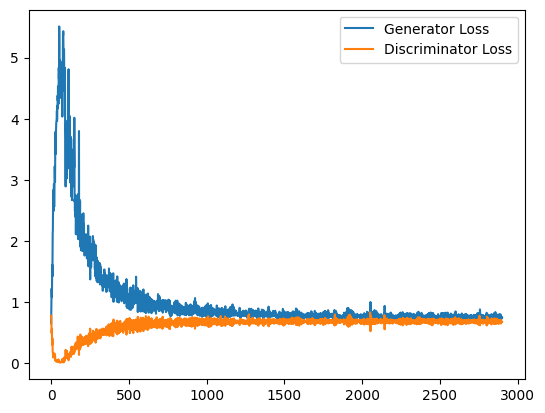

 73%|███████▎  | 344/469 [00:30<00:13,  9.57it/s]

Epoch 124, step 58500: Generator loss: 0.7481326079368591, discriminator loss: 0.6805927605628967


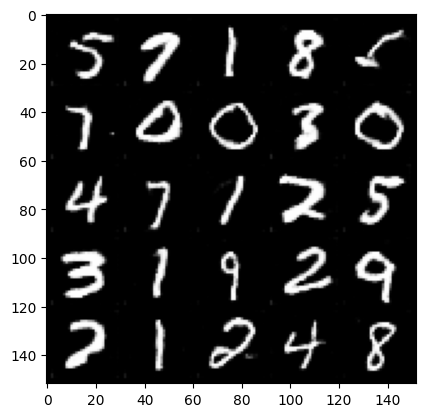

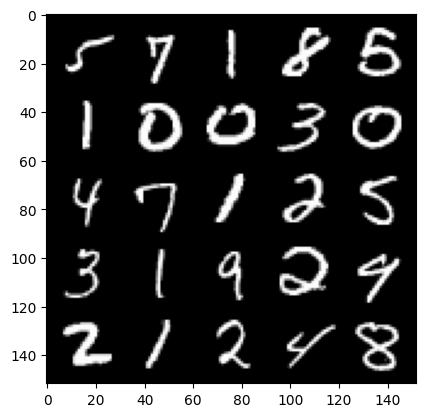

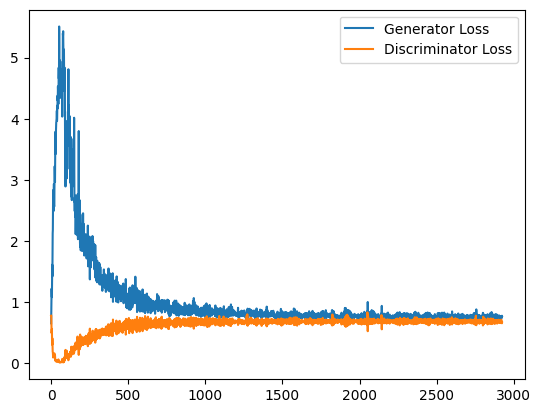

 80%|███████▉  | 375/469 [00:32<00:10,  9.16it/s]

Epoch 125, step 59000: Generator loss: 0.7518189891576766, discriminator loss: 0.6818830902576447


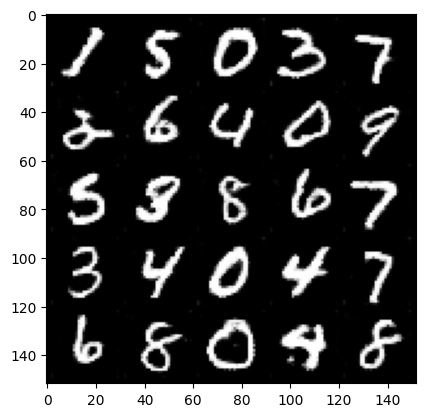

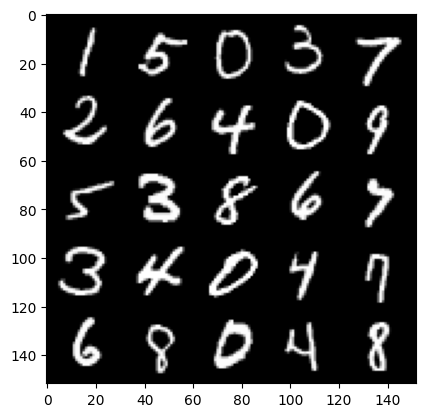

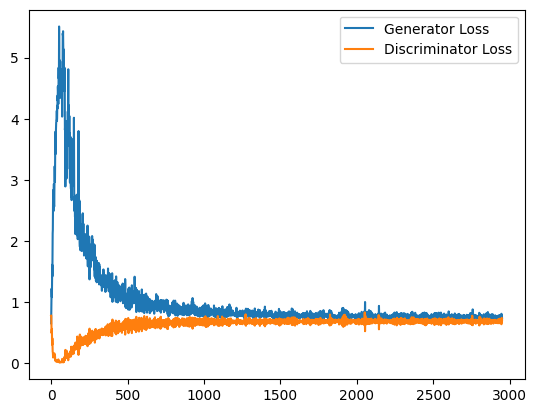

 87%|████████▋ | 406/469 [00:35<00:06, 10.22it/s]

Epoch 126, step 59500: Generator loss: 0.7581033489704132, discriminator loss: 0.6788571490049362


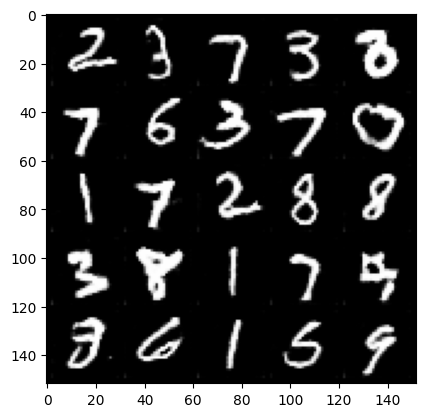

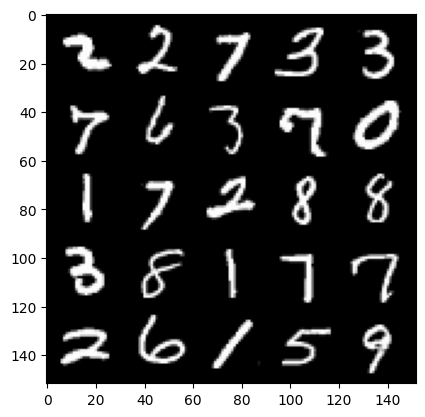

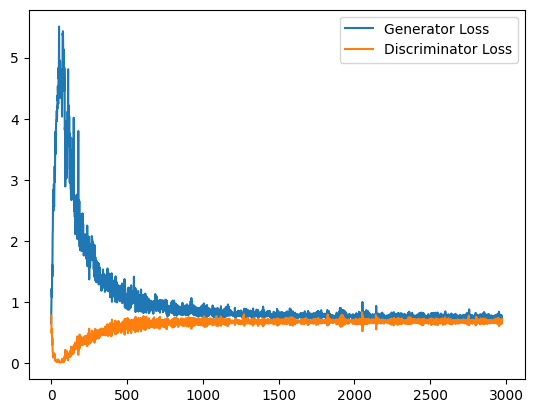

 93%|█████████▎| 437/469 [00:37<00:02, 11.94it/s]

Epoch 127, step 60000: Generator loss: 0.7515165596008301, discriminator loss: 0.6776002806425094


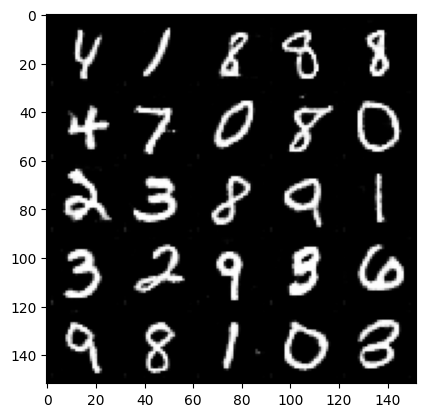

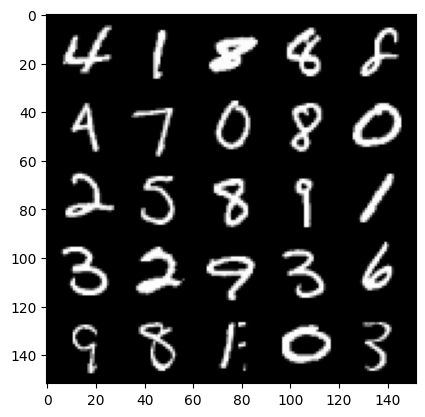

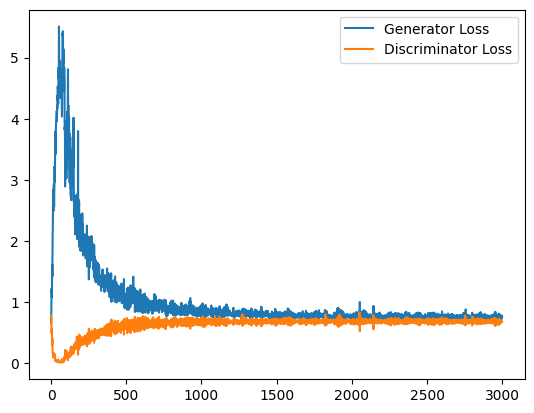

100%|█████████▉| 468/469 [00:40<00:00, 13.12it/s]

Epoch 128, step 60500: Generator loss: 0.7492346496582031, discriminator loss: 0.6825381577014923


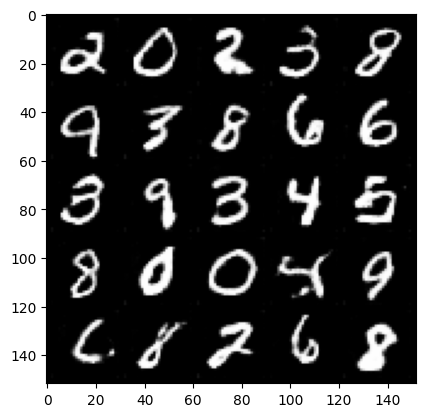

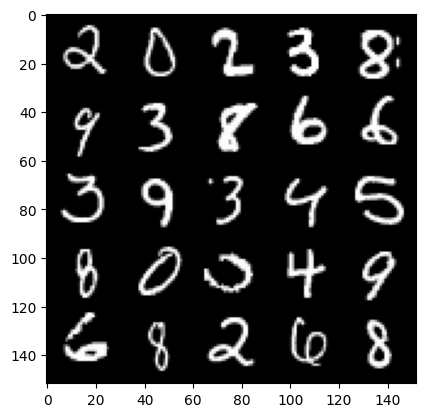

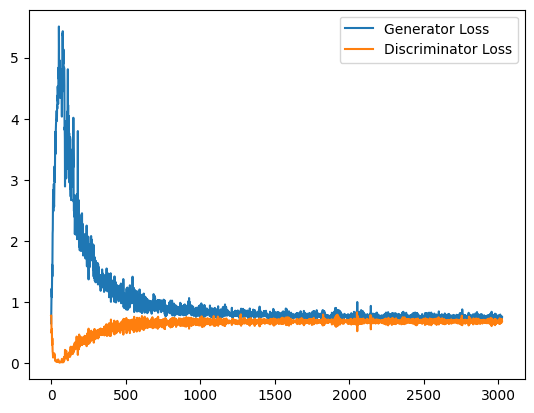

  6%|▌         | 29/469 [00:02<00:34, 12.84it/s]

Epoch 130, step 61000: Generator loss: 0.7573702350854874, discriminator loss: 0.6771698209047318


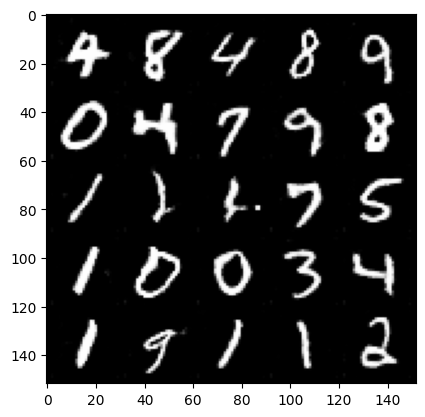

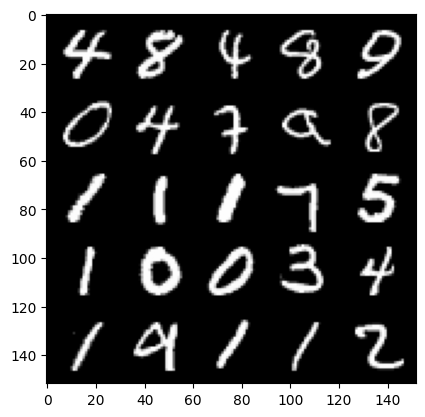

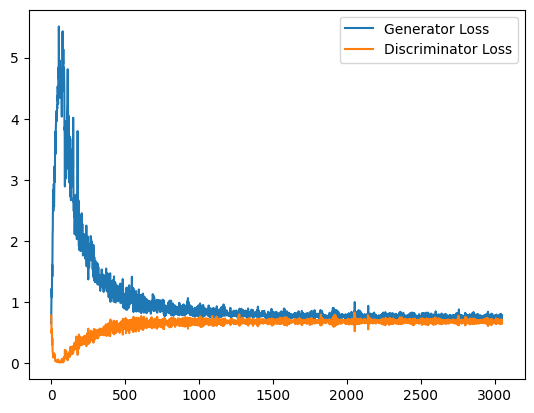

 13%|█▎        | 60/469 [00:05<00:34, 11.90it/s]

Epoch 131, step 61500: Generator loss: 0.7565025131702423, discriminator loss: 0.6789649497270585


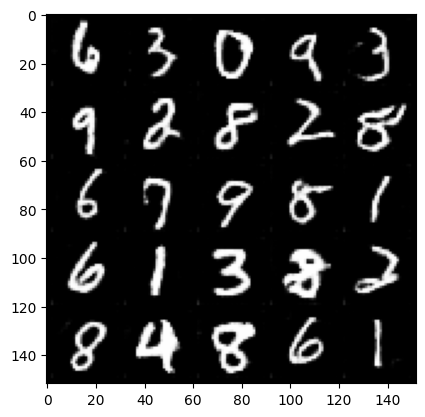

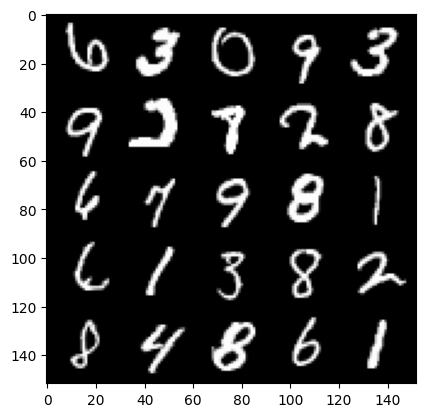

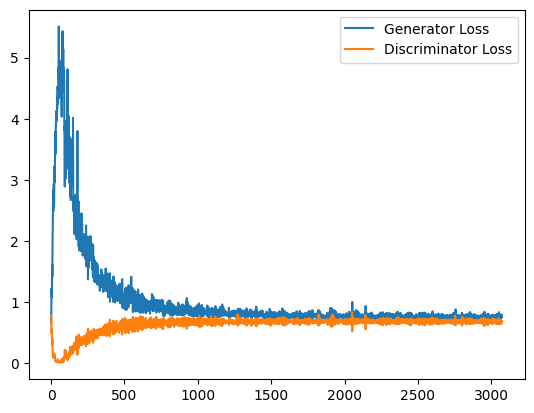

 20%|█▉        | 92/469 [00:07<00:29, 12.63it/s]

Epoch 132, step 62000: Generator loss: 0.7546319240331649, discriminator loss: 0.6786948636770248


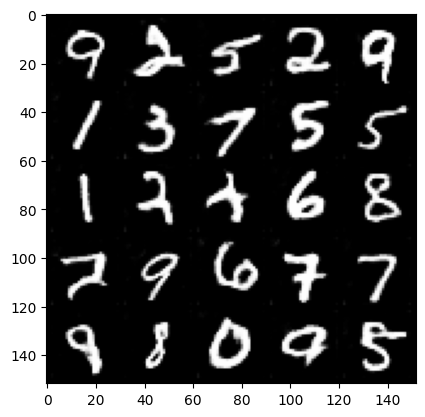

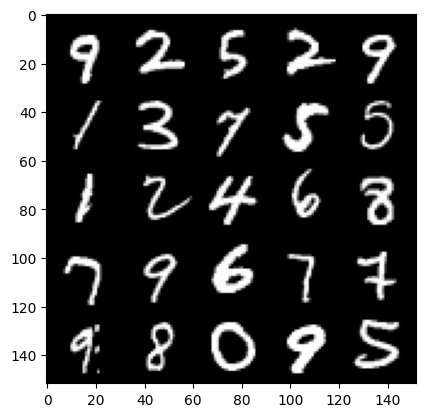

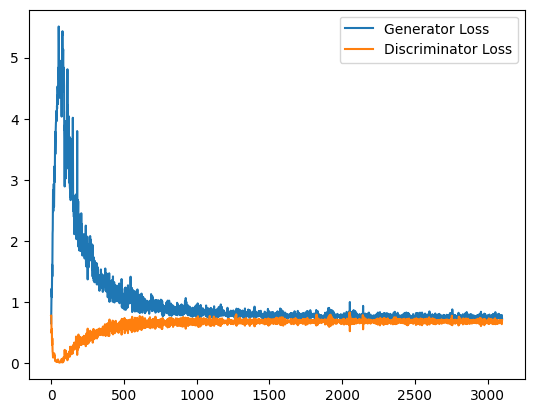

 26%|██▌       | 123/469 [00:10<00:36,  9.55it/s]

Epoch 133, step 62500: Generator loss: 0.7474405492544174, discriminator loss: 0.6780480153560638


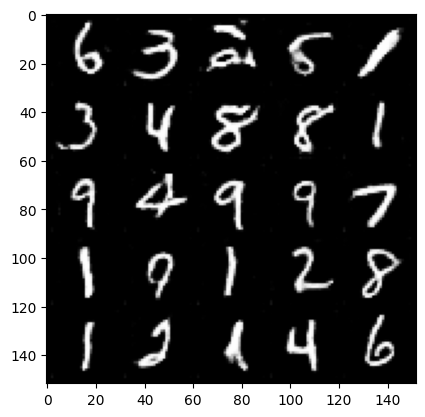

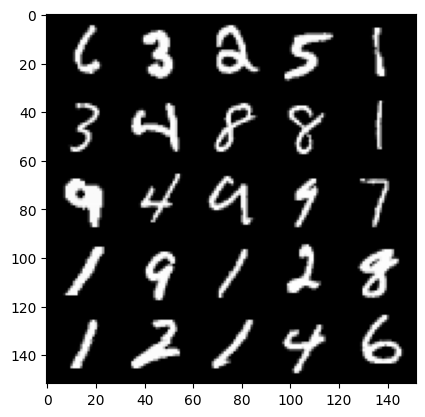

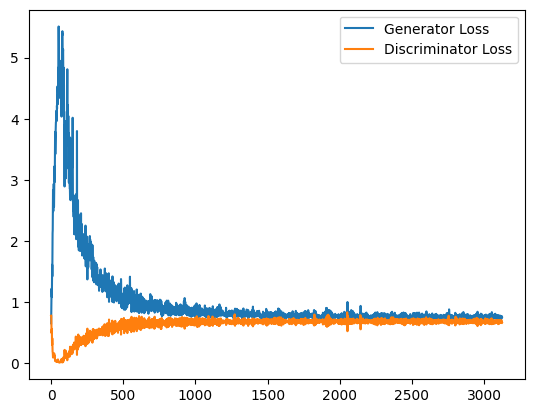

 33%|███▎      | 153/469 [00:13<00:27, 11.43it/s]

Epoch 134, step 63000: Generator loss: 0.7530734547376633, discriminator loss: 0.6794549379348754


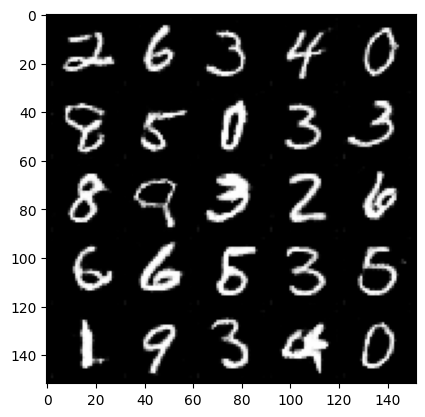

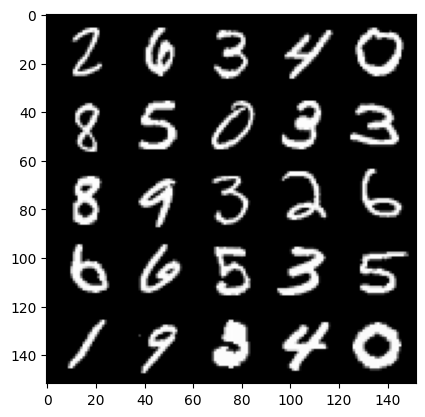

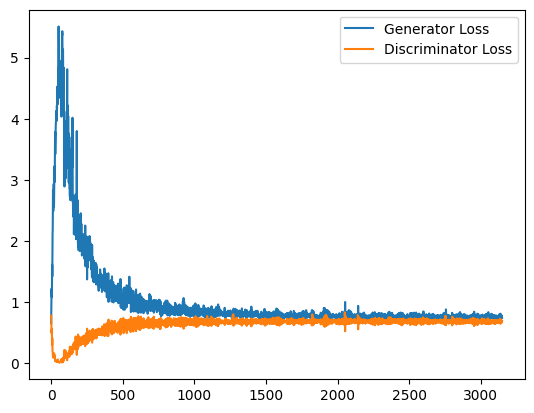

 39%|███▉      | 185/469 [00:15<00:23, 11.93it/s]

Epoch 135, step 63500: Generator loss: 0.7530407154560089, discriminator loss: 0.6778214253187179


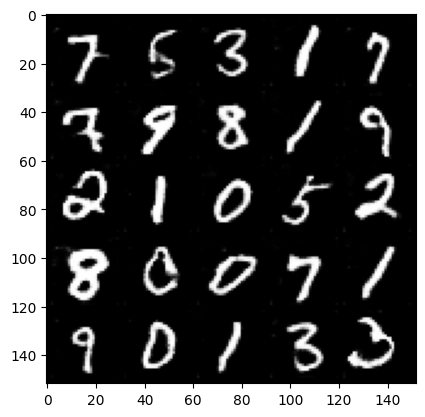

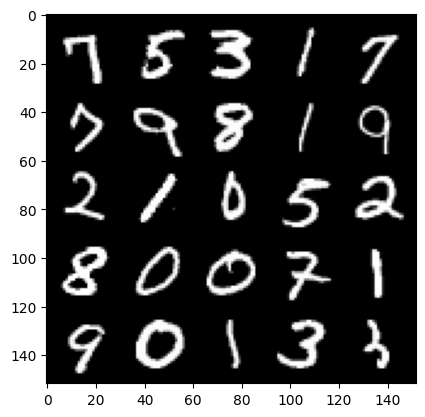

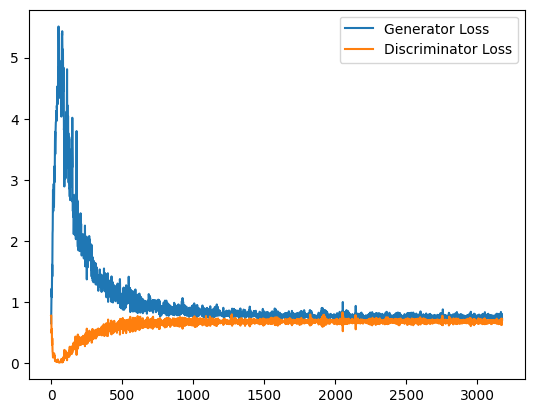

 46%|████▌     | 215/469 [00:18<00:23, 11.00it/s]

Epoch 136, step 64000: Generator loss: 0.7591947523355485, discriminator loss: 0.6760122305154801


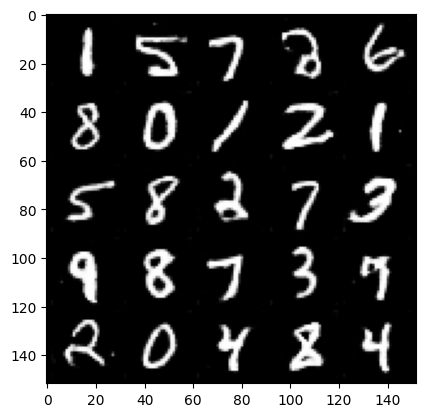

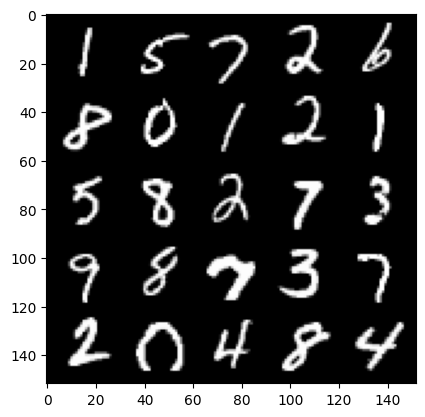

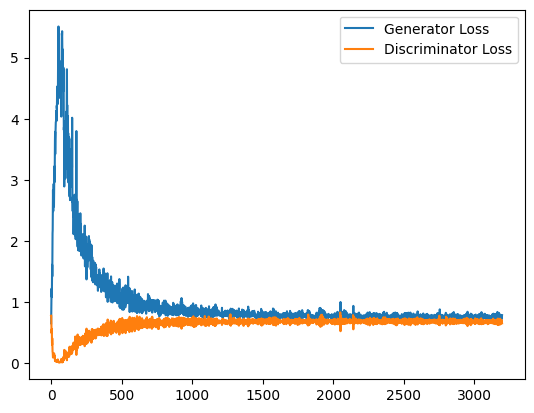

 52%|█████▏    | 246/469 [00:21<00:16, 13.23it/s]

Epoch 137, step 64500: Generator loss: 0.7588631422519684, discriminator loss: 0.6751722424030304


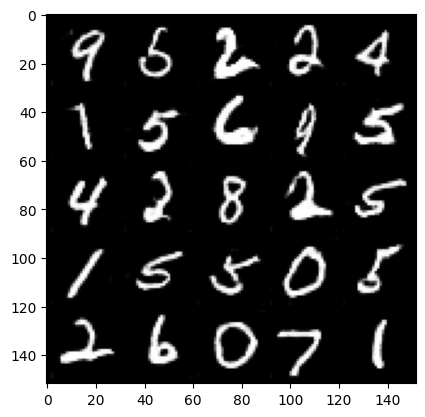

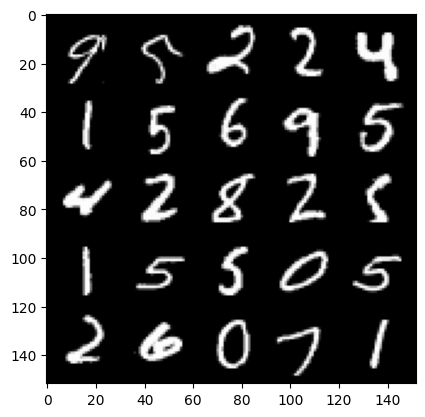

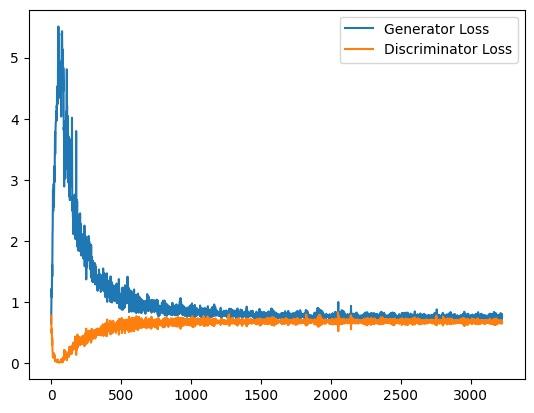

 59%|█████▉    | 278/469 [00:23<00:16, 11.69it/s]

Epoch 138, step 65000: Generator loss: 0.7665640972852706, discriminator loss: 0.6750469390153885


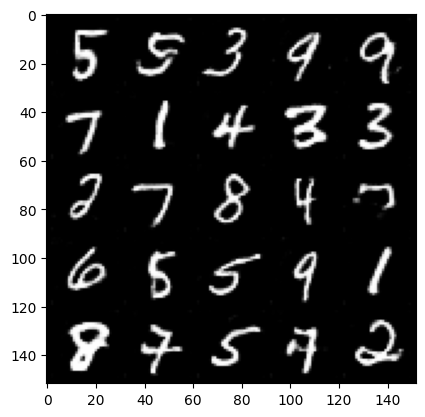

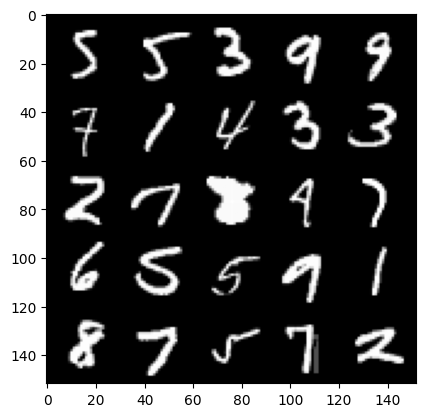

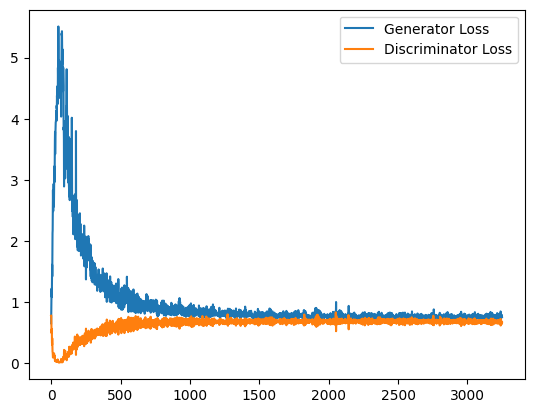

 66%|██████▌   | 309/469 [00:26<00:12, 12.95it/s]

Epoch 139, step 65500: Generator loss: 0.7641497445106507, discriminator loss: 0.6770724248886109


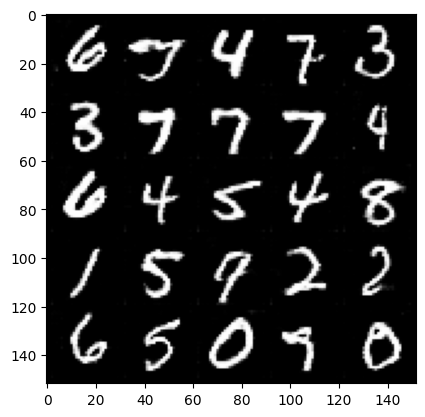

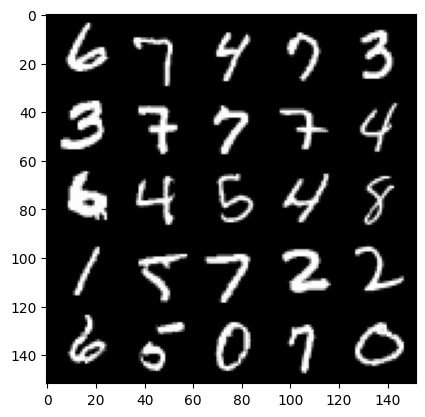

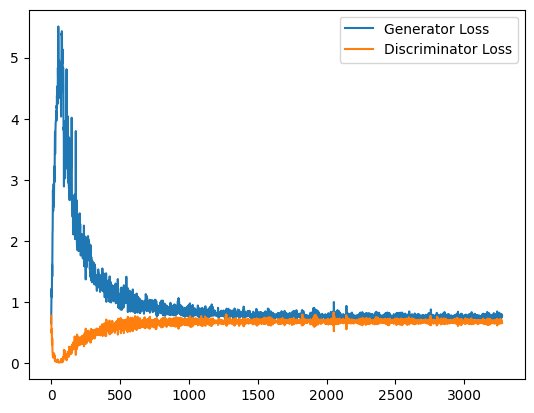

 72%|███████▏  | 340/469 [00:30<00:15,  8.21it/s]

Epoch 140, step 66000: Generator loss: 0.7681711602210999, discriminator loss: 0.6757559731006623


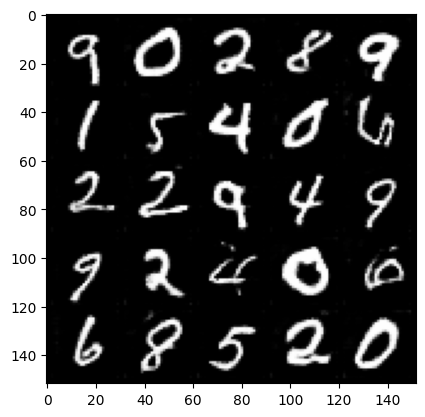

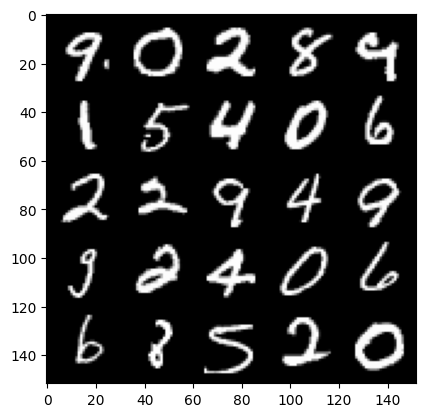

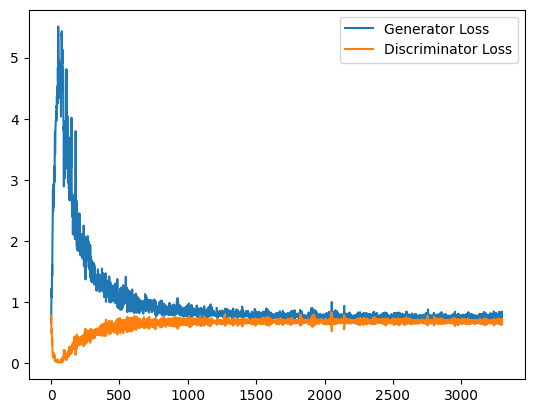

 79%|███████▉  | 370/469 [00:31<00:07, 13.58it/s]

Epoch 141, step 66500: Generator loss: 0.761029006242752, discriminator loss: 0.6716033309698105


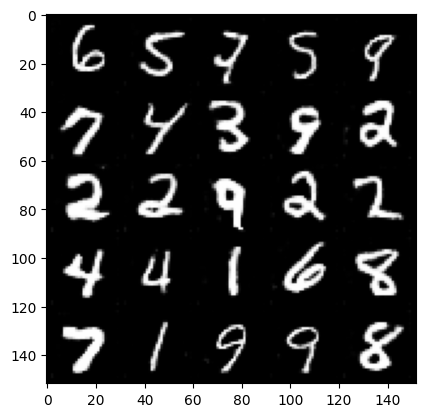

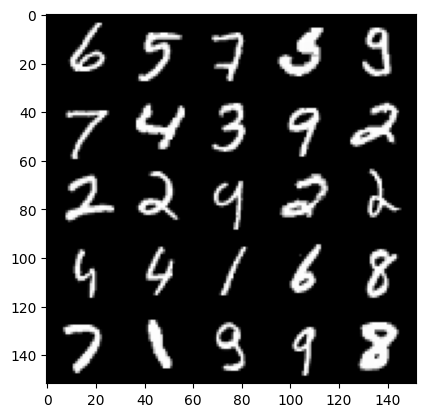

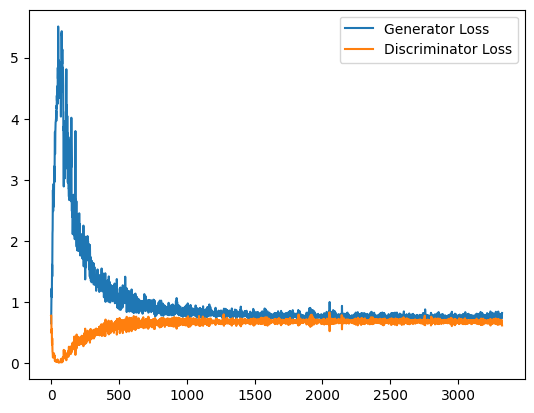

 42%|████▏     | 198/469 [00:06<00:09, 29.09it/s]


KeyboardInterrupt: 

In [50]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED CELL
cur_step = 0
generator_losses = []
discriminator_losses = []

#UNIT TEST NOTE: Initializations needed for grading
noise_and_labels = False
fake = False

fake_image_and_labels = False
real_image_and_labels = False
disc_fake_pred = False
disc_real_pred = False

for epoch in range(n_epochs):
    # Dataloader returns the batches and the labels
    for real, labels in tqdm(dataloader):
        cur_batch_size = len(real)
        # Flatten the batch of real images from the dataset
        real = real.to(device)

        one_hot_labels = get_one_hot_labels(labels.to(device), n_classes)
        image_one_hot_labels = one_hot_labels[:, :, None, None]
        image_one_hot_labels = image_one_hot_labels.repeat(1, 1, mnist_shape[1], mnist_shape[2])

        ### Update discriminator ###
        # Zero out the discriminator gradients
        disc_opt.zero_grad()
        # Get noise corresponding to the current batch_size 
        fake_noise = get_noise(cur_batch_size, z_dim, device=device)
        
        # Now you can get the images from the generator
        # Steps: 1) Combine the noise vectors and the one-hot labels for the generator
        #        2) Generate the conditioned fake images
       
        #### START CODE HERE ####
        noise_and_labels = combine_vectors(fake_noise,one_hot_labels)
        fake = gen(noise_and_labels)
        #### END CODE HERE ####
        
        # Make sure that enough images were generated
        assert len(fake) == len(real)
        # Check that correct tensors were combined
        assert tuple(noise_and_labels.shape) == (cur_batch_size, fake_noise.shape[1] + one_hot_labels.shape[1])
        # It comes from the correct generator
        assert tuple(fake.shape) == (len(real), 1, 28, 28)

        # Now you can get the predictions from the discriminator
        # Steps: 1) Create the input for the discriminator
        #           a) Combine the fake images with image_one_hot_labels, 
        #              remember to detach the generator (.detach()) so you do not backpropagate through it
        #           b) Combine the real images with image_one_hot_labels
        #        2) Get the discriminator's prediction on the fakes as disc_fake_pred
        #        3) Get the discriminator's prediction on the reals as disc_real_pred
        
        #### START CODE HERE ####
        fake_image_and_labels = combine_vectors(fake.detach(), image_one_hot_labels)
        real_image_and_labels = combine_vectors(real, image_one_hot_labels)
        disc_fake_pred = disc(fake_image_and_labels)
        disc_real_pred = disc(real_image_and_labels)
        #### END CODE HERE ####
                
        
        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        disc_loss = (disc_fake_loss + disc_real_loss) / 2
        disc_loss.backward(retain_graph=True)
        disc_opt.step() 

        # Keep track of the average discriminator loss
        discriminator_losses += [disc_loss.item()]

        ### Update generator ###
        # Zero out the generator gradients
        gen_opt.zero_grad()

        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        # This will error if you didn't concatenate your labels to your image correctly
        disc_fake_pred = disc(fake_image_and_labels)
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()
        gen_opt.step()

        # Keep track of the generator losses
        generator_losses += [gen_loss.item()]
        #

        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            disc_mean = sum(discriminator_losses[-display_step:]) / display_step
            print(f"Epoch {epoch}, step {cur_step}: Generator loss: {gen_mean}, discriminator loss: {disc_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            x_axis = sorted([i * step_bins for i in range(len(generator_losses) // step_bins)] * step_bins)
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss"
            )
            plt.legend()
            plt.show()
        elif cur_step == 0:
            print("Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!")
        cur_step += 1

In [55]:
gen = gen.eval()

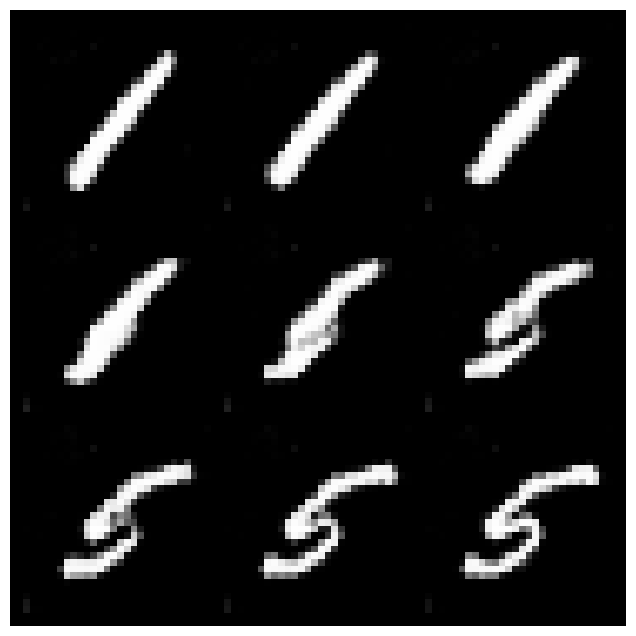

In [56]:
import math

### Change me! ###
n_interpolation = 9 # Choose the interpolation: how many intermediate images you want + 2 (for the start and end image)
interpolation_noise = get_noise(1, z_dim, device=device).repeat(n_interpolation, 1)

def interpolate_class(first_number, second_number):
    first_label = get_one_hot_labels(torch.Tensor([first_number]).long(), n_classes)
    second_label = get_one_hot_labels(torch.Tensor([second_number]).long(), n_classes)

    # Calculate the interpolation vector between the two labels
    percent_second_label = torch.linspace(0, 1, n_interpolation)[:, None]
    interpolation_labels = first_label * (1 - percent_second_label) + second_label * percent_second_label

    # Combine the noise and the labels
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_labels.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

### Change me! ###
start_plot_number = 1 # Choose the start digit
### Change me! ###
end_plot_number = 5 # Choose the end digit

plt.figure(figsize=(8, 8))
interpolate_class(start_plot_number, end_plot_number)
_ = plt.axis('off')

### Uncomment the following lines of code if you would like to visualize a set of pairwise class 
### interpolations for a collection of different numbers, all in a single grid of interpolations.
### You'll also see another visualization like this in the next code block!
# plot_numbers = [2, 3, 4, 5, 7]
# n_numbers = len(plot_numbers)
# plt.figure(figsize=(8, 8))
# for i, first_plot_number in enumerate(plot_numbers):
#     for j, second_plot_number in enumerate(plot_numbers):
#         plt.subplot(n_numbers, n_numbers, i * n_numbers + j + 1)
#         interpolate_class(first_plot_number, second_plot_number)
#         plt.axis('off')
# plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
# plt.show()
# plt.close()

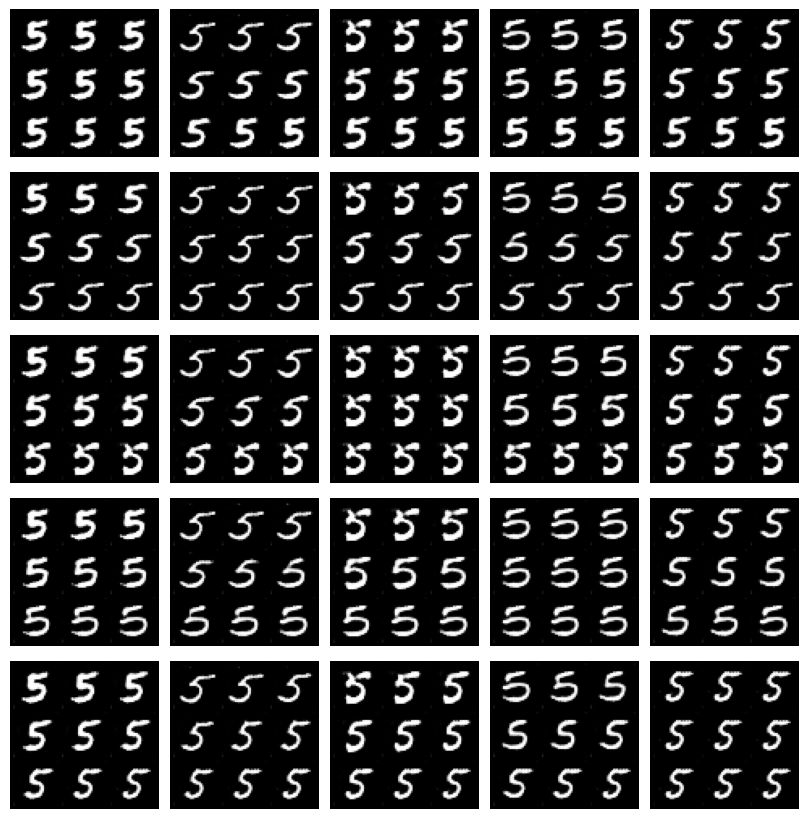

In [57]:
n_interpolation = 9 # How many intermediate images you want + 2 (for the start and end image)

# This time you're interpolating between the noise instead of the labels
interpolation_label = get_one_hot_labels(torch.Tensor([5]).long(), n_classes).repeat(n_interpolation, 1).float()

def interpolate_noise(first_noise, second_noise):
    # This time you're interpolating between the noise instead of the labels
    percent_first_noise = torch.linspace(0, 1, n_interpolation)[:, None].to(device)
    interpolation_noise = first_noise * percent_first_noise + second_noise * (1 - percent_first_noise)

    # Combine the noise and the labels again
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_label.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

# Generate noise vectors to interpolate between
### Change me! ###
n_noise = 5 # Choose the number of noise examples in the grid
plot_noises = [get_noise(1, z_dim, device=device) for i in range(n_noise)]
plt.figure(figsize=(8, 8))
for i, first_plot_noise in enumerate(plot_noises):
    for j, second_plot_noise in enumerate(plot_noises):
        plt.subplot(n_noise, n_noise, i * n_noise + j + 1)
        interpolate_noise(first_plot_noise, second_plot_noise)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()